In [1]:
# HiDDeN / complete-gan-mse-30-2.py
# Gourav Siddhad
# 03-May-2019

In [2]:
from __future__ import absolute_import, division, print_function

from numpy.random import seed
seed(1607)
from tensorflow import set_random_seed
set_random_seed(1607)

print('Importing Libraries', end='')

import warnings
warnings.filterwarnings('ignore')

import pandas as pd
import numpy as np

import random
import re
import os
import time
import csv
import math

import cv2
from sklearn.utils import shuffle
from sklearn.preprocessing import MultiLabelBinarizer

import tensorflow as tf
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'

import keras
import keras.backend as K
from keras.models import Model, Sequential, load_model
from keras.layers import Activation, Input, Dense, Conv2D, BatchNormalization, ReLU
from keras.layers import GlobalAveragePooling2D, Flatten, Reshape, Lambda, Add
from keras import optimizers
from keras.preprocessing import sequence
from keras.utils import to_categorical, plot_model
from keras.layers.merge import concatenate

import matplotlib.pyplot as plt
%matplotlib inline

print(' - Done')

Importing Libraries

Using TensorFlow backend.


 - Done


In [3]:
# Model Configuration
H, W, C, L = 128, 128, 3, 30
all_messages_train = []
all_messages_validate = []
all_messages_test = []

# Training train_options
batch_size = 12
n_epochs = 200

modelpath = 'models/'

train_folder = 'dataset128/original/train/'
validate_folder = 'dataset128/original/validate/'
test_folder = 'dataset128/original/test/'
    
print('Model    - ', modelpath)
print('Train    - ', train_folder)
print('Validate - ', validate_folder)
print('Test     - ', test_folder)

Model    -  models/
Train    -  dataset128/original/train/
Validate -  dataset128/original/validate/
Test     -  dataset128/original/test/


In [4]:
print('Reading Image List', end='')
train_list = os.listdir(train_folder)
validate_list = os.listdir(validate_folder)
test_list = os.listdir(test_folder)
print(' - Done')

print('Train    - ', len(train_list))
print('Train    - ', len(validate_list))
print('Test     - ', len(test_list))
print()

message_train = []
message_validate = []
message_test = []

print('Reading Messages', end='')
with open(modelpath + str(L) + '-train-msg.csv') as csv_file:
    csv_reader = csv.reader(csv_file)
    line_count = 0
    for row in csv_reader:
        if line_count%2 is 0:
            message_train.append(row)
        line_count += 1
csv_file.close()

with open(modelpath + str(L) + '-validate-msg.csv') as csv_file:
    csv_reader = csv.reader(csv_file)
    line_count = 0
    for row in csv_reader:
        if line_count%2 is 0:
            message_validate.append(row)
        line_count += 1
csv_file.close()

with open(modelpath + str(L) + '-test-msg.csv') as csv_file:
    csv_reader = csv.reader(csv_file)
    line_count = 0
    for row in csv_reader:
        if line_count%2 is 0:
            message_test.append(row)
        line_count += 1
csv_file.close()
print(' - Done')

print('Train Messages    - ', len(message_train))
print('Validate Messages - ', len(message_validate))
print('Test Messages     - ', len(message_test))

Reading Image List - Done
Train    -  7992
Train    -  1992
Test     -  996

Reading Messages - Done
Train Messages    -  7992
Validate Messages -  1992
Test Messages     -  996


In [5]:
def gen_msg_plates(message):
    msg = []
    for l in message:
        if l is '1':
            temp = np.ones((H, W), dtype='float32')
            msg.append(temp)
        elif l is '0':
            temp = np.zeros((H, W), dtype='float32')
            msg.append(temp)
    return np.array(msg)

def gen_msg(message):
    msg = []
    for l in message:
        if l is '1':
            msg.append(float(1))
        if l is '0':
            msg.append(float(0))
    return np.array(msg, dtype='float32')

In [6]:
lamI = 0.7
lamD = 1.0
lamG = 1e-3

adam = optimizers.Adam(lr=0.001, beta_1=0.9, beta_2=0.999)

Instructions for updating:
Colocations handled automatically by placer.


In [7]:
print('Encoder Network')
# Encoder
def build_encoder():
    input_e = Input(shape=(H, W, C))
    input_m = Input(shape=(L, H, W))
    layer_e1 = Sequential([Conv2D(filters=64, kernel_size=(3, 3), strides=(1, 1), padding='same'),
                    BatchNormalization(axis=-1, epsilon=1e-05, momentum=0.1, center=True, scale=True),
                    ReLU(max_value=None, negative_slope=0.0, threshold=0.0)])(input_e)
    layer_e2 = Sequential([Conv2D(filters=64, kernel_size=(3, 3), strides=(1, 1), padding='same'),
                    BatchNormalization(axis=-1, epsilon=1e-05, momentum=0.1, center=True, scale=True),
                    ReLU(max_value=None, negative_slope=0.0, threshold=0.0)])(layer_e1)
    layer_e3 = Sequential([Conv2D(filters=64, kernel_size=(3, 3), strides=(1, 1), padding='same'),
                    BatchNormalization(axis=-1, epsilon=1e-05, momentum=0.1, center=True, scale=True),
                    ReLU(max_value=None, negative_slope=0.0, threshold=0.0)])(layer_e2)
    layer_e4 = Sequential([Conv2D(filters=64, kernel_size=(3, 3), strides=(1, 1), padding='same'),
                    BatchNormalization(axis=-1, epsilon=1e-05, momentum=0.1, center=True, scale=True),
                    ReLU(max_value=None, negative_slope=0.0, threshold=0.0)])(layer_e3)

    # Reshape Message
    layer_r = Reshape((H, W, L))(input_m)

    # Integrate Message to Model
    merge = concatenate([layer_e4, input_e, layer_r])
    layer_e5 = Sequential([Conv2D(filters=64, kernel_size=(3, 3), strides=(1, 1), padding='same'),
                    BatchNormalization(axis=-1, epsilon=1e-05, momentum=0.1, center=True, scale=True),
                    ReLU(max_value=None, negative_slope=0.0, threshold=0.0)])(merge)
    output_e = Conv2D(filters=C, kernel_size=(1, 1), strides=(1, 1), padding='same')(layer_e5)
    
    model_e = Model(inputs=[input_e, input_m], outputs=output_e)
    model_e.compile(loss='mse', optimizer=adam, metrics=['accuracy'])
    return model_e

encoder = build_encoder()
encoder.summary()

print()
print('Metrics')
print(encoder.metrics_names)

Encoder Network
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 128, 128, 3)  0                                            
__________________________________________________________________________________________________
sequential_1 (Sequential)       (None, 128, 128, 64) 2048        input_1[0][0]                    
__________________________________________________________________________________________________
sequential_2 (Sequential)       (None, 128, 128, 64) 37184       sequential_1[1][0]               
__________________________________________________________________________________________________
sequential_3 (Sequential)       (None, 128, 128, 64) 37184       sequential_2[1][0]               
_____________________________________________________________________________________________

In [8]:
print('Decoder Network')
# Decoder
def build_decoder():
    input_d = Input(shape=(H, W, C))
    layer_d1 = Sequential([Conv2D(filters=64, kernel_size=(3, 3), strides=(1, 1), padding='same'),
                    BatchNormalization(axis=-1, epsilon=1e-05, momentum=0.1, center=True, scale=True),
                    ReLU(max_value=None, negative_slope=0.0, threshold=0.0)])(input_d)
    layer_d2 = Sequential([Conv2D(filters=64, kernel_size=(3, 3), strides=(1, 1), padding='same'),
                    BatchNormalization(axis=-1, epsilon=1e-05, momentum=0.1, center=True, scale=True),
                    ReLU(max_value=None, negative_slope=0.0, threshold=0.0)])(layer_d1)
    layer_d3 = Sequential([Conv2D(filters=64, kernel_size=(3, 3), strides=(1, 1), padding='same'),
                    BatchNormalization(axis=-1, epsilon=1e-05, momentum=0.1, center=True, scale=True),
                    ReLU(max_value=None, negative_slope=0.0, threshold=0.0)])(layer_d2)
    layer_d4 = Sequential([Conv2D(filters=64, kernel_size=(3, 3), strides=(1, 1), padding='same'),
                    BatchNormalization(axis=-1, epsilon=1e-05, momentum=0.1, center=True, scale=True),
                    ReLU(max_value=None, negative_slope=0.0, threshold=0.0)])(layer_d3)
    layer_d5 = Sequential([Conv2D(filters=64, kernel_size=(3, 3), strides=(1, 1), padding='same'),
                    BatchNormalization(axis=-1, epsilon=1e-05, momentum=0.1, center=True, scale=True),
                    ReLU(max_value=None, negative_slope=0.0, threshold=0.0)])(layer_d4)
    layer_d6 = Sequential([Conv2D(filters=64, kernel_size=(3, 3), strides=(1, 1), padding='same'),
                    BatchNormalization(axis=-1, epsilon=1e-05, momentum=0.1, center=True, scale=True),
                    ReLU(max_value=None, negative_slope=0.0, threshold=0.0)])(layer_d5)
    layer_d7 = Sequential([Conv2D(filters=64, kernel_size=(3, 3), strides=(1, 1), padding='same'),
                    BatchNormalization(axis=-1, epsilon=1e-05, momentum=0.1, center=True, scale=True),
                    ReLU(max_value=None, negative_slope=0.0, threshold=0.0)])(layer_d6)
    layer_d8 = Sequential([Conv2D(filters=L, kernel_size=(3, 3), strides=(1, 1), padding='same'),
                    BatchNormalization(axis=-1, epsilon=1e-05, momentum=0.1, center=True, scale=True),
                    ReLU(max_value=None, negative_slope=0.0, threshold=0.0)])(layer_d7)
    layer_d9 = GlobalAveragePooling2D(data_format=None)(layer_d8)
    output_d = Activation('linear')(layer_d9)
    
    model_d = Model(inputs=input_d, outputs=output_d)
    model_d.compile(loss='mse', optimizer=adam, metrics=['binary_accuracy'])
    return model_d

decoder = build_decoder()
decoder.summary()

print()
print('Metrics')
print(decoder.metrics_names)

Decoder Network
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         (None, 128, 128, 3)       0         
_________________________________________________________________
sequential_6 (Sequential)    (None, 128, 128, 64)      2048      
_________________________________________________________________
sequential_7 (Sequential)    (None, 128, 128, 64)      37184     
_________________________________________________________________
sequential_8 (Sequential)    (None, 128, 128, 64)      37184     
_________________________________________________________________
sequential_9 (Sequential)    (None, 128, 128, 64)      37184     
_________________________________________________________________
sequential_10 (Sequential)   (None, 128, 128, 64)      37184     
_________________________________________________________________
sequential_11 (Sequential)   (None, 128, 128, 64)      37184

In [9]:
print('Adversary Network')
# Adversary
def build_adversary():
    input_a = Input(shape=(H, W, C))
    layer_a1 = Sequential([Conv2D(filters=64, kernel_size=(3, 3), strides=(1, 1), padding='same'),
                    BatchNormalization(axis=-1, epsilon=1e-05, momentum=0.1, center=True, scale=True),
                    ReLU(max_value=None, negative_slope=0.0, threshold=0.0)])(input_a)
    layer_a2 = Sequential([Conv2D(filters=64, kernel_size=(3, 3), strides=(1, 1), padding='same'),
                    BatchNormalization(axis=-1, epsilon=1e-05, momentum=0.1, center=True, scale=True),
                    ReLU(max_value=None, negative_slope=0.0, threshold=0.0)])(layer_a1)
    layer_a3 = Sequential([Conv2D(filters=64, kernel_size=(3, 3), strides=(1, 1), padding='same'),
                    BatchNormalization(axis=-1, epsilon=1e-05, momentum=0.1, center=True, scale=True),
                    ReLU(max_value=None, negative_slope=0.0, threshold=0.0)])(layer_a2)
    layer_a4 = Sequential([Conv2D(filters=64, kernel_size=(3, 3), strides=(1, 1), padding='same'),
                    BatchNormalization(axis=-1, epsilon=1e-05, momentum=0.1, center=True, scale=True),
                    ReLU(max_value=None, negative_slope=0.0, threshold=0.0)])(layer_a3)
    layer_a5 = Sequential([Conv2D(filters=64, kernel_size=(3, 3), strides=(1, 1), padding='same'),
                    BatchNormalization(axis=-1, epsilon=1e-05, momentum=0.1, center=True, scale=True),
                    ReLU(max_value=None, negative_slope=0.0, threshold=0.0)])(layer_a4)
    layer_a6 =  GlobalAveragePooling2D(data_format=None)(layer_a5)
    output_a = Dense(1, activation='linear', name='Adv')(layer_a6)

    model_a = Model(inputs=input_a, outputs=output_a)
    model_a.compile(loss='binary_crossentropy', optimizer=adam, metrics=['accuracy'])
    
    return model_a

adversary = build_adversary()
adversary.summary()

print()
print('Metrics')
print(adversary.metrics_names)

Adversary Network
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         (None, 128, 128, 3)       0         
_________________________________________________________________
sequential_14 (Sequential)   (None, 128, 128, 64)      2048      
_________________________________________________________________
sequential_15 (Sequential)   (None, 128, 128, 64)      37184     
_________________________________________________________________
sequential_16 (Sequential)   (None, 128, 128, 64)      37184     
_________________________________________________________________
sequential_17 (Sequential)   (None, 128, 128, 64)      37184     
_________________________________________________________________
sequential_18 (Sequential)   (None, 128, 128, 64)      37184     
_________________________________________________________________
global_average_pooling2d_2 ( (None, 64)                0  

In [10]:
print('Combined Model')
# Combined
def build_combined(encoder, decoder, adversary):
    adversary.trainable = False
    
    c_iinput = Input(shape=(H, W, C))
    c_minput = Input(shape=(L, H, W))
    
    c_eout = encoder([c_iinput, c_minput])
    c_dout = decoder(c_eout)
    c_aout = adversary(c_eout)
    
    combined = Model(inputs=[c_iinput, c_minput], outputs=[c_eout, c_dout, c_aout])
    combined.compile(loss=['mse', 'mse', 'binary_crossentropy'], loss_weights=[lamI, lamD, lamG],
                     optimizer=adam, metrics=['accuracy', 'binary_accuracy'])
    return combined

combined = build_combined(encoder, decoder, adversary)
combined.summary()

print()
print('Metrics')
print(combined.metrics_names)

Combined Model
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_5 (InputLayer)            (None, 128, 128, 3)  0                                            
__________________________________________________________________________________________________
input_6 (InputLayer)            (None, 30, 128, 128) 0                                            
__________________________________________________________________________________________________
model_1 (Model)                 (None, 128, 128, 3)  169987      input_5[0][0]                    
                                                                 input_6[0][0]                    
__________________________________________________________________________________________________
model_2 (Model)                 (None, 30)           242582      model_1[1][0]                

In [11]:
def DataGenerator(file_list, folder_path, messages, index, batch_size=12):
    indexes = np.arange(len(file_list))
    
    index = indexes[int(index*batch_size) : int((index+1)*batch_size)]
    file_list_temp = [file_list[k] for k in index]
    message_temp = [messages[k] for k in index]

    images = []
    batch_msg = []
    dec_msg = []

    for i, ID in enumerate(file_list_temp):
        img = cv2.imread(folder_path + ID, -1)
        img = img.reshape([H, W, C])
        images.append((np.array(img, dtype='float32')-127.5)/127.5)
        
        msg = gen_msg_plates(message_temp[i])
        msg2 = gen_msg(message_temp[i])
        batch_msg.append(msg)
        dec_msg.append(msg2)

    return np.array(images), np.array(batch_msg), np.array(dec_msg)

In [12]:
# To remove the tf warning ;)
a = tf.to_int32(tf.Variable(0))

Instructions for updating:
Use tf.cast instead.


In [13]:
def calc_metric(loss, acc, vloss, vacc, advla, adv_r, adv_f, history, vhistory):
    avgl_e, avgl_d, avgl_a = [], [], []
    avga_e, avga_d, avga_a = [], [], []
    avgl = []
    vavgl_e, vavgl_d, vavgl_a = [], [], []
    vavga_e, vavga_d, vavga_a = [], [], []
    vavgl = []
    
    avgal_a, avgal_l = [], []
    for i in range(len(adv_r)):
        avgal_l.append(adv_r[i][0])
        avgal_a.append(adv_r[i][1])
        avgal_l.append(adv_f[i][0])
        avgal_a.append(adv_f[i][1])
        
    advla[0].append(np.mean(avgal_l))
    advla[1].append(np.mean(avgal_a))
    
    for hist in vhistory:
        vavgl.append(hist[0])
        vavgl_e.append(hist[1])
        vavgl_d.append(hist[2])
        vavgl_a.append(hist[3])
        vavga_e.append(hist[4])
        vavga_d.append(hist[7])
        vavga_a.append(hist[8])
        
    for hist in history:
        avgl.append(hist[0])
        avgl_e.append(hist[1])
        avgl_d.append(hist[2])
        avgl_a.append(hist[3])
        avga_e.append(hist[4])
        avga_d.append(hist[7])
        avga_a.append(hist[8])

    loss[0].append(np.mean(avgl))
    loss[1].append(np.mean(avgl_e))
    loss[2].append(np.mean(avgl_d))
    loss[3].append(np.mean(avgl_a))
    acc[0].append(np.mean(avga_e))
    acc[1].append(np.mean(avga_d))
    acc[2].append(np.mean(avga_a))
    
    vloss[0].append(np.mean(vavgl))
    vloss[1].append(np.mean(vavgl_e))
    vloss[2].append(np.mean(vavgl_d))
    vloss[3].append(np.mean(vavgl_a))
    vacc[0].append(np.mean(vavga_e))
    vacc[1].append(np.mean(vavga_d))
    vacc[2].append(np.mean(vavga_a))
    
    return loss, acc, vloss, vacc, advla

def print_metric(loss, acc, vloss, vacc, advla, epoch, ttime, vtime):
    print()
    print('Training   - ')
    print('Train     | Loss  : {:10.7f}'.format(loss[0][epoch]), end='\t')
    print(' | Time     : {:10.6f} |'.format(ttime))
    print('Adversary | Loss  : {:10.7f}'.format(advla[0][epoch]), end='\t')
    print(' | Accuracy : {:10.7f} |'.format(advla[1][epoch]))
    print('Encoder   | Loss  : {:10.7f}'.format(loss[1][epoch]), end='\t')
    print(' | Accuracy : {:10.7f} |'.format(acc[0][epoch]))
    print('Decoder   | Loss  : {:10.7f}'.format(loss[2][epoch]), end='\t')
    print(' | Accuracy : {:10.7f} |'.format(acc[1][epoch]))
    print('Adversary | Loss  : {:10.7f}'.format(loss[3][epoch]), end='\t')
    print(' | Accuracy : {:10.7f} |'.format(acc[2][epoch]))
    print()
    print('Validation - ')
    print('Validate  | Loss  : {:10.7f}'.format(vloss[0][epoch]), end='\t')
    print(' | Time     : {:10.6f} |'.format(vtime))
    print('Encoder   | Loss  : {:10.7f}'.format(vloss[1][epoch]), end='\t')
    print(' | Accuracy : {:10.7f} |'.format(vacc[0][epoch]))
    print('Decoder   | Loss  : {:10.7f}'.format(vloss[2][epoch]), end='\t')
    print(' | Accuracy : {:10.7f} |'.format(vacc[1][epoch]))
    print('Adversary | Loss  : {:10.7f}'.format(vloss[3][epoch]), end='\t')
    print(' | Accuracy : {:10.7f} |'.format(vacc[2][epoch]))
    
def arr_img(image):
    # To print images between epochs correctly
    return ((image*127.5)+127.5).astype(np.uint8)

def psnr(img1, img2):
    mse = np.mean((img1-img2)**2)
    if mse == 0:
        return mse
    PIXEL_MAX = 255.0
    return 20 * math.log10(PIXEL_MAX / math.sqrt(mse))

In [14]:
tbatches = (len(train_list)//batch_size)
vbatches = (len(validate_list)//batch_size)

Training Complete Network

Epoch :  1 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2679376	 | Time     : 273.414647 |
Adversary | Loss  :  1.7779449	 | Accuracy :  0.4525150 |
Encoder   | Loss  :  0.0285917	 | Accuracy :  0.5801055 |
Decoder   | Loss  :  0.2470401	 | Accuracy :  0.5551343 |
Adversary | Loss  :  0.8833461	 | Accuracy :  0.4674674 |

Validation - 
Validate  | Loss  :  0.2457847	 | Time     :  20.233955 |
Encoder   | Loss  :  0.0112645	 | Accuracy :  0.5932980 |
Decoder   | Loss  :  0.2372523	 | Accuracy :  0.5905455 |
Adversary | Loss  :  0.6472341	 | Accuracy :  0.8037148 |


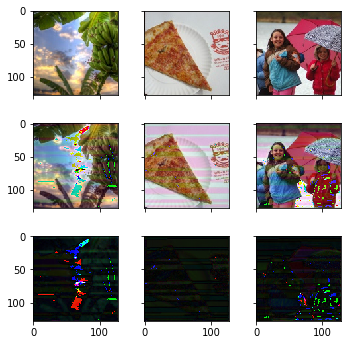


Epoch :  2 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2389630	 | Time     : 266.042237 |
Adversary | Loss  :  0.6708256	 | Accuracy :  0.5977227 |
Encoder   | Loss  :  0.0124981	 | Accuracy :  0.6383755 |
Decoder   | Loss  :  0.2294805	 | Accuracy :  0.6090382 |
Adversary | Loss  :  0.7338913	 | Accuracy :  0.3886386 |

Validation - 
Validate  | Loss  :  0.2251935	 | Time     :  20.156575 |
Encoder   | Loss  :  0.0063910	 | Accuracy :  0.6710522 |
Decoder   | Loss  :  0.2201781	 | Accuracy :  0.6313253 |
Adversary | Loss  :  0.5416865	 | Accuracy :  0.8795181 |


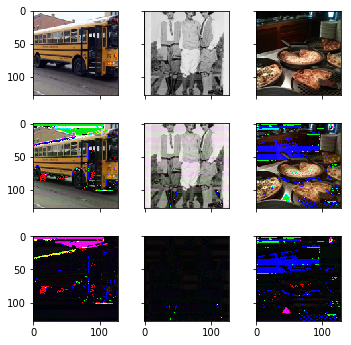


Epoch :  3 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2290725	 | Time     : 264.001034 |
Adversary | Loss  :  0.6238195	 | Accuracy :  0.7588839 |
Encoder   | Loss  :  0.0151301	 | Accuracy :  0.6324523 |
Decoder   | Loss  :  0.2173852	 | Accuracy :  0.6304471 |
Adversary | Loss  :  1.0961815	 | Accuracy :  0.1966967 |

Validation - 
Validate  | Loss  :  0.2300626	 | Time     :  19.946134 |
Encoder   | Loss  :  0.0243075	 | Accuracy :  0.5949012 |
Decoder   | Loss  :  0.2126395	 | Accuracy :  0.6361613 |
Adversary | Loss  :  0.4079648	 | Accuracy :  0.9779116 |


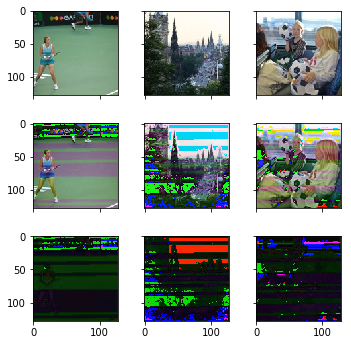


Epoch :  4 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2233705	 | Time     : 264.688295 |
Adversary | Loss  :  0.5625376	 | Accuracy :  0.7800926 |
Encoder   | Loss  :  0.0120703	 | Accuracy :  0.6704891 |
Decoder   | Loss  :  0.2135369	 | Accuracy :  0.6327745 |
Adversary | Loss  :  1.3843282	 | Accuracy :  0.1488989 |

Validation - 
Validate  | Loss  :  0.2198678	 | Time     :  20.030967 |
Encoder   | Loss  :  0.0057656	 | Accuracy :  0.7350898 |
Decoder   | Loss  :  0.2155113	 | Accuracy :  0.6321619 |
Adversary | Loss  :  0.3206205	 | Accuracy :  0.9764057 |


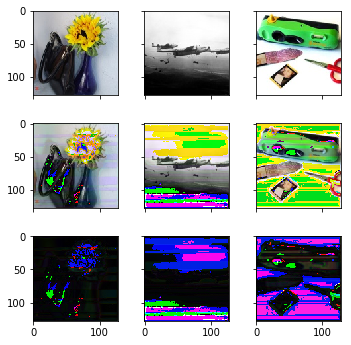


Epoch :  5 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2432722	 | Time     : 266.293901 |
Adversary | Loss  :  2.5555992	 | Accuracy :  0.6325075 |
Encoder   | Loss  :  0.0295592	 | Accuracy :  0.6177349 |
Decoder   | Loss  :  0.2182454	 | Accuracy :  0.6211587 |
Adversary | Loss  :  4.3353324	 | Accuracy :  0.2093343 |

Validation - 
Validate  | Loss  :  0.2218733	 | Time     :  20.078300 |
Encoder   | Loss  :  0.0112193	 | Accuracy :  0.6526894 |
Decoder   | Loss  :  0.2065916	 | Accuracy :  0.6485943 |
Adversary | Loss  :  7.4280829	 | Accuracy :  0.2866465 |


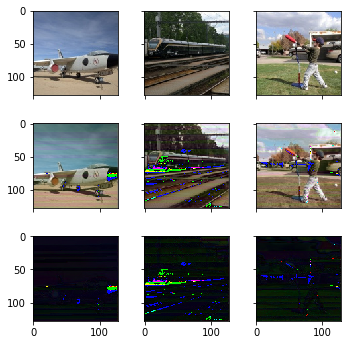


Epoch :  6 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2153302	 | Time     : 264.986846 |
Adversary | Loss  :  1.1062924	 | Accuracy :  0.4839840 |
Encoder   | Loss  :  0.0119350	 | Accuracy :  0.6490639 |
Decoder   | Loss  :  0.2063025	 | Accuracy :  0.6462421 |
Adversary | Loss  :  0.6732017	 | Accuracy :  0.5102603 |

Validation - 
Validate  | Loss  :  0.2309283	 | Time     :  20.335962 |
Encoder   | Loss  :  0.0369323	 | Accuracy :  0.6625396 |
Decoder   | Loss  :  0.2042651	 | Accuracy :  0.6486781 |
Adversary | Loss  :  0.8105522	 | Accuracy :  0.2419679 |


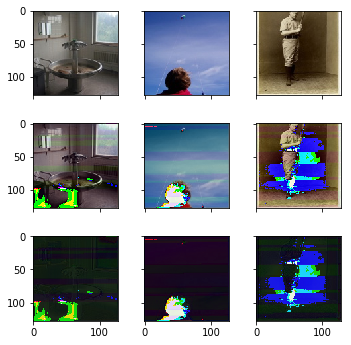


Epoch :  7 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2122000	 | Time     : 266.472603 |
Adversary | Loss  :  0.6915189	 | Accuracy :  0.5193318 |
Encoder   | Loss  :  0.0103536	 | Accuracy :  0.6635683 |
Decoder   | Loss  :  0.2042559	 | Accuracy :  0.6480522 |
Adversary | Loss  :  0.6965330	 | Accuracy :  0.4923674 |

Validation - 
Validate  | Loss  :  0.2058261	 | Time     :  19.859478 |
Encoder   | Loss  :  0.0048101	 | Accuracy :  0.6861713 |
Decoder   | Loss  :  0.2017456	 | Accuracy :  0.6509371 |
Adversary | Loss  :  0.7134197	 | Accuracy :  0.2479919 |


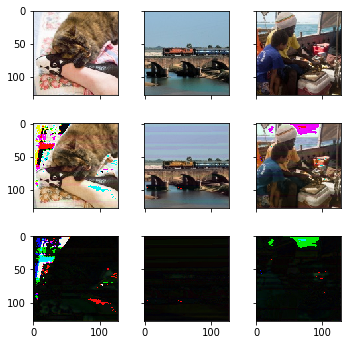


Epoch :  8 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2102505	 | Time     : 264.262162 |
Adversary | Loss  :  0.6611270	 | Accuracy :  0.6569695 |
Encoder   | Loss  :  0.0092450	 | Accuracy :  0.6729186 |
Decoder   | Loss  :  0.2030344	 | Accuracy :  0.6488488 |
Adversary | Loss  :  0.7445957	 | Accuracy :  0.3015516 |

Validation - 
Validate  | Loss  :  0.2147090	 | Time     :  19.995876 |
Encoder   | Loss  :  0.0093754	 | Accuracy :  0.6946559 |
Decoder   | Loss  :  0.2070328	 | Accuracy :  0.6435409 |
Adversary | Loss  :  1.1134440	 | Accuracy :  0.6270080 |


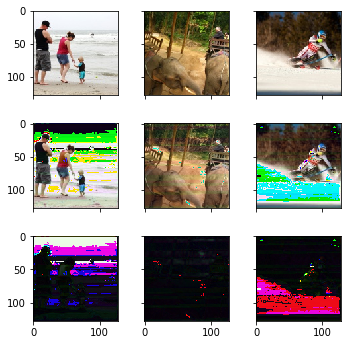


Epoch :  9 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2215504	 | Time     : 265.528839 |
Adversary | Loss  :  0.4156395	 | Accuracy :  0.8522272 |
Encoder   | Loss  :  0.0158144	 | Accuracy :  0.6430756 |
Decoder   | Loss  :  0.2067015	 | Accuracy :  0.6427177 |
Adversary | Loss  :  3.7788508	 | Accuracy :  0.0794545 |

Validation - 
Validate  | Loss  :  0.2196739	 | Time     :  20.577298 |
Encoder   | Loss  :  0.0189698	 | Accuracy :  0.6282696 |
Decoder   | Loss  :  0.2062246	 | Accuracy :  0.6403949 |
Adversary | Loss  :  0.1703616	 | Accuracy :  0.9969879 |


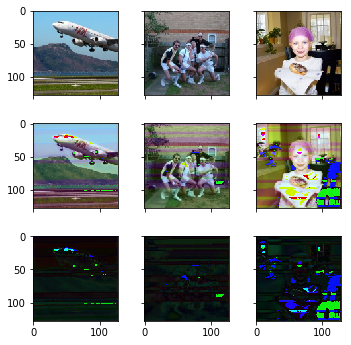


Epoch :  10 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2114695	 | Time     : 266.719237 |
Adversary | Loss  :  1.0327666	 | Accuracy :  0.5658784 |
Encoder   | Loss  :  0.0101615	 | Accuracy :  0.6798440 |
Decoder   | Loss  :  0.2027909	 | Accuracy :  0.6494453 |
Adversary | Loss  :  1.5654740	 | Accuracy :  0.4600851 |

Validation - 
Validate  | Loss  :  0.2045006	 | Time     :  20.007508 |
Encoder   | Loss  :  0.0047264	 | Accuracy :  0.7180254 |
Decoder   | Loss  :  0.2004734	 | Accuracy :  0.6554050 |
Adversary | Loss  :  0.7187440	 | Accuracy :  0.3644578 |


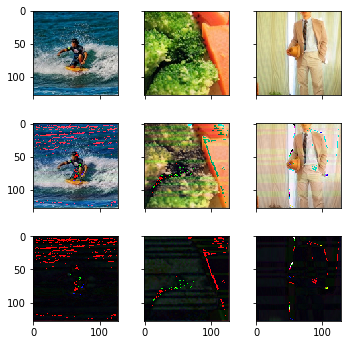


Epoch :  11 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2054859	 | Time     : 265.731735 |
Adversary | Loss  :  0.5579945	 | Accuracy :  0.7862862 |
Encoder   | Loss  :  0.0090506	 | Accuracy :  0.6918989 |
Decoder   | Loss  :  0.1982533	 | Accuracy :  0.6608817 |
Adversary | Loss  :  0.8971674	 | Accuracy :  0.1931932 |

Validation - 
Validate  | Loss  :  0.2006093	 | Time     :  20.247535 |
Encoder   | Loss  :  0.0044837	 | Accuracy :  0.6746206 |
Decoder   | Loss  :  0.1970463	 | Accuracy :  0.6618307 |
Adversary | Loss  :  0.4244241	 | Accuracy :  0.9442771 |


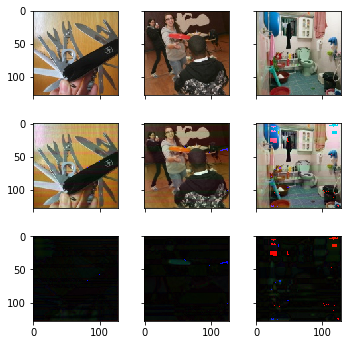


Epoch :  12 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2130265	 | Time     : 266.261457 |
Adversary | Loss  :  0.2903089	 | Accuracy :  0.9079078 |
Encoder   | Loss  :  0.0110614	 | Accuracy :  0.6699792 |
Decoder   | Loss  :  0.1994030	 | Accuracy :  0.6566191 |
Adversary | Loss  :  5.8805294	 | Accuracy :  0.0397898 |

Validation - 
Validate  | Loss  :  0.2075030	 | Time     :  20.127025 |
Encoder   | Loss  :  0.0153863	 | Accuracy :  0.6727614 |
Decoder   | Loss  :  0.1967202	 | Accuracy :  0.6593038 |
Adversary | Loss  :  0.0123518	 | Accuracy :  0.9984940 |


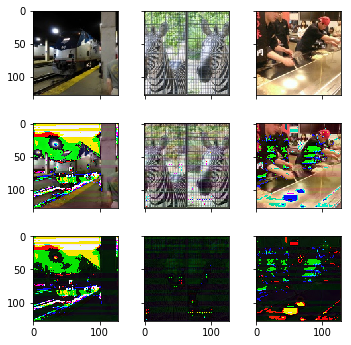


Epoch :  13 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2201582	 | Time     : 266.393191 |
Adversary | Loss  :  0.0199992	 | Accuracy :  0.9231107 |
Encoder   | Loss  :  0.0101976	 | Accuracy :  0.6799297 |
Decoder   | Loss  :  0.1977784	 | Accuracy :  0.6593344 |
Adversary | Loss  : 15.2415800	 | Accuracy :  0.0017518 |

Validation - 
Validate  | Loss  :  0.2006896	 | Time     :  20.180444 |
Encoder   | Loss  :  0.0087675	 | Accuracy :  0.7281416 |
Decoder   | Loss  :  0.1944979	 | Accuracy :  0.6648260 |
Adversary | Loss  :  0.0544243	 | Accuracy :  0.9959840 |


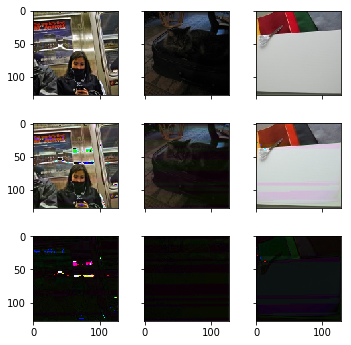


Epoch :  14 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2145525	 | Time     : 266.256626 |
Adversary | Loss  :  0.2761049	 | Accuracy :  0.8714339 |
Encoder   | Loss  :  0.0084502	 | Accuracy :  0.7027501 |
Decoder   | Loss  :  0.1962407	 | Accuracy :  0.6610527 |
Adversary | Loss  : 12.3966227	 | Accuracy :  0.0295295 |

Validation - 
Validate  | Loss  :  0.2051796	 | Time     :  20.351457 |
Encoder   | Loss  :  0.0089378	 | Accuracy :  0.7372546 |
Decoder   | Loss  :  0.1980862	 | Accuracy :  0.6595381 |
Adversary | Loss  :  0.8368822	 | Accuracy :  0.8027108 |


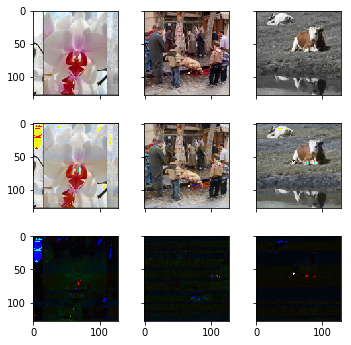


Epoch :  15 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2210498	 | Time     : 267.008325 |
Adversary | Loss  :  0.1165669	 | Accuracy :  0.8115616 |
Encoder   | Loss  :  0.0139876	 | Accuracy :  0.6581028 |
Decoder   | Loss  :  0.1988182	 | Accuracy :  0.6552511 |
Adversary | Loss  : 12.4403067	 | Accuracy :  0.0196446 |

Validation - 
Validate  | Loss  :  0.2015977	 | Time     :  20.319739 |
Encoder   | Loss  :  0.0057960	 | Accuracy :  0.6909992 |
Decoder   | Loss  :  0.1975400	 | Accuracy :  0.6556392 |
Adversary | Loss  :  0.0004122	 | Accuracy :  0.9969879 |


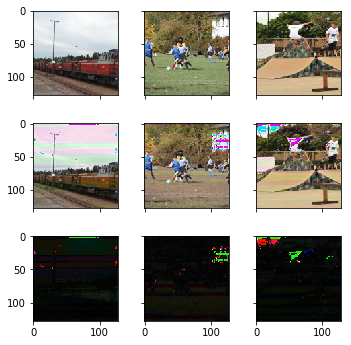


Epoch :  16 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2164900	 | Time     : 265.769346 |
Adversary | Loss  :  0.0015584	 | Accuracy :  0.6020395 |
Encoder   | Loss  :  0.0088953	 | Accuracy :  0.6741718 |
Decoder   | Loss  :  0.1944242	 | Accuracy :  0.6638514 |
Adversary | Loss  : 15.8390179	 | Accuracy :  0.0001251 |

Validation - 
Validate  | Loss  :  0.1976321	 | Time     :  20.256200 |
Encoder   | Loss  :  0.0057910	 | Accuracy :  0.6873139 |
Decoder   | Loss  :  0.1935697	 | Accuracy :  0.6646922 |
Adversary | Loss  :  0.0087669	 | Accuracy :  1.0000000 |


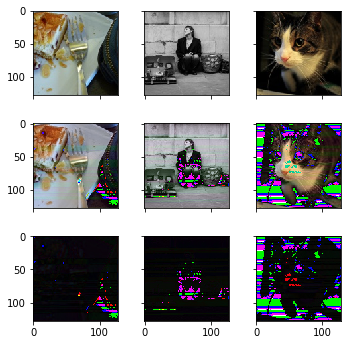


Epoch :  17 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2147472	 | Time     : 266.529842 |
Adversary | Loss  :  0.0006360	 | Accuracy :  0.4628378 |
Encoder   | Loss  :  0.0073340	 | Accuracy :  0.6871273 |
Decoder   | Loss  :  0.1937117	 | Accuracy :  0.6641099 |
Adversary | Loss  : 15.9015903	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1999805	 | Time     :  20.069610 |
Encoder   | Loss  :  0.0057226	 | Accuracy :  0.7020265 |
Decoder   | Loss  :  0.1959744	 | Accuracy :  0.6660810 |
Adversary | Loss  :  0.0002842	 | Accuracy :  0.8378515 |


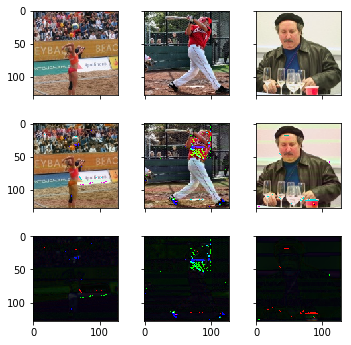


Epoch :  18 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2140915	 | Time     : 265.303092 |
Adversary | Loss  :  0.0001413	 | Accuracy :  0.3375250 |
Encoder   | Loss  :  0.0067002	 | Accuracy :  0.6940365 |
Decoder   | Loss  :  0.1934590	 | Accuracy :  0.6643852 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1955436	 | Time     :  19.855543 |
Encoder   | Loss  :  0.0031599	 | Accuracy :  0.7103810 |
Decoder   | Loss  :  0.1933317	 | Accuracy :  0.6662483 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.5727912 |


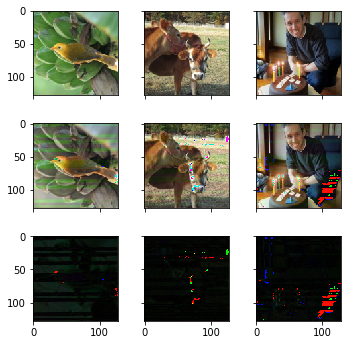


Epoch :  19 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2134027	 | Time     : 264.691849 |
Adversary | Loss  :  0.0009045	 | Accuracy :  0.3646772 |
Encoder   | Loss  :  0.0063271	 | Accuracy :  0.7041565 |
Decoder   | Loss  :  0.1930436	 | Accuracy :  0.6660786 |
Adversary | Loss  : 15.9300890	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1945161	 | Time     :  19.960785 |
Encoder   | Loss  :  0.0031285	 | Accuracy :  0.7296663 |
Decoder   | Loss  :  0.1923262	 | Accuracy :  0.6659137 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.1335341 |


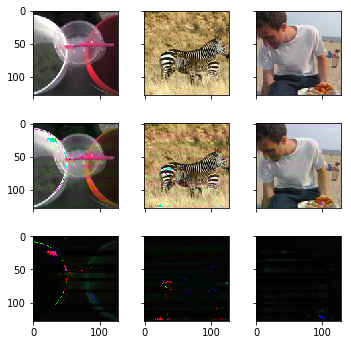


Epoch :  20 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2131912	 | Time     : 265.908577 |
Adversary | Loss  :  0.0000534	 | Accuracy :  0.2218468 |
Encoder   | Loss  :  0.0063698	 | Accuracy :  0.6975564 |
Decoder   | Loss  :  0.1927930	 | Accuracy :  0.6655989 |
Adversary | Loss  : 15.9393711	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1951008	 | Time     :  20.340120 |
Encoder   | Loss  :  0.0033476	 | Accuracy :  0.7134258 |
Decoder   | Loss  :  0.1927572	 | Accuracy :  0.6663654 |
Adversary | Loss  :  0.0003475	 | Accuracy :  0.3624498 |


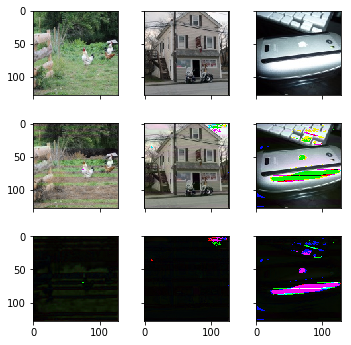


Epoch :  21 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2174456	 | Time     : 264.911843 |
Adversary | Loss  :  0.1794120	 | Accuracy :  0.4790415 |
Encoder   | Loss  :  0.0107328	 | Accuracy :  0.6644640 |
Decoder   | Loss  :  0.1960270	 | Accuracy :  0.6595971 |
Adversary | Loss  : 13.9056911	 | Accuracy :  0.0165165 |

Validation - 
Validate  | Loss  :  0.1948447	 | Time     :  19.958154 |
Encoder   | Loss  :  0.0036110	 | Accuracy :  0.7167906 |
Decoder   | Loss  :  0.1923170	 | Accuracy :  0.6670349 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.1992972 |


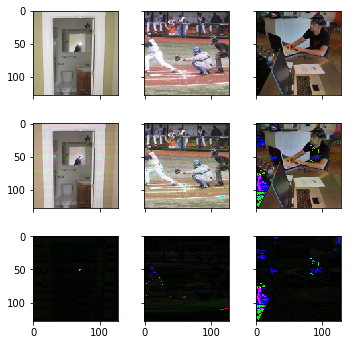


Epoch :  22 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2127499	 | Time     : 265.735406 |
Adversary | Loss  :  0.0013617	 | Accuracy :  0.2628879 |
Encoder   | Loss  :  0.0064197	 | Accuracy :  0.6982921 |
Decoder   | Loss  :  0.1923152	 | Accuracy :  0.6672506 |
Adversary | Loss  : 15.9408693	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1974822	 | Time     :  20.088523 |
Encoder   | Loss  :  0.0067021	 | Accuracy :  0.6498056 |
Decoder   | Loss  :  0.1927907	 | Accuracy :  0.6678046 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.9764055 |


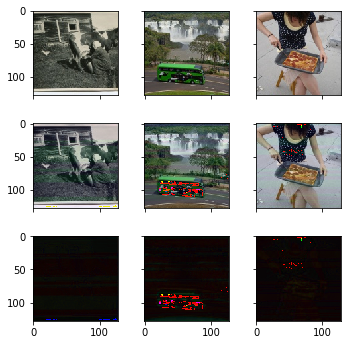


Epoch :  23 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2121204	 | Time     : 263.705636 |
Adversary | Loss  :  0.0026551	 | Accuracy :  0.2653278 |
Encoder   | Loss  :  0.0058495	 | Accuracy :  0.7126915 |
Decoder   | Loss  :  0.1921280	 | Accuracy :  0.6672965 |
Adversary | Loss  : 15.8977385	 | Accuracy :  0.0001251 |

Validation - 
Validate  | Loss  :  0.1943742	 | Time     :  20.190383 |
Encoder   | Loss  :  0.0035494	 | Accuracy :  0.6888772 |
Decoder   | Loss  :  0.1918819	 | Accuracy :  0.6674866 |
Adversary | Loss  :  0.0076014	 | Accuracy :  0.9231928 |


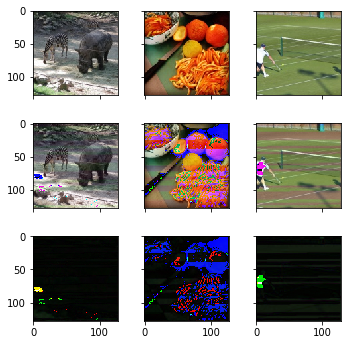


Epoch :  24 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2119320	 | Time     : 264.096381 |
Adversary | Loss  :  0.0171709	 | Accuracy :  0.3047422 |
Encoder   | Loss  :  0.0060445	 | Accuracy :  0.6962162 |
Decoder   | Loss  :  0.1920076	 | Accuracy :  0.6680555 |
Adversary | Loss  : 15.6933098	 | Accuracy :  0.0001251 |

Validation - 
Validate  | Loss  :  0.1974612	 | Time     :  19.848569 |
Encoder   | Loss  :  0.0042624	 | Accuracy :  0.7430317 |
Decoder   | Loss  :  0.1944775	 | Accuracy :  0.6688086 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0050201 |


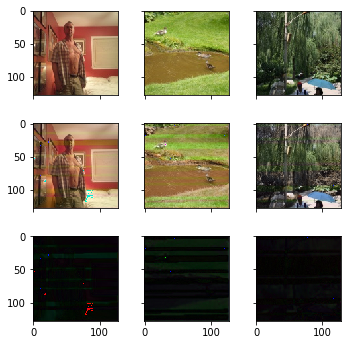


Epoch :  25 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2097077	 | Time     : 265.300184 |
Adversary | Loss  :  0.0002993	 | Accuracy :  0.1808684 |
Encoder   | Loss  :  0.0054362	 | Accuracy :  0.7082018 |
Decoder   | Loss  :  0.1899600	 | Accuracy :  0.6738071 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1912601	 | Time     :  19.979087 |
Encoder   | Loss  :  0.0033202	 | Accuracy :  0.7197650 |
Decoder   | Loss  :  0.1889355	 | Accuracy :  0.6736948 |
Adversary | Loss  :  0.0004419	 | Accuracy :  0.6114458 |


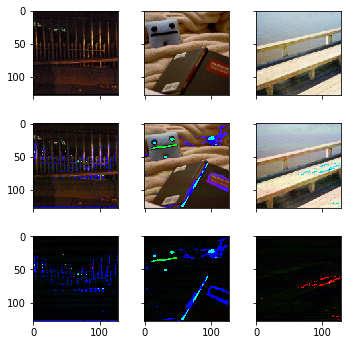


Epoch :  26 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2051467	 | Time     : 265.175780 |
Adversary | Loss  :  0.7894632	 | Accuracy :  0.4132257 |
Encoder   | Loss  :  0.0066012	 | Accuracy :  0.6997341 |
Decoder   | Loss  :  0.1884011	 | Accuracy :  0.6776318 |
Adversary | Loss  : 12.1247063	 | Accuracy :  0.0549299 |

Validation - 
Validate  | Loss  :  0.1914433	 | Time     :  20.076592 |
Encoder   | Loss  :  0.0052333	 | Accuracy :  0.6698337 |
Decoder   | Loss  :  0.1877799	 | Accuracy :  0.6795014 |
Adversary | Loss  :  0.0000552	 | Accuracy :  0.7866467 |


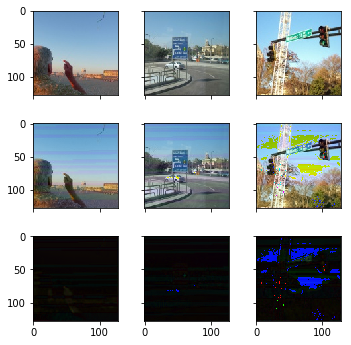


Epoch :  27 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2094738	 | Time     : 264.906570 |
Adversary | Loss  :  0.1801929	 | Accuracy :  0.6396396 |
Encoder   | Loss  :  0.0074791	 | Accuracy :  0.7012300 |
Decoder   | Loss  :  0.1890144	 | Accuracy :  0.6759676 |
Adversary | Loss  : 15.2239876	 | Accuracy :  0.0030030 |

Validation - 
Validate  | Loss  :  0.1924633	 | Time     :  19.886141 |
Encoder   | Loss  :  0.0089600	 | Accuracy :  0.7351806 |
Decoder   | Loss  :  0.1861901	 | Accuracy :  0.6806727 |
Adversary | Loss  :  0.0012758	 | Accuracy :  0.9583333 |


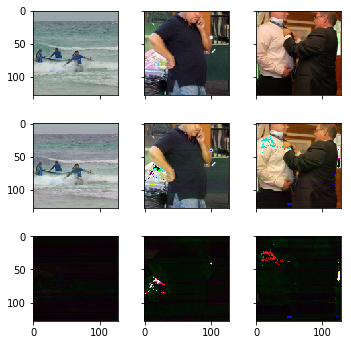


Epoch :  28 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2054585	 | Time     : 263.568775 |
Adversary | Loss  :  0.0014282	 | Accuracy :  0.4839214 |
Encoder   | Loss  :  0.0050711	 | Accuracy :  0.7176821 |
Decoder   | Loss  :  0.1859695	 | Accuracy :  0.6809852 |
Adversary | Loss  : 15.9392948	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1892197	 | Time     :  19.901779 |
Encoder   | Loss  :  0.0031070	 | Accuracy :  0.7477565 |
Decoder   | Loss  :  0.1870447	 | Accuracy :  0.6796687 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.8037149 |


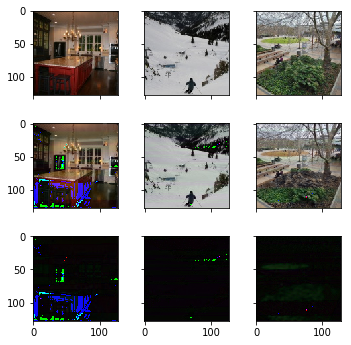


Epoch :  29 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2045642	 | Time     : 264.256950 |
Adversary | Loss  :  0.0007178	 | Accuracy :  0.3758759 |
Encoder   | Loss  :  0.0048275	 | Accuracy :  0.7184660 |
Decoder   | Loss  :  0.1852426	 | Accuracy :  0.6812438 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1889564	 | Time     :  20.136603 |
Encoder   | Loss  :  0.0046374	 | Accuracy :  0.7040312 |
Decoder   | Loss  :  0.1857102	 | Accuracy :  0.6809906 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0888554 |


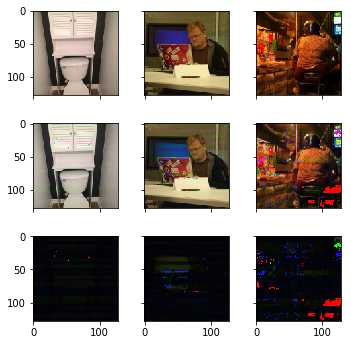


Epoch :  30 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2045644	 | Time     : 263.478576 |
Adversary | Loss  :  0.0011556	 | Accuracy :  0.2742743 |
Encoder   | Loss  :  0.0050662	 | Accuracy :  0.7124937 |
Decoder   | Loss  :  0.1850934	 | Accuracy :  0.6812605 |
Adversary | Loss  : 15.9245911	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1879807	 | Time     :  19.789567 |
Encoder   | Loss  :  0.0030039	 | Accuracy :  0.7388100 |
Decoder   | Loss  :  0.1858776	 | Accuracy :  0.6806058 |
Adversary | Loss  :  0.0004124	 | Accuracy :  0.9543172 |


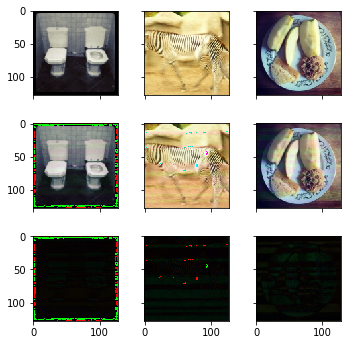


Epoch :  31 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2021576	 | Time     : 263.602012 |
Adversary | Loss  :  0.0028066	 | Accuracy :  0.2045170 |
Encoder   | Loss  :  0.0050250	 | Accuracy :  0.7070870 |
Decoder   | Loss  :  0.1827826	 | Accuracy :  0.6875083 |
Adversary | Loss  : 15.8575096	 | Accuracy :  0.0002503 |

Validation - 
Validate  | Loss  :  0.1827245	 | Time     :  19.941851 |
Encoder   | Loss  :  0.0034153	 | Accuracy :  0.6954266 |
Decoder   | Loss  :  0.1803337	 | Accuracy :  0.6927711 |
Adversary | Loss  :  0.0000951	 | Accuracy :  0.8167672 |


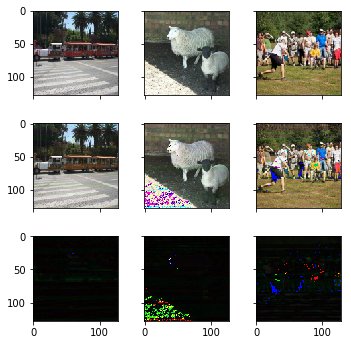


Epoch :  32 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1989741	 | Time     : 263.248239 |
Adversary | Loss  :  0.0003303	 | Accuracy :  0.1050425 |
Encoder   | Loss  :  0.0048686	 | Accuracy :  0.7074582 |
Decoder   | Loss  :  0.1796237	 | Accuracy :  0.6932558 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1806713	 | Time     :  19.998393 |
Encoder   | Loss  :  0.0037230	 | Accuracy :  0.7039670 |
Decoder   | Loss  :  0.1780652	 | Accuracy :  0.6941600 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0446787 |


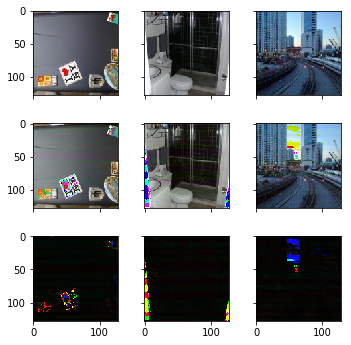


Epoch :  33 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1970383	 | Time     : 263.457787 |
Adversary | Loss  :  0.0037810	 | Accuracy :  0.0939690 |
Encoder   | Loss  :  0.0046997	 | Accuracy :  0.7179223 |
Decoder   | Loss  :  0.1778297	 | Accuracy :  0.6954079 |
Adversary | Loss  : 15.9187689	 | Accuracy :  0.0001251 |

Validation - 
Validate  | Loss  :  0.1816649	 | Time     :  20.214756 |
Encoder   | Loss  :  0.0057919	 | Accuracy :  0.6909034 |
Decoder   | Loss  :  0.1776106	 | Accuracy :  0.6950134 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.1109438 |


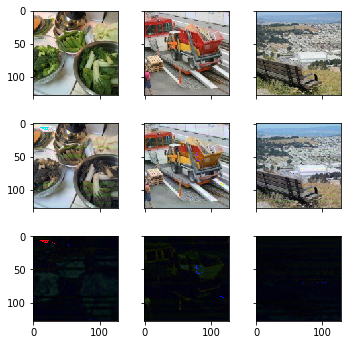


Epoch :  34 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1962560	 | Time     : 263.610302 |
Adversary | Loss  :  0.0080801	 | Accuracy :  0.0891517 |
Encoder   | Loss  :  0.0046711	 | Accuracy :  0.7204108 |
Decoder   | Loss  :  0.1771174	 | Accuracy :  0.6951035 |
Adversary | Loss  : 15.8687534	 | Accuracy :  0.0001251 |

Validation - 
Validate  | Loss  :  0.1791970	 | Time     :  20.069243 |
Encoder   | Loss  :  0.0035384	 | Accuracy :  0.7229563 |
Decoder   | Loss  :  0.1767200	 | Accuracy :  0.6933902 |
Adversary | Loss  :  0.0001268	 | Accuracy :  0.2123494 |


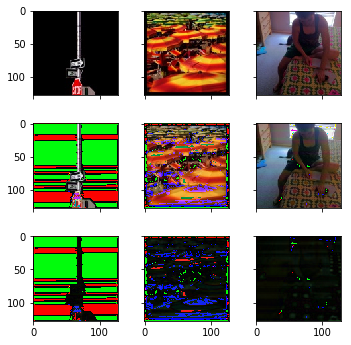


Epoch :  35 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1955884	 | Time     : 263.693509 |
Adversary | Loss  :  0.0000395	 | Accuracy :  0.0320320 |
Encoder   | Loss  :  0.0043924	 | Accuracy :  0.7216509 |
Decoder   | Loss  :  0.1765714	 | Accuracy :  0.6955623 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1784574	 | Time     :  20.293983 |
Encoder   | Loss  :  0.0027876	 | Accuracy :  0.7228818 |
Decoder   | Loss  :  0.1765061	 | Accuracy :  0.6925703 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0020080 |


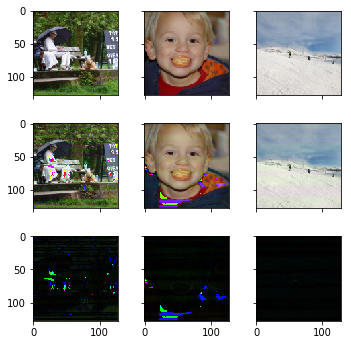


Epoch :  36 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1956635	 | Time     : 263.717251 |
Adversary | Loss  :  0.0191236	 | Accuracy :  0.1258133 |
Encoder   | Loss  :  0.0046615	 | Accuracy :  0.7186954 |
Decoder   | Loss  :  0.1765708	 | Accuracy :  0.6961044 |
Adversary | Loss  : 15.8296423	 | Accuracy :  0.0005005 |

Validation - 
Validate  | Loss  :  0.1808574	 | Time     :  19.964237 |
Encoder   | Loss  :  0.0044225	 | Accuracy :  0.7246267 |
Decoder   | Loss  :  0.1777617	 | Accuracy :  0.6938421 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


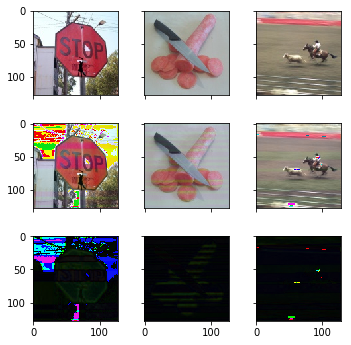


Epoch :  37 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1950155	 | Time     : 263.045802 |
Adversary | Loss  :  0.0001129	 | Accuracy :  0.0715716 |
Encoder   | Loss  :  0.0042131	 | Accuracy :  0.7265158 |
Decoder   | Loss  :  0.1761239	 | Accuracy :  0.6958625 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1786823	 | Time     :  19.891842 |
Encoder   | Loss  :  0.0028573	 | Accuracy :  0.7628520 |
Decoder   | Loss  :  0.1766755	 | Accuracy :  0.6950302 |
Adversary | Loss  :  0.0066579	 | Accuracy :  0.9969879 |


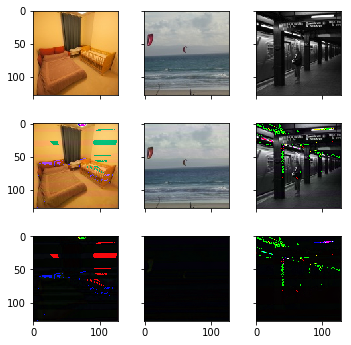


Epoch :  38 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1948378	 | Time     : 263.441534 |
Adversary | Loss  :  0.0003188	 | Accuracy :  0.0871496 |
Encoder   | Loss  :  0.0040864	 | Accuracy :  0.7333350 |
Decoder   | Loss  :  0.1760381	 | Accuracy :  0.6958584 |
Adversary | Loss  : 15.9391479	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1788332	 | Time     :  20.120249 |
Encoder   | Loss  :  0.0028127	 | Accuracy :  0.7411090 |
Decoder   | Loss  :  0.1768643	 | Accuracy :  0.6934906 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0381526 |


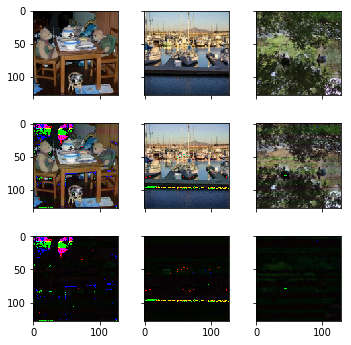


Epoch :  39 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1947384	 | Time     : 263.730887 |
Adversary | Loss  :  0.0002190	 | Accuracy :  0.0629379 |
Encoder   | Loss  :  0.0041070	 | Accuracy :  0.7269522 |
Decoder   | Loss  :  0.1759262	 | Accuracy :  0.6958667 |
Adversary | Loss  : 15.9372950	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1782521	 | Time     :  19.596174 |
Encoder   | Loss  :  0.0024480	 | Accuracy :  0.7497072 |
Decoder   | Loss  :  0.1765386	 | Accuracy :  0.6948293 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0245984 |


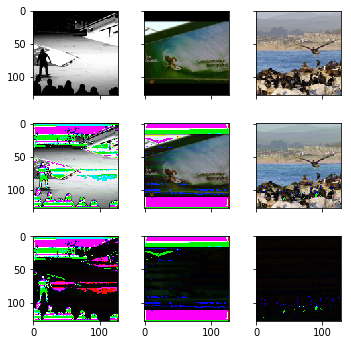


Epoch :  40 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1943890	 | Time     : 263.671644 |
Adversary | Loss  :  0.0005407	 | Accuracy :  0.0502377 |
Encoder   | Loss  :  0.0038626	 | Accuracy :  0.7316100 |
Decoder   | Loss  :  0.1757477	 | Accuracy :  0.6964756 |
Adversary | Loss  : 15.9374914	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1791892	 | Time     :  20.036734 |
Encoder   | Loss  :  0.0036583	 | Accuracy :  0.7239760 |
Decoder   | Loss  :  0.1766284	 | Accuracy :  0.6935408 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.1812249 |


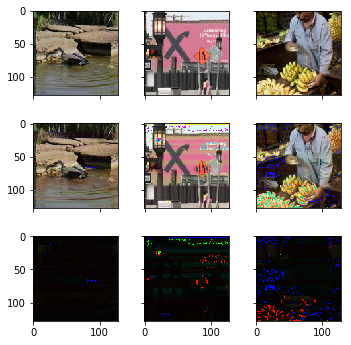


Epoch :  41 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1940963	 | Time     : 263.605864 |
Adversary | Loss  :  0.0056720	 | Accuracy :  0.0792668 |
Encoder   | Loss  :  0.0037195	 | Accuracy :  0.7339624 |
Decoder   | Loss  :  0.1756039	 | Accuracy :  0.6966884 |
Adversary | Loss  : 15.8887119	 | Accuracy :  0.0001251 |

Validation - 
Validate  | Loss  :  0.1783541	 | Time     :  20.089698 |
Encoder   | Loss  :  0.0027778	 | Accuracy :  0.7416221 |
Decoder   | Loss  :  0.1764096	 | Accuracy :  0.6927878 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0155623 |


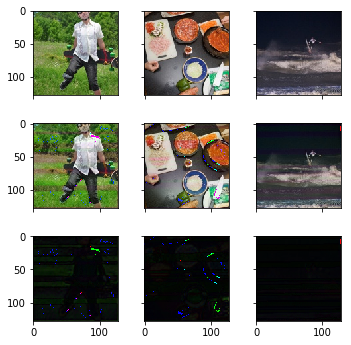


Epoch :  42 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1941355	 | Time     : 263.545404 |
Adversary | Loss  :  0.0002433	 | Accuracy :  0.0511136 |
Encoder   | Loss  :  0.0039379	 | Accuracy :  0.7385319 |
Decoder   | Loss  :  0.1754382	 | Accuracy :  0.6975893 |
Adversary | Loss  : 15.9407816	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1783616	 | Time     :  20.025371 |
Encoder   | Loss  :  0.0029478	 | Accuracy :  0.7460774 |
Decoder   | Loss  :  0.1762982	 | Accuracy :  0.6945282 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0005020 |


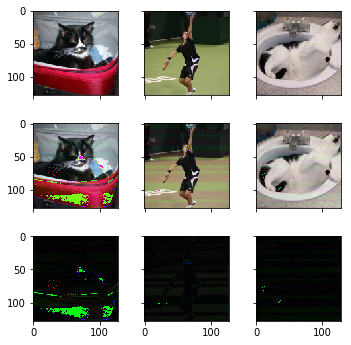


Epoch :  43 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1937514	 | Time     : 263.878720 |
Adversary | Loss  :  0.0118409	 | Accuracy :  0.1094219 |
Encoder   | Loss  :  0.0037055	 | Accuracy :  0.7370191 |
Decoder   | Loss  :  0.1752896	 | Accuracy :  0.6978437 |
Adversary | Loss  : 15.8679953	 | Accuracy :  0.0005005 |

Validation - 
Validate  | Loss  :  0.1796708	 | Time     :  20.287254 |
Encoder   | Loss  :  0.0038967	 | Accuracy :  0.7390131 |
Decoder   | Loss  :  0.1769425	 | Accuracy :  0.6935576 |
Adversary | Loss  :  0.0005678	 | Accuracy :  0.1495984 |


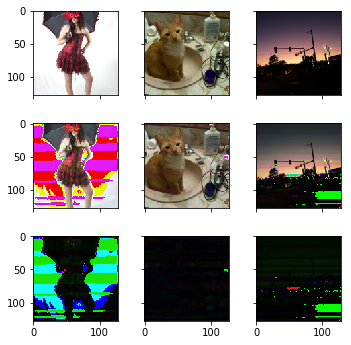


Epoch :  44 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1937950	 | Time     : 263.986471 |
Adversary | Loss  :  0.0177905	 | Accuracy :  0.1694820 |
Encoder   | Loss  :  0.0040184	 | Accuracy :  0.7344274 |
Decoder   | Loss  :  0.1751914	 | Accuracy :  0.6985360 |
Adversary | Loss  : 15.7907782	 | Accuracy :  0.0023774 |

Validation - 
Validate  | Loss  :  0.1781973	 | Time     :  20.094605 |
Encoder   | Loss  :  0.0030512	 | Accuracy :  0.7652370 |
Decoder   | Loss  :  0.1760615	 | Accuracy :  0.6965529 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0015060 |


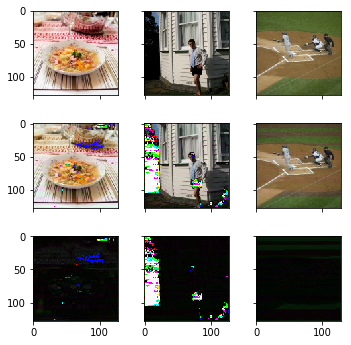


Epoch :  45 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1930806	 | Time     : 263.951663 |
Adversary | Loss  :  0.0000971	 | Accuracy :  0.0683183 |
Encoder   | Loss  :  0.0036086	 | Accuracy :  0.7361770 |
Decoder   | Loss  :  0.1746122	 | Accuracy :  0.7001084 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1780368	 | Time     :  20.103339 |
Encoder   | Loss  :  0.0047586	 | Accuracy :  0.6913520 |
Decoder   | Loss  :  0.1747058	 | Accuracy :  0.7017236 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


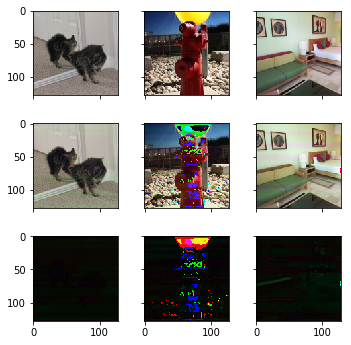


Epoch :  46 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1911112	 | Time     : 263.693869 |
Adversary | Loss  :  0.0000524	 | Accuracy :  0.0392267 |
Encoder   | Loss  :  0.0037381	 | Accuracy :  0.7375084 |
Decoder   | Loss  :  0.1725522	 | Accuracy :  0.7064481 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1737756	 | Time     :  20.025663 |
Encoder   | Loss  :  0.0027537	 | Accuracy :  0.7488654 |
Decoder   | Loss  :  0.1718479	 | Accuracy :  0.7074465 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


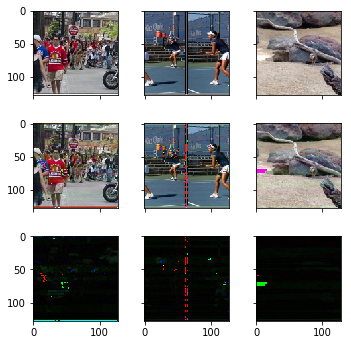


Epoch :  47 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1896137	 | Time     : 263.482385 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0309059 |
Encoder   | Loss  :  0.0035785	 | Accuracy :  0.7336027 |
Decoder   | Loss  :  0.1711663	 | Accuracy :  0.7092843 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1728793	 | Time     :  20.190882 |
Encoder   | Loss  :  0.0021301	 | Accuracy :  0.7475377 |
Decoder   | Loss  :  0.1713882	 | Accuracy :  0.7086011 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0010040 |


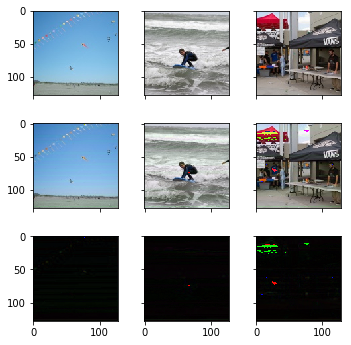


Epoch :  48 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1893030	 | Time     : 263.740414 |
Adversary | Loss  :  0.0280687	 | Accuracy :  0.0763263 |
Encoder   | Loss  :  0.0041517	 | Accuracy :  0.7254484 |
Decoder   | Loss  :  0.1705432	 | Accuracy :  0.7104563 |
Adversary | Loss  : 15.8536139	 | Accuracy :  0.0006256 |

Validation - 
Validate  | Loss  :  0.1726624	 | Time     :  20.398386 |
Encoder   | Loss  :  0.0025742	 | Accuracy :  0.7595111 |
Decoder   | Loss  :  0.1708605	 | Accuracy :  0.7069444 |
Adversary | Loss  :  0.0000061	 | Accuracy :  0.0080321 |


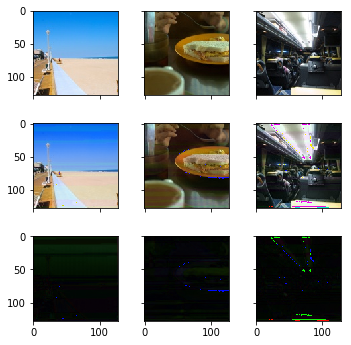


Epoch :  49 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1878673	 | Time     : 264.062871 |
Adversary | Loss  :  0.0003203	 | Accuracy :  0.0633133 |
Encoder   | Loss  :  0.0034871	 | Accuracy :  0.7381545 |
Decoder   | Loss  :  0.1694839	 | Accuracy :  0.7116534 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1750976	 | Time     :  19.816421 |
Encoder   | Loss  :  0.0062286	 | Accuracy :  0.7138821 |
Decoder   | Loss  :  0.1707374	 | Accuracy :  0.7076138 |
Adversary | Loss  :  0.0001566	 | Accuracy :  0.0672691 |


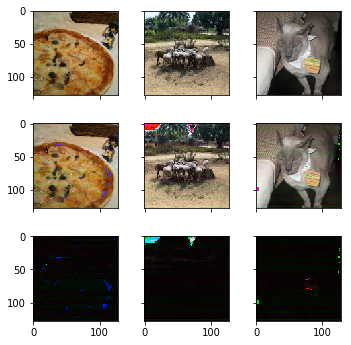


Epoch :  50 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2018456	 | Time     : 263.905986 |
Adversary | Loss  :  0.3219823	 | Accuracy :  0.5667542 |
Encoder   | Loss  :  0.0232684	 | Accuracy :  0.6369533 |
Decoder   | Loss  :  0.1748940	 | Accuracy :  0.7013639 |
Adversary | Loss  : 10.6638145	 | Accuracy :  0.0608108 |

Validation - 
Validate  | Loss  :  0.1978885	 | Time     :  19.738046 |
Encoder   | Loss  :  0.0236765	 | Accuracy :  0.6747537 |
Decoder   | Loss  :  0.1812143	 | Accuracy :  0.6886714 |
Adversary | Loss  :  0.1006700	 | Accuracy :  0.9959840 |


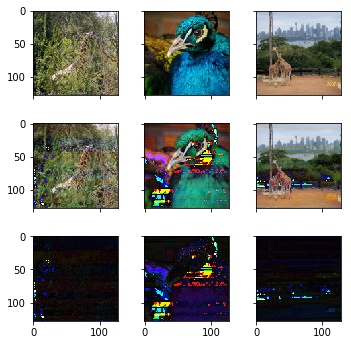


Epoch :  51 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1853953	 | Time     : 263.968934 |
Adversary | Loss  :  5.2817001	 | Accuracy :  0.3262012 |
Encoder   | Loss  :  0.0112390	 | Accuracy :  0.6731657 |
Decoder   | Loss  :  0.1727345	 | Accuracy :  0.7038789 |
Adversary | Loss  :  4.7935934	 | Accuracy :  0.1928178 |

Validation - 
Validate  | Loss  :  0.1782888	 | Time     :  20.155771 |
Encoder   | Loss  :  0.0058676	 | Accuracy :  0.7029549 |
Decoder   | Loss  :  0.1709094	 | Accuracy :  0.7038320 |
Adversary | Loss  :  3.2720358	 | Accuracy :  0.3790161 |


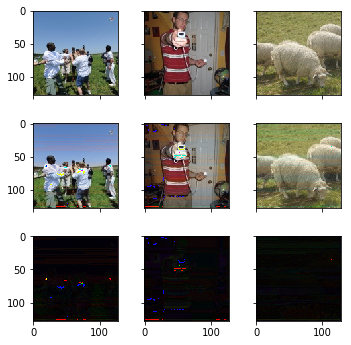


Epoch :  52 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1775991	 | Time     : 263.564814 |
Adversary | Loss  :  3.3695755	 | Accuracy :  0.4192317 |
Encoder   | Loss  :  0.0069528	 | Accuracy :  0.6848228 |
Decoder   | Loss  :  0.1698709	 | Accuracy :  0.7077536 |
Adversary | Loss  :  2.8612580	 | Accuracy :  0.4299299 |

Validation - 
Validate  | Loss  :  0.1752820	 | Time     :  19.877886 |
Encoder   | Loss  :  0.0044417	 | Accuracy :  0.6983746 |
Decoder   | Loss  :  0.1714365	 | Accuracy :  0.7054217 |
Adversary | Loss  :  0.7362832	 | Accuracy :  0.6691767 |


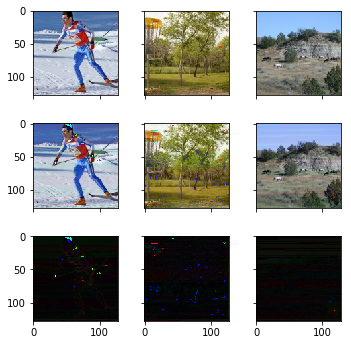


Epoch :  53 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1729919	 | Time     : 263.078355 |
Adversary | Loss  :  0.7000500	 | Accuracy :  0.5735736 |
Encoder   | Loss  :  0.0049531	 | Accuracy :  0.7071403 |
Decoder   | Loss  :  0.1687039	 | Accuracy :  0.7104855 |
Adversary | Loss  :  0.8208838	 | Accuracy :  0.3930180 |

Validation - 
Validate  | Loss  :  0.1710545	 | Time     :  19.792796 |
Encoder   | Loss  :  0.0027938	 | Accuracy :  0.7161691 |
Decoder   | Loss  :  0.1685413	 | Accuracy :  0.7083835 |
Adversary | Loss  :  0.5575933	 | Accuracy :  0.8860443 |


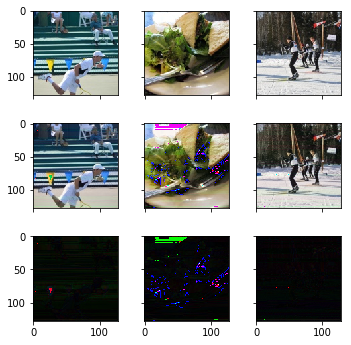


Epoch :  54 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1720429	 | Time     : 264.240471 |
Adversary | Loss  :  0.6579068	 | Accuracy :  0.6193694 |
Encoder   | Loss  :  0.0043299	 | Accuracy :  0.7337046 |
Decoder   | Loss  :  0.1682167	 | Accuracy :  0.7108359 |
Adversary | Loss  :  0.7953191	 | Accuracy :  0.4207958 |

Validation - 
Validate  | Loss  :  0.1731357	 | Time     :  19.903054 |
Encoder   | Loss  :  0.0051494	 | Accuracy :  0.7472565 |
Decoder   | Loss  :  0.1688312	 | Accuracy :  0.7055054 |
Adversary | Loss  :  0.6998842	 | Accuracy :  0.5878514 |


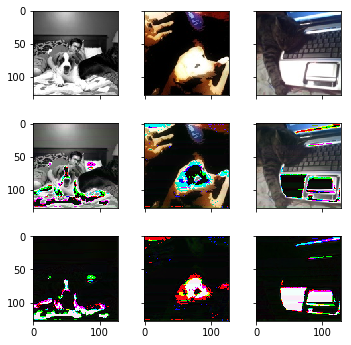


Epoch :  55 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1719421	 | Time     : 264.158345 |
Adversary | Loss  :  0.6667230	 | Accuracy :  0.6283158 |
Encoder   | Loss  :  0.0041856	 | Accuracy :  0.7530780 |
Decoder   | Loss  :  0.1680921	 | Accuracy :  0.7103896 |
Adversary | Loss  :  0.9201041	 | Accuracy :  0.3484735 |

Validation - 
Validate  | Loss  :  0.1712758	 | Time     :  20.205643 |
Encoder   | Loss  :  0.0027603	 | Accuracy :  0.7839870 |
Decoder   | Loss  :  0.1685520	 | Accuracy :  0.7071620 |
Adversary | Loss  :  0.7916516	 | Accuracy :  0.4467872 |


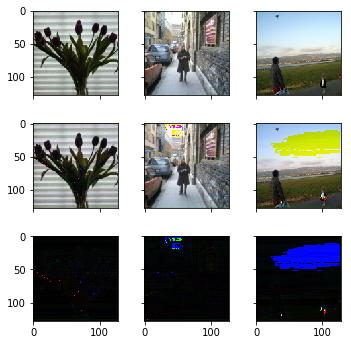


Epoch :  56 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1718517	 | Time     : 263.976811 |
Adversary | Loss  :  0.5475568	 | Accuracy :  0.7347973 |
Encoder   | Loss  :  0.0037771	 | Accuracy :  0.7650647 |
Decoder   | Loss  :  0.1680937	 | Accuracy :  0.7099099 |
Adversary | Loss  :  1.1141425	 | Accuracy :  0.2117117 |

Validation - 
Validate  | Loss  :  0.1735028	 | Time     :  20.145898 |
Encoder   | Loss  :  0.0041206	 | Accuracy :  0.7933039 |
Decoder   | Loss  :  0.1697679	 | Accuracy :  0.7046352 |
Adversary | Loss  :  0.8504117	 | Accuracy :  0.5411647 |


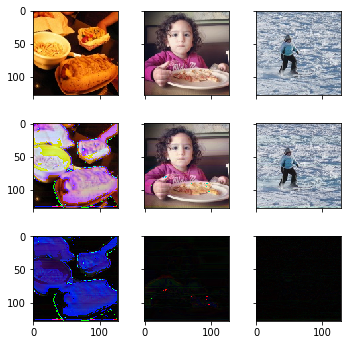


Epoch :  57 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1758738	 | Time     : 263.779975 |
Adversary | Loss  :  2.6865430	 | Accuracy :  0.5210836 |
Encoder   | Loss  :  0.0032461	 | Accuracy :  0.7800102 |
Decoder   | Loss  :  0.1682027	 | Accuracy :  0.7108066 |
Adversary | Loss  :  5.3988457	 | Accuracy :  0.1960711 |

Validation - 
Validate  | Loss  :  0.1725654	 | Time     :  20.009129 |
Encoder   | Loss  :  0.0061086	 | Accuracy :  0.7311580 |
Decoder   | Loss  :  0.1682894	 | Accuracy :  0.7086011 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0005020 |


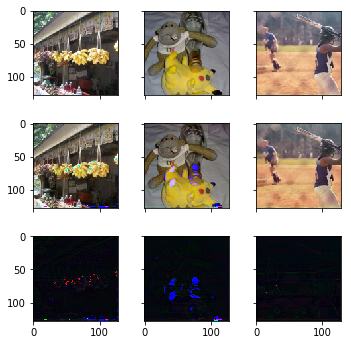


Epoch :  58 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1773381	 | Time     : 263.150857 |
Adversary | Loss  :  4.5706472	 | Accuracy :  0.3355856 |
Encoder   | Loss  :  0.0031860	 | Accuracy :  0.7661554 |
Decoder   | Loss  :  0.1671908	 | Accuracy :  0.7127044 |
Adversary | Loss  :  7.9171433	 | Accuracy :  0.2203453 |

Validation - 
Validate  | Loss  :  0.1714513	 | Time     :  20.119791 |
Encoder   | Loss  :  0.0034998	 | Accuracy :  0.7419671 |
Decoder   | Loss  :  0.1685201	 | Accuracy :  0.7079485 |
Adversary | Loss  :  0.4813789	 | Accuracy :  0.8353413 |


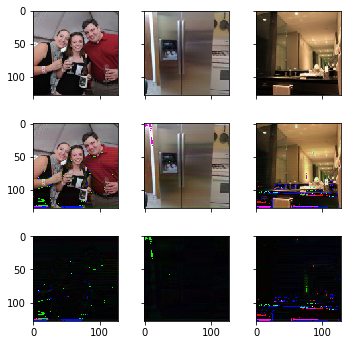


Epoch :  59 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1704153	 | Time     : 264.324615 |
Adversary | Loss  :  0.5759187	 | Accuracy :  0.7327327 |
Encoder   | Loss  :  0.0032297	 | Accuracy :  0.7655762 |
Decoder   | Loss  :  0.1672289	 | Accuracy :  0.7132341 |
Adversary | Loss  :  0.9256390	 | Accuracy :  0.3094344 |

Validation - 
Validate  | Loss  :  0.1711721	 | Time     :  20.282492 |
Encoder   | Loss  :  0.0026037	 | Accuracy :  0.7788245 |
Decoder   | Loss  :  0.1685351	 | Accuracy :  0.7102409 |
Adversary | Loss  :  0.8144507	 | Accuracy :  0.3207831 |


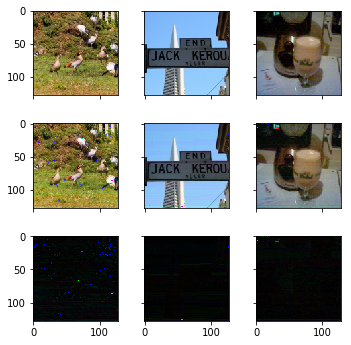


Epoch :  60 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1702017	 | Time     : 264.383986 |
Adversary | Loss  :  0.4896128	 | Accuracy :  0.8115616 |
Encoder   | Loss  :  0.0027656	 | Accuracy :  0.7883455 |
Decoder   | Loss  :  0.1669789	 | Accuracy :  0.7139515 |
Adversary | Loss  :  1.2869321	 | Accuracy :  0.1566567 |

Validation - 
Validate  | Loss  :  0.1706391	 | Time     :  20.132506 |
Encoder   | Loss  :  0.0019869	 | Accuracy :  0.7887312 |
Decoder   | Loss  :  0.1685830	 | Accuracy :  0.7081660 |
Adversary | Loss  :  0.6652797	 | Accuracy :  0.6189759 |


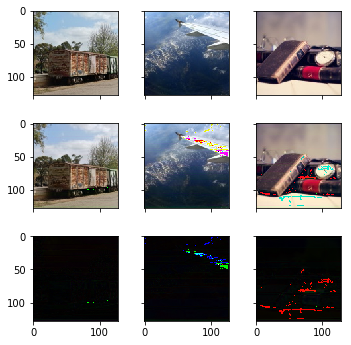


Epoch :  61 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1704853	 | Time     : 264.759765 |
Adversary | Loss  :  0.4941570	 | Accuracy :  0.7956707 |
Encoder   | Loss  :  0.0031186	 | Accuracy :  0.7976624 |
Decoder   | Loss  :  0.1668964	 | Accuracy :  0.7146647 |
Adversary | Loss  :  1.4057956	 | Accuracy :  0.1808058 |

Validation - 
Validate  | Loss  :  0.1691093	 | Time     :  19.883327 |
Encoder   | Loss  :  0.0018266	 | Accuracy :  0.8197639 |
Decoder   | Loss  :  0.1673605	 | Accuracy :  0.7142570 |
Adversary | Loss  :  0.4701790	 | Accuracy :  0.9277108 |


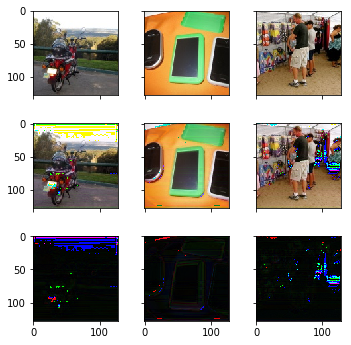


Epoch :  62 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1733025	 | Time     : 264.718991 |
Adversary | Loss  :  1.8714647	 | Accuracy :  0.6847473 |
Encoder   | Loss  :  0.0059098	 | Accuracy :  0.7624871 |
Decoder   | Loss  :  0.1671827	 | Accuracy :  0.7171630 |
Adversary | Loss  :  1.9829048	 | Accuracy :  0.2017017 |

Validation - 
Validate  | Loss  :  0.1708951	 | Time     :  20.006309 |
Encoder   | Loss  :  0.0018490	 | Accuracy :  0.8062388 |
Decoder   | Loss  :  0.1656027	 | Accuracy :  0.7183735 |
Adversary | Loss  :  3.9980841	 | Accuracy :  0.4377510 |


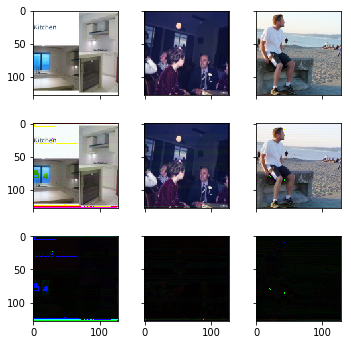


Epoch :  63 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1684931	 | Time     : 263.561775 |
Adversary | Loss  :  7.9967523	 | Accuracy :  0.0102603 |
Encoder   | Loss  :  0.0052620	 | Accuracy :  0.7497690 |
Decoder   | Loss  :  0.1647705	 | Accuracy :  0.7227186 |
Adversary | Loss  :  0.0392158	 | Accuracy :  0.0157658 |

Validation - 
Validate  | Loss  :  0.1824068	 | Time     :  19.784554 |
Encoder   | Loss  :  0.0022206	 | Accuracy :  0.7882621 |
Decoder   | Loss  :  0.1648595	 | Accuracy :  0.7202309 |
Adversary | Loss  : 15.9928951	 | Accuracy :  0.0035141 |


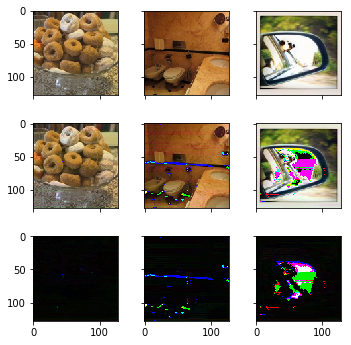


Epoch :  64 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1658138	 | Time     : 264.480932 |
Adversary | Loss  :  8.0279331	 | Accuracy :  0.0061311 |
Encoder   | Loss  :  0.0029859	 | Accuracy :  0.7740983 |
Decoder   | Loss  :  0.1637203	 | Accuracy :  0.7244703 |
Adversary | Loss  :  0.0034606	 | Accuracy :  0.0098849 |

Validation - 
Validate  | Loss  :  0.1819950	 | Time     :  20.057041 |
Encoder   | Loss  :  0.0024463	 | Accuracy :  0.8056448 |
Decoder   | Loss  :  0.1646233	 | Accuracy :  0.7209337 |
Adversary | Loss  : 15.6593256	 | Accuracy :  0.0115462 |


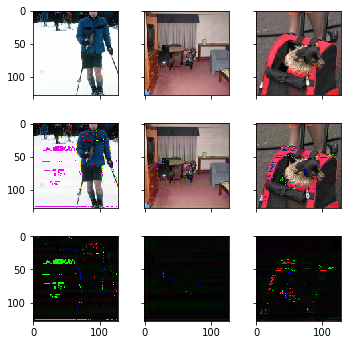


Epoch :  65 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1651340	 | Time     : 264.164463 |
Adversary | Loss  :  7.9697647	 | Accuracy :  0.0139515 |
Encoder   | Loss  :  0.0026272	 | Accuracy :  0.7777065 |
Decoder   | Loss  :  0.1632384	 | Accuracy :  0.7265974 |
Adversary | Loss  :  0.0565664	 | Accuracy :  0.0236487 |

Validation - 
Validate  | Loss  :  0.1818731	 | Time     :  20.276251 |
Encoder   | Loss  :  0.0023804	 | Accuracy :  0.7970653 |
Decoder   | Loss  :  0.1648067	 | Accuracy :  0.7226573 |
Adversary | Loss  : 15.4001846	 | Accuracy :  0.0175703 |


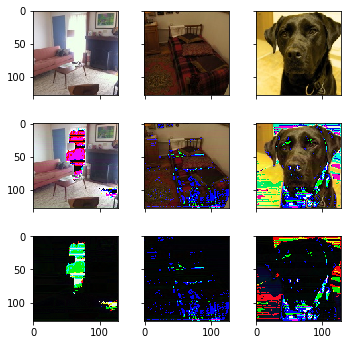


Epoch :  66 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1647755	 | Time     : 263.638849 |
Adversary | Loss  :  7.9047050	 | Accuracy :  0.0260260 |
Encoder   | Loss  :  0.0025715	 | Accuracy :  0.7750140 |
Decoder   | Loss  :  0.1628484	 | Accuracy :  0.7275692 |
Adversary | Loss  :  0.1270494	 | Accuracy :  0.0394144 |

Validation - 
Validate  | Loss  :  0.1806511	 | Time     :  20.071525 |
Encoder   | Loss  :  0.0021348	 | Accuracy :  0.7736824 |
Decoder   | Loss  :  0.1637795	 | Accuracy :  0.7227243 |
Adversary | Loss  : 15.3771811	 | Accuracy :  0.0230924 |


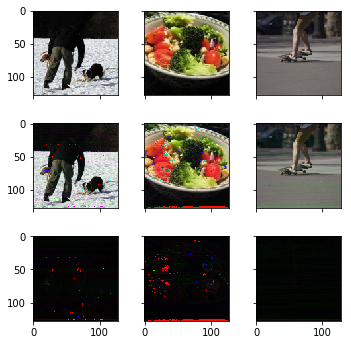


Epoch :  67 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1641855	 | Time     : 263.795541 |
Adversary | Loss  :  7.9643803	 | Accuracy :  0.0172673 |
Encoder   | Loss  :  0.0023524	 | Accuracy :  0.7767270 |
Decoder   | Loss  :  0.1624604	 | Accuracy :  0.7286119 |
Adversary | Loss  :  0.0784026	 | Accuracy :  0.0289039 |

Validation - 
Validate  | Loss  :  0.1795283	 | Time     :  19.970885 |
Encoder   | Loss  :  0.0023072	 | Accuracy :  0.8039683 |
Decoder   | Loss  :  0.1624101	 | Accuracy :  0.7268742 |
Adversary | Loss  : 15.5031500	 | Accuracy :  0.0180723 |


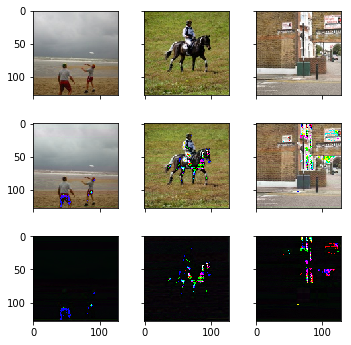


Epoch :  68 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1644807	 | Time     : 264.257979 |
Adversary | Loss  :  7.6476836	 | Accuracy :  0.0661286 |
Encoder   | Loss  :  0.0028202	 | Accuracy :  0.7708474 |
Decoder   | Loss  :  0.1619933	 | Accuracy :  0.7304137 |
Adversary | Loss  :  0.5133654	 | Accuracy :  0.0953453 |

Validation - 
Validate  | Loss  :  0.1752343	 | Time     :  20.039193 |
Encoder   | Loss  :  0.0031914	 | Accuracy :  0.8000273 |
Decoder   | Loss  :  0.1625156	 | Accuracy :  0.7274431 |
Adversary | Loss  : 10.4847746	 | Accuracy :  0.1425703 |


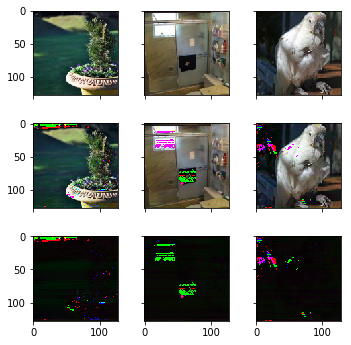


Epoch :  69 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1674405	 | Time     : 264.321154 |
Adversary | Loss  :  6.5854435	 | Accuracy :  0.2010135 |
Encoder   | Loss  :  0.0025754	 | Accuracy :  0.7736129 |
Decoder   | Loss  :  0.1616327	 | Accuracy :  0.7316233 |
Adversary | Loss  :  4.0050125	 | Accuracy :  0.2462462 |

Validation - 
Validate  | Loss  :  0.1763278	 | Time     :  20.014436 |
Encoder   | Loss  :  0.0024856	 | Accuracy :  0.7581238 |
Decoder   | Loss  :  0.1619571	 | Accuracy :  0.7281459 |
Adversary | Loss  : 12.6308031	 | Accuracy :  0.0928715 |


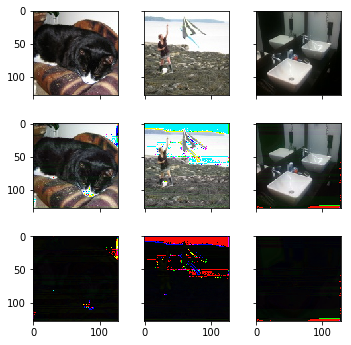


Epoch :  70 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1702205	 | Time     : 264.281030 |
Adversary | Loss  :  6.2561703	 | Accuracy :  0.2642643 |
Encoder   | Loss  :  0.0031101	 | Accuracy :  0.7599205 |
Decoder   | Loss  :  0.1612031	 | Accuracy :  0.7331831 |
Adversary | Loss  :  6.8403864	 | Accuracy :  0.2457457 |

Validation - 
Validate  | Loss  :  0.1640363	 | Time     :  19.966778 |
Encoder   | Loss  :  0.0017667	 | Accuracy :  0.7543342 |
Decoder   | Loss  :  0.1610619	 | Accuracy :  0.7309070 |
Adversary | Loss  :  1.7377058	 | Accuracy :  0.3453815 |


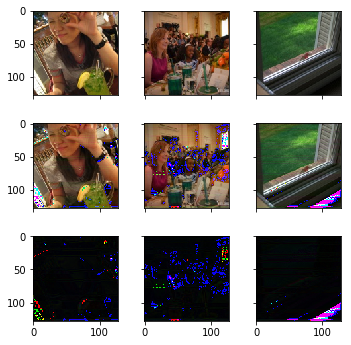


Epoch :  71 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1668737	 | Time     : 264.129290 |
Adversary | Loss  :  3.9021134	 | Accuracy :  0.4015265 |
Encoder   | Loss  :  0.0028328	 | Accuracy :  0.7649424 |
Decoder   | Loss  :  0.1604965	 | Accuracy :  0.7349766 |
Adversary | Loss  :  4.3942504	 | Accuracy :  0.3961461 |

Validation - 
Validate  | Loss  :  0.1631803	 | Time     :  20.203321 |
Encoder   | Loss  :  0.0018962	 | Accuracy :  0.7570019 |
Decoder   | Loss  :  0.1612175	 | Accuracy :  0.7312583 |
Adversary | Loss  :  0.6355376	 | Accuracy :  0.7334337 |


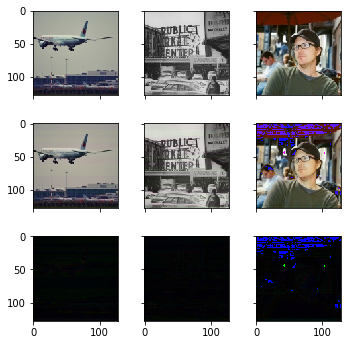


Epoch :  72 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1621783	 | Time     : 264.049026 |
Adversary | Loss  :  0.8638507	 | Accuracy :  0.4518894 |
Encoder   | Loss  :  0.0022842	 | Accuracy :  0.7693195 |
Decoder   | Loss  :  0.1598695	 | Accuracy :  0.7373832 |
Adversary | Loss  :  0.7098566	 | Accuracy :  0.5784535 |

Validation - 
Validate  | Loss  :  0.1675131	 | Time     :  20.284859 |
Encoder   | Loss  :  0.0075381	 | Accuracy :  0.7951143 |
Decoder   | Loss  :  0.1614701	 | Accuracy :  0.7299532 |
Adversary | Loss  :  0.7663727	 | Accuracy :  0.4312250 |


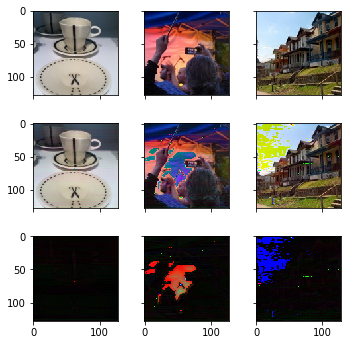


Epoch :  73 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1617802	 | Time     : 264.015118 |
Adversary | Loss  :  0.7189893	 | Accuracy :  0.4979354 |
Encoder   | Loss  :  0.0023762	 | Accuracy :  0.7725238 |
Decoder   | Loss  :  0.1594240	 | Accuracy :  0.7381882 |
Adversary | Loss  :  0.6927791	 | Accuracy :  0.5356607 |

Validation - 
Validate  | Loss  :  0.1607406	 | Time     :  19.700436 |
Encoder   | Loss  :  0.0015545	 | Accuracy :  0.7898940 |
Decoder   | Loss  :  0.1590161	 | Accuracy :  0.7365294 |
Adversary | Loss  :  0.6363772	 | Accuracy :  0.7188755 |


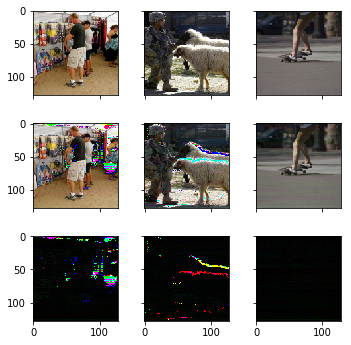


Epoch :  74 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1612571	 | Time     : 264.821715 |
Adversary | Loss  :  0.6582912	 | Accuracy :  0.6004129 |
Encoder   | Loss  :  0.0022558	 | Accuracy :  0.7805687 |
Decoder   | Loss  :  0.1588989	 | Accuracy :  0.7398315 |
Adversary | Loss  :  0.7791622	 | Accuracy :  0.3901401 |

Validation - 
Validate  | Loss  :  0.1620795	 | Time     :  20.059930 |
Encoder   | Loss  :  0.0026987	 | Accuracy :  0.8136400 |
Decoder   | Loss  :  0.1598215	 | Accuracy :  0.7369645 |
Adversary | Loss  :  0.3690304	 | Accuracy :  0.9779117 |


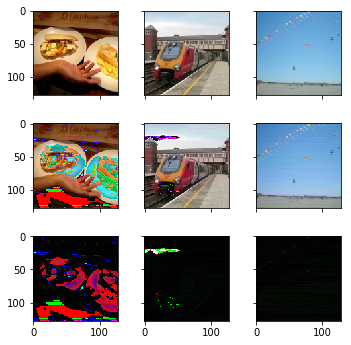


Epoch :  75 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1622271	 | Time     : 264.974536 |
Adversary | Loss  :  0.4670741	 | Accuracy :  0.8120621 |
Encoder   | Loss  :  0.0024077	 | Accuracy :  0.8030128 |
Decoder   | Loss  :  0.1591359	 | Accuracy :  0.7418794 |
Adversary | Loss  :  1.4058287	 | Accuracy :  0.1402653 |

Validation - 
Validate  | Loss  :  0.1619366	 | Time     :  20.224425 |
Encoder   | Loss  :  0.0026896	 | Accuracy :  0.8461482 |
Decoder   | Loss  :  0.1597135	 | Accuracy :  0.7386714 |
Adversary | Loss  :  0.3403703	 | Accuracy :  0.9733936 |


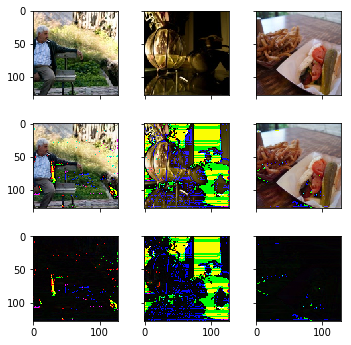


Epoch :  76 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1692019	 | Time     : 264.067826 |
Adversary | Loss  :  0.4800090	 | Accuracy :  0.8578579 |
Encoder   | Loss  :  0.0069510	 | Accuracy :  0.7706180 |
Decoder   | Loss  :  0.1611658	 | Accuracy :  0.7384927 |
Adversary | Loss  :  3.1704462	 | Accuracy :  0.0935936 |

Validation - 
Validate  | Loss  :  0.1643622	 | Time     :  20.178845 |
Encoder   | Loss  :  0.0051548	 | Accuracy :  0.7782610 |
Decoder   | Loss  :  0.1606348	 | Accuracy :  0.7349063 |
Adversary | Loss  :  0.1189700	 | Accuracy :  0.9799196 |


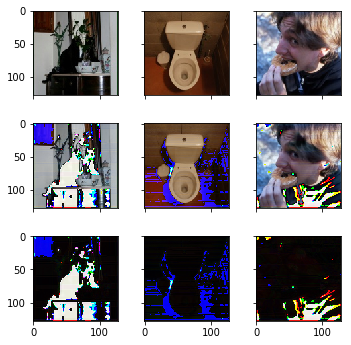


Epoch :  77 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1680667	 | Time     : 264.708075 |
Adversary | Loss  :  0.2711402	 | Accuracy :  0.9208584 |
Encoder   | Loss  :  0.0043770	 | Accuracy :  0.7850596 |
Decoder   | Loss  :  0.1609150	 | Accuracy :  0.7408950 |
Adversary | Loss  :  4.0878267	 | Accuracy :  0.0573073 |

Validation - 
Validate  | Loss  :  0.1633814	 | Time     :  20.120539 |
Encoder   | Loss  :  0.0031795	 | Accuracy :  0.7685624 |
Decoder   | Loss  :  0.1609893	 | Accuracy :  0.7397088 |
Adversary | Loss  :  0.1664677	 | Accuracy :  0.9889557 |


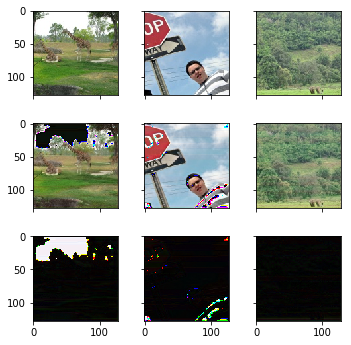


Epoch :  78 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1766575	 | Time     : 264.266851 |
Adversary | Loss  :  0.1563698	 | Accuracy :  0.9161036 |
Encoder   | Loss  :  0.0060450	 | Accuracy :  0.7519820 |
Decoder   | Loss  :  0.1632985	 | Accuracy :  0.7358734 |
Adversary | Loss  :  9.1274948	 | Accuracy :  0.0165165 |

Validation - 
Validate  | Loss  :  0.1623259	 | Time     :  20.249012 |
Encoder   | Loss  :  0.0042493	 | Accuracy :  0.7312681 |
Decoder   | Loss  :  0.1593436	 | Accuracy :  0.7392403 |
Adversary | Loss  :  0.0077499	 | Accuracy :  0.9648594 |


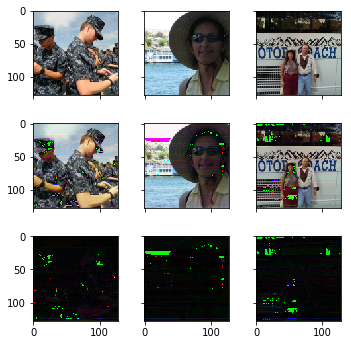


Epoch :  79 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1760737	 | Time     : 264.222459 |
Adversary | Loss  :  0.0387486	 | Accuracy :  0.6959459 |
Encoder   | Loss  :  0.0043810	 | Accuracy :  0.7775672 |
Decoder   | Loss  :  0.1594176	 | Accuracy :  0.7434059 |
Adversary | Loss  : 13.5893860	 | Accuracy :  0.0012513 |

Validation - 
Validate  | Loss  :  0.1593562	 | Time     :  20.235117 |
Encoder   | Loss  :  0.0029662	 | Accuracy :  0.7953587 |
Decoder   | Loss  :  0.1572799	 | Accuracy :  0.7436078 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0642570 |


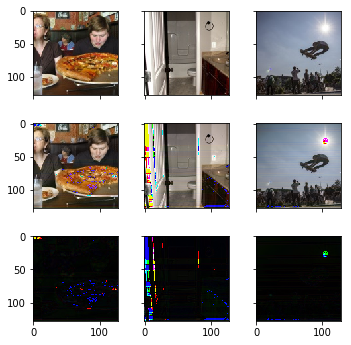


Epoch :  80 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1740299	 | Time     : 264.192642 |
Adversary | Loss  :  0.0000318	 | Accuracy :  0.1320070 |
Encoder   | Loss  :  0.0029555	 | Accuracy :  0.7877030 |
Decoder   | Loss  :  0.1560187	 | Accuracy :  0.7499791 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1578228	 | Time     :  20.085027 |
Encoder   | Loss  :  0.0034346	 | Accuracy :  0.7929127 |
Decoder   | Loss  :  0.1554186	 | Accuracy :  0.7477242 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0281124 |


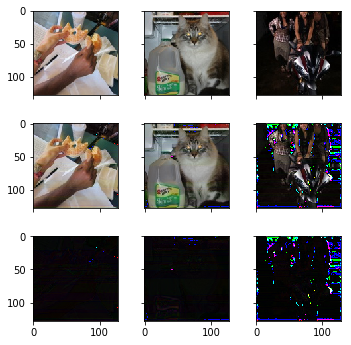


Epoch :  81 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1728252	 | Time     : 264.211774 |
Adversary | Loss  :  0.0000173	 | Accuracy :  0.0606857 |
Encoder   | Loss  :  0.0023849	 | Accuracy :  0.7930219 |
Decoder   | Loss  :  0.1552134	 | Accuracy :  0.7509384 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1582731	 | Time     :  20.173579 |
Encoder   | Loss  :  0.0032462	 | Accuracy :  0.7936913 |
Decoder   | Loss  :  0.1560008	 | Accuracy :  0.7452644 |
Adversary | Loss  :  0.0000275	 | Accuracy :  0.1114458 |


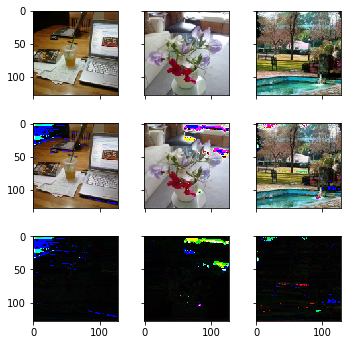


Epoch :  82 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1720285	 | Time     : 264.104496 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0290290 |
Encoder   | Loss  :  0.0022652	 | Accuracy :  0.7910002 |
Decoder   | Loss  :  0.1545004	 | Accuracy :  0.7534785 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1549739	 | Time     :  20.216369 |
Encoder   | Loss  :  0.0012612	 | Accuracy :  0.8136573 |
Decoder   | Loss  :  0.1540911	 | Accuracy :  0.7505522 |
Adversary | Loss  :  0.0000028	 | Accuracy :  0.0963856 |


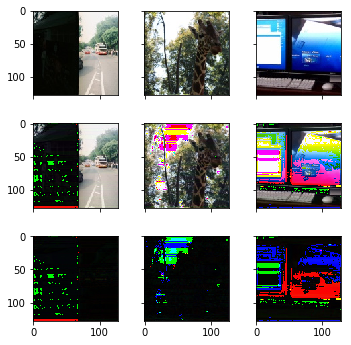


Epoch :  83 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1713644	 | Time     : 263.646745 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0260886 |
Encoder   | Loss  :  0.0022540	 | Accuracy :  0.7898788 |
Decoder   | Loss  :  0.1538442	 | Accuracy :  0.7557349 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1576220	 | Time     :  20.048543 |
Encoder   | Loss  :  0.0049486	 | Accuracy :  0.8242167 |
Decoder   | Loss  :  0.1541580	 | Accuracy :  0.7522088 |
Adversary | Loss  :  0.0000205	 | Accuracy :  0.0677711 |


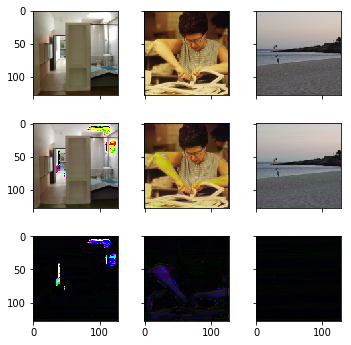


Epoch :  84 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1708369	 | Time     : 263.920657 |
Adversary | Loss  :  0.0000711	 | Accuracy :  0.0295295 |
Encoder   | Loss  :  0.0023044	 | Accuracy :  0.7869297 |
Decoder   | Loss  :  0.1532829	 | Accuracy :  0.7566191 |
Adversary | Loss  : 15.9408636	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1548111	 | Time     :  20.066483 |
Encoder   | Loss  :  0.0026103	 | Accuracy :  0.7556161 |
Decoder   | Loss  :  0.1529839	 | Accuracy :  0.7544846 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0065261 |


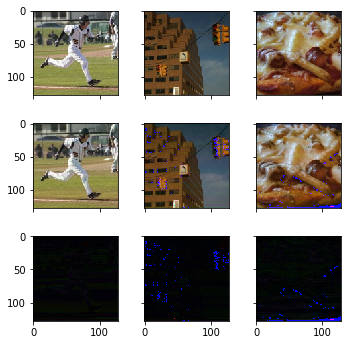


Epoch :  85 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1695322	 | Time     : 263.207192 |
Adversary | Loss  :  0.0001432	 | Accuracy :  0.0170170 |
Encoder   | Loss  :  0.0021650	 | Accuracy :  0.7859713 |
Decoder   | Loss  :  0.1520791	 | Accuracy :  0.7603145 |
Adversary | Loss  : 15.9375591	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1532170	 | Time     :  19.831572 |
Encoder   | Loss  :  0.0018107	 | Accuracy :  0.7813093 |
Decoder   | Loss  :  0.1519485	 | Accuracy :  0.7574632 |
Adversary | Loss  :  0.0010907	 | Accuracy :  0.7515060 |


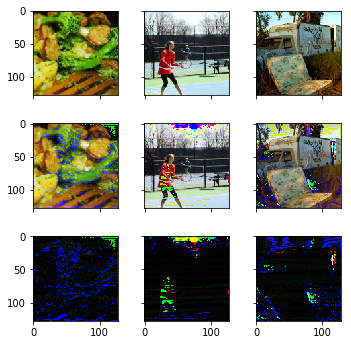


Epoch :  86 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1677144	 | Time     : 263.701024 |
Adversary | Loss  :  0.0001437	 | Accuracy :  0.0340340 |
Encoder   | Loss  :  0.0025143	 | Accuracy :  0.7709488 |
Decoder   | Loss  :  0.1500136	 | Accuracy :  0.7660035 |
Adversary | Loss  : 15.9408407	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1501741	 | Time     :  20.086742 |
Encoder   | Loss  :  0.0022341	 | Accuracy :  0.7755929 |
Decoder   | Loss  :  0.1486102	 | Accuracy :  0.7635710 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0778112 |


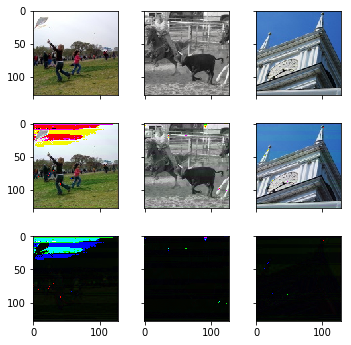


Epoch :  87 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1659685	 | Time     : 263.531248 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0042543 |
Encoder   | Loss  :  0.0022794	 | Accuracy :  0.7765807 |
Decoder   | Loss  :  0.1484306	 | Accuracy :  0.7686311 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1483875	 | Time     :  19.992187 |
Encoder   | Loss  :  0.0032096	 | Accuracy :  0.7880949 |
Decoder   | Loss  :  0.1461408	 | Accuracy :  0.7676539 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0040161 |


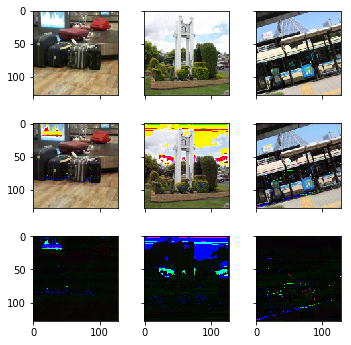


Epoch :  88 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1647770	 | Time     : 263.556861 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0040040 |
Encoder   | Loss  :  0.0022431	 | Accuracy :  0.7806146 |
Decoder   | Loss  :  0.1472644	 | Accuracy :  0.7694570 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1480339	 | Time     :  20.028158 |
Encoder   | Loss  :  0.0025426	 | Accuracy :  0.7949799 |
Decoder   | Loss  :  0.1462540	 | Accuracy :  0.7665161 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0411647 |


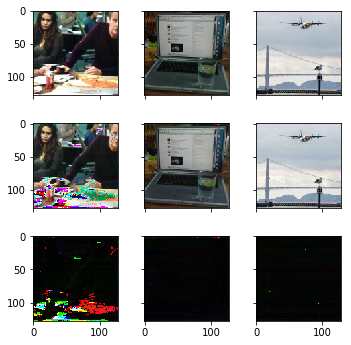


Epoch :  89 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1638955	 | Time     : 263.653633 |
Adversary | Loss  :  0.0003698	 | Accuracy :  0.0133258 |
Encoder   | Loss  :  0.0022144	 | Accuracy :  0.7776726 |
Decoder   | Loss  :  0.1464046	 | Accuracy :  0.7712296 |
Adversary | Loss  : 15.9407377	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1471142	 | Time     :  20.067509 |
Encoder   | Loss  :  0.0019305	 | Accuracy :  0.7956111 |
Decoder   | Loss  :  0.1457628	 | Accuracy :  0.7684070 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0215863 |


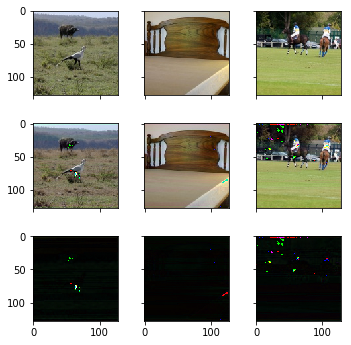


Epoch :  90 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1632410	 | Time     : 264.634197 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0010636 |
Encoder   | Loss  :  0.0021842	 | Accuracy :  0.7792680 |
Decoder   | Loss  :  0.1457697	 | Accuracy :  0.7718968 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1517752	 | Time     :  20.090840 |
Encoder   | Loss  :  0.0064702	 | Accuracy :  0.7635740 |
Decoder   | Loss  :  0.1472461	 | Accuracy :  0.7664826 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0015060 |


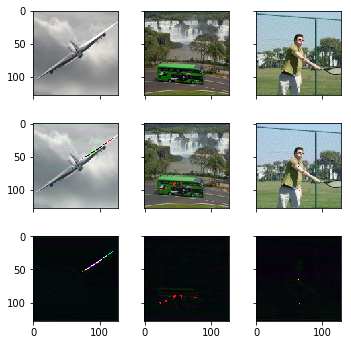


Epoch :  91 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1623489	 | Time     : 263.674227 |
Adversary | Loss  :  0.0025599	 | Accuracy :  0.0183308 |
Encoder   | Loss  :  0.0021766	 | Accuracy :  0.7816914 |
Decoder   | Loss  :  0.1449066	 | Accuracy :  0.7737196 |
Adversary | Loss  : 15.9186840	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1474817	 | Time     :  20.188213 |
Encoder   | Loss  :  0.0021797	 | Accuracy :  0.7760418 |
Decoder   | Loss  :  0.1459559	 | Accuracy :  0.7679384 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0130522 |


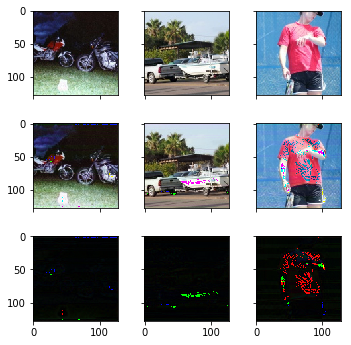


Epoch :  92 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1620631	 | Time     : 264.087970 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0015641 |
Encoder   | Loss  :  0.0020607	 | Accuracy :  0.7818665 |
Decoder   | Loss  :  0.1446782	 | Accuracy :  0.7734610 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1459533	 | Time     :  20.234760 |
Encoder   | Loss  :  0.0021670	 | Accuracy :  0.7724998 |
Decoder   | Loss  :  0.1444363	 | Accuracy :  0.7692437 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0175703 |


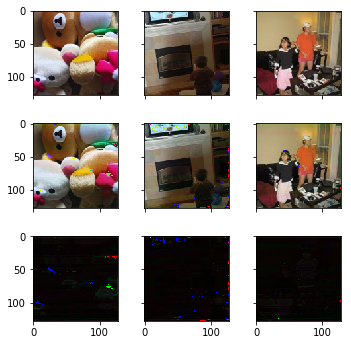


Epoch :  93 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1613036	 | Time     : 264.546140 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0008759 |
Encoder   | Loss  :  0.0020325	 | Accuracy :  0.7835761 |
Decoder   | Loss  :  0.1439384	 | Accuracy :  0.7744119 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1460018	 | Time     :  20.028211 |
Encoder   | Loss  :  0.0018756	 | Accuracy :  0.7629055 |
Decoder   | Loss  :  0.1446889	 | Accuracy :  0.7681559 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0145582 |


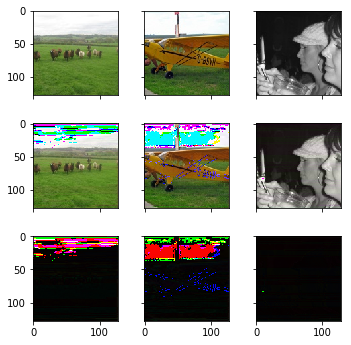


Epoch :  94 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1608579	 | Time     : 264.195227 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0007508 |
Encoder   | Loss  :  0.0019605	 | Accuracy :  0.7828184 |
Decoder   | Loss  :  0.1435431	 | Accuracy :  0.7759218 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1446119	 | Time     :  20.076009 |
Encoder   | Loss  :  0.0011021	 | Accuracy :  0.8058270 |
Decoder   | Loss  :  0.1438405	 | Accuracy :  0.7703815 |
Adversary | Loss  :  0.0000088	 | Accuracy :  0.0547189 |


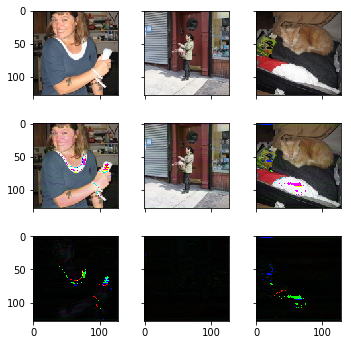


Epoch :  95 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1605024	 | Time     : 264.613886 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0011261 |
Encoder   | Loss  :  0.0020452	 | Accuracy :  0.7854440 |
Decoder   | Loss  :  0.1431283	 | Accuracy :  0.7773566 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1446700	 | Time     :  19.793833 |
Encoder   | Loss  :  0.0014505	 | Accuracy :  0.7756355 |
Decoder   | Loss  :  0.1436545	 | Accuracy :  0.7711512 |
Adversary | Loss  :  0.0001489	 | Accuracy :  0.0542169 |


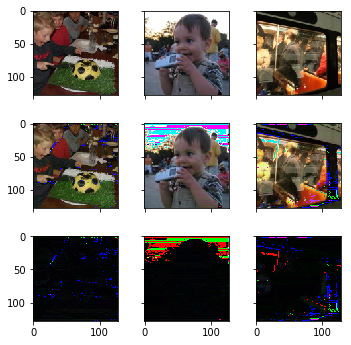


Epoch :  96 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1602280	 | Time     : 263.757231 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0012513 |
Encoder   | Loss  :  0.0020092	 | Accuracy :  0.7827017 |
Decoder   | Loss  :  0.1428791	 | Accuracy :  0.7774191 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1454661	 | Time     :  20.136581 |
Encoder   | Loss  :  0.0018268	 | Accuracy :  0.8172271 |
Decoder   | Loss  :  0.1441873	 | Accuracy :  0.7694109 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0080321 |


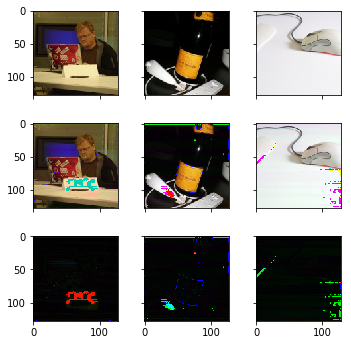


Epoch :  97 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1598045	 | Time     : 264.023060 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0011887 |
Encoder   | Loss  :  0.0020946	 | Accuracy :  0.7862628 |
Decoder   | Loss  :  0.1423959	 | Accuracy :  0.7785910 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1435738	 | Time     :  20.213171 |
Encoder   | Loss  :  0.0011882	 | Accuracy :  0.7850213 |
Decoder   | Loss  :  0.1427421	 | Accuracy :  0.7736949 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0225904 |


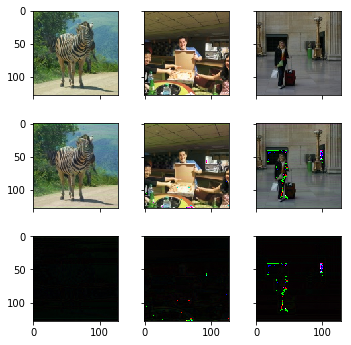


Epoch :  98 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1590753	 | Time     : 264.076163 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0018143 |
Encoder   | Loss  :  0.0019273	 | Accuracy :  0.7853337 |
Decoder   | Loss  :  0.1417837	 | Accuracy :  0.7802386 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1494067	 | Time     :  19.885727 |
Encoder   | Loss  :  0.0018303	 | Accuracy :  0.7924262 |
Decoder   | Loss  :  0.1481255	 | Accuracy :  0.7599230 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0125502 |


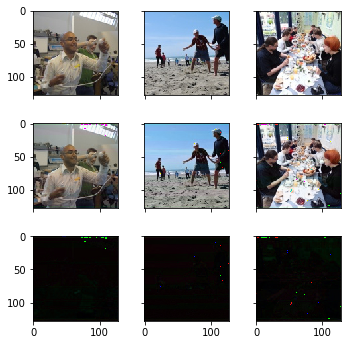


Epoch :  99 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1586440	 | Time     : 264.138159 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0011261 |
Encoder   | Loss  :  0.0020093	 | Accuracy :  0.7832384 |
Decoder   | Loss  :  0.1412951	 | Accuracy :  0.7822238 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1449036	 | Time     :  19.996910 |
Encoder   | Loss  :  0.0030852	 | Accuracy :  0.7481905 |
Decoder   | Loss  :  0.1427437	 | Accuracy :  0.7758701 |
Adversary | Loss  :  0.0002429	 | Accuracy :  0.0838353 |


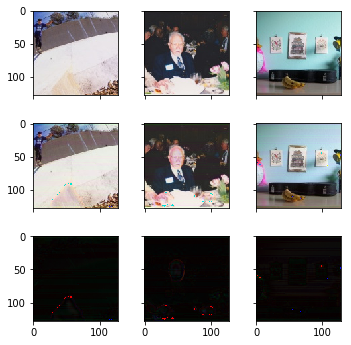


Epoch :  100 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1579024	 | Time     : 264.233431 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0013764 |
Encoder   | Loss  :  0.0019377	 | Accuracy :  0.7836745 |
Decoder   | Loss  :  0.1406037	 | Accuracy :  0.7835001 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1428587	 | Time     :  20.134308 |
Encoder   | Loss  :  0.0017142	 | Accuracy :  0.7917816 |
Decoder   | Loss  :  0.1416588	 | Accuracy :  0.7794176 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0893574 |


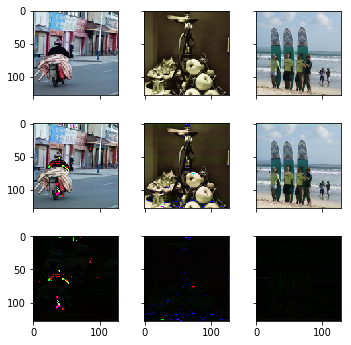


Epoch :  101 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1572237	 | Time     : 264.699920 |
Adversary | Loss  :  0.0000719	 | Accuracy :  0.0055055 |
Encoder   | Loss  :  0.0018811	 | Accuracy :  0.7850903 |
Decoder   | Loss  :  0.1399659	 | Accuracy :  0.7850475 |
Adversary | Loss  : 15.9409838	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1411356	 | Time     :  20.008862 |
Encoder   | Loss  :  0.0018420	 | Accuracy :  0.7809713 |
Decoder   | Loss  :  0.1398462	 | Accuracy :  0.7810408 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0060241 |


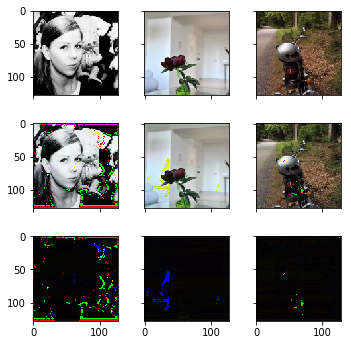


Epoch :  102 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1569174	 | Time     : 264.281927 |
Adversary | Loss  :  0.0024825	 | Accuracy :  0.0109484 |
Encoder   | Loss  :  0.0019743	 | Accuracy :  0.7854875 |
Decoder   | Loss  :  0.1395947	 | Accuracy :  0.7867993 |
Adversary | Loss  : 15.9406910	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1438911	 | Time     :  20.012830 |
Encoder   | Loss  :  0.0019627	 | Accuracy :  0.8033803 |
Decoder   | Loss  :  0.1425172	 | Accuracy :  0.7821453 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0090361 |


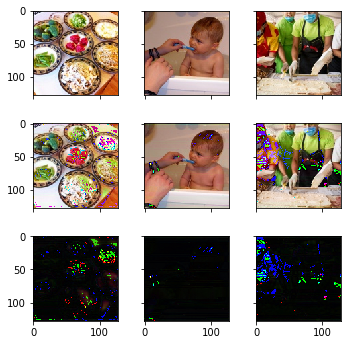


Epoch :  103 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1560558	 | Time     : 264.798777 |
Adversary | Loss  :  0.0003517	 | Accuracy :  0.0057558 |
Encoder   | Loss  :  0.0019934	 | Accuracy :  0.7858254 |
Decoder   | Loss  :  0.1387196	 | Accuracy :  0.7896563 |
Adversary | Loss  : 15.9408607	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1396501	 | Time     :  20.071434 |
Encoder   | Loss  :  0.0014156	 | Accuracy :  0.7718979 |
Decoder   | Loss  :  0.1386591	 | Accuracy :  0.7850401 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0145582 |


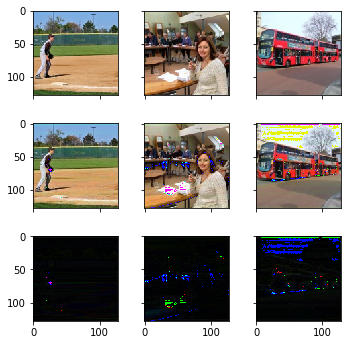


Epoch :  104 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1551952	 | Time     : 265.311258 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000626 |
Encoder   | Loss  :  0.0019322	 | Accuracy :  0.7851673 |
Decoder   | Loss  :  0.1379003	 | Accuracy :  0.7914497 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1392400	 | Time     :  19.968530 |
Encoder   | Loss  :  0.0016018	 | Accuracy :  0.7981902 |
Decoder   | Loss  :  0.1381188	 | Accuracy :  0.7865628 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


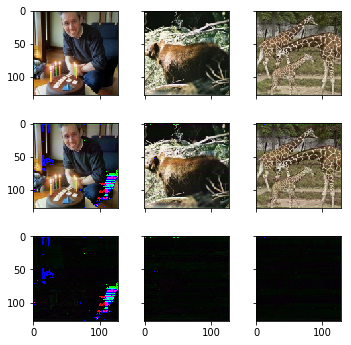


Epoch :  105 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1543992	 | Time     : 264.270605 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000626 |
Encoder   | Loss  :  0.0019170	 | Accuracy :  0.7816314 |
Decoder   | Loss  :  0.1371149	 | Accuracy :  0.7938398 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1397944	 | Time     :  20.199978 |
Encoder   | Loss  :  0.0018037	 | Accuracy :  0.7787047 |
Decoder   | Loss  :  0.1385318	 | Accuracy :  0.7899431 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0030120 |


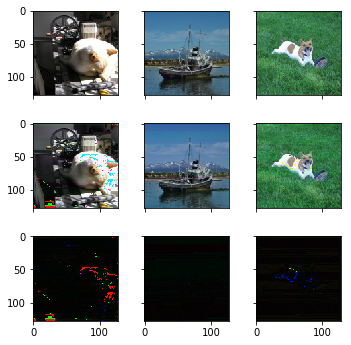


Epoch :  106 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1533240	 | Time     : 263.894446 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000626 |
Encoder   | Loss  :  0.0019004	 | Accuracy :  0.7819813 |
Decoder   | Loss  :  0.1360514	 | Accuracy :  0.7971305 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1395962	 | Time     :  20.053625 |
Encoder   | Loss  :  0.0020656	 | Accuracy :  0.7743306 |
Decoder   | Loss  :  0.1381502	 | Accuracy :  0.7895248 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


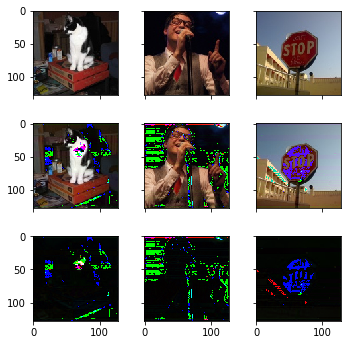


Epoch :  107 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1524272	 | Time     : 264.698527 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0001251 |
Encoder   | Loss  :  0.0020209	 | Accuracy :  0.7833303 |
Decoder   | Loss  :  0.1350701	 | Accuracy :  0.8007007 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1395337	 | Time     :  20.215724 |
Encoder   | Loss  :  0.0017636	 | Accuracy :  0.8109072 |
Decoder   | Loss  :  0.1382992	 | Accuracy :  0.7936747 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0010040 |


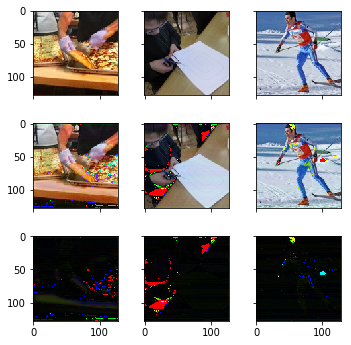


Epoch :  108 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1515325	 | Time     : 264.311743 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0001251 |
Encoder   | Loss  :  0.0019085	 | Accuracy :  0.7805732 |
Decoder   | Loss  :  0.1342542	 | Accuracy :  0.8030363 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1369486	 | Time     :  19.981979 |
Encoder   | Loss  :  0.0014411	 | Accuracy :  0.7857705 |
Decoder   | Loss  :  0.1359398	 | Accuracy :  0.7968708 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


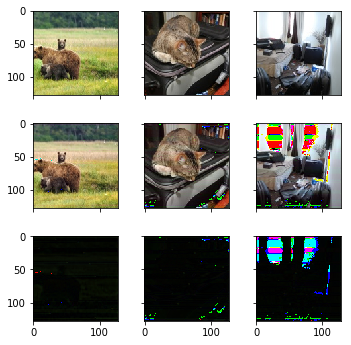


Epoch :  109 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1506446	 | Time     : 264.387342 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000626 |
Encoder   | Loss  :  0.0019687	 | Accuracy :  0.7818749 |
Decoder   | Loss  :  0.1333241	 | Accuracy :  0.8059852 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1346318	 | Time     :  20.037139 |
Encoder   | Loss  :  0.0017289	 | Accuracy :  0.8026968 |
Decoder   | Loss  :  0.1334216	 | Accuracy :  0.8004686 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


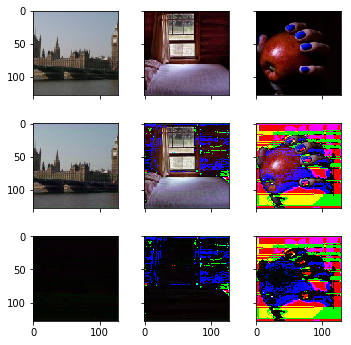


Epoch :  110 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1497004	 | Time     : 263.738439 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000626 |
Encoder   | Loss  :  0.0018975	 | Accuracy :  0.7848195 |
Decoder   | Loss  :  0.1324298	 | Accuracy :  0.8077911 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1343603	 | Time     :  20.209812 |
Encoder   | Loss  :  0.0014511	 | Accuracy :  0.7810194 |
Decoder   | Loss  :  0.1333445	 | Accuracy :  0.7992805 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


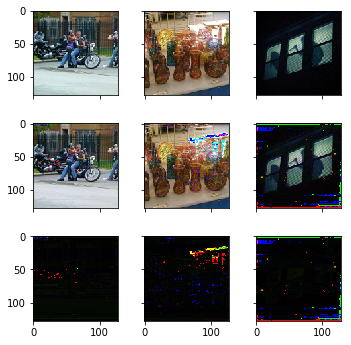


Epoch :  111 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1485574	 | Time     : 264.985987 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |
Encoder   | Loss  :  0.0018771	 | Accuracy :  0.7829791 |
Decoder   | Loss  :  0.1313011	 | Accuracy :  0.8097640 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1343338	 | Time     :  19.912669 |
Encoder   | Loss  :  0.0013887	 | Accuracy :  0.7838960 |
Decoder   | Loss  :  0.1333617	 | Accuracy :  0.8005689 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


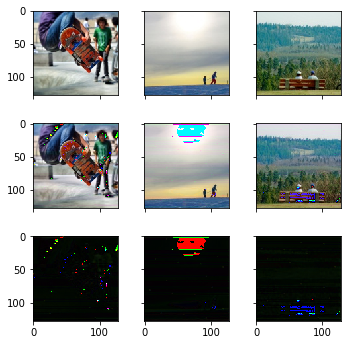


Epoch :  112 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1475484	 | Time     : 265.770352 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0001251 |
Encoder   | Loss  :  0.0018955	 | Accuracy :  0.7816072 |
Decoder   | Loss  :  0.1302792	 | Accuracy :  0.8125876 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1353571	 | Time     :  20.164253 |
Encoder   | Loss  :  0.0039570	 | Accuracy :  0.8051543 |
Decoder   | Loss  :  0.1325871	 | Accuracy :  0.8023428 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


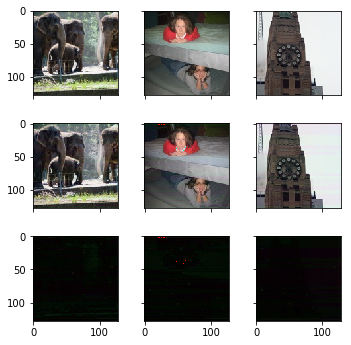


Epoch :  113 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1468222	 | Time     : 264.044820 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0001877 |
Encoder   | Loss  :  0.0019314	 | Accuracy :  0.7787049 |
Decoder   | Loss  :  0.1295278	 | Accuracy :  0.8142059 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1310316	 | Time     :  20.317525 |
Encoder   | Loss  :  0.0021831	 | Accuracy :  0.7473794 |
Decoder   | Loss  :  0.1295035	 | Accuracy :  0.8114124 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


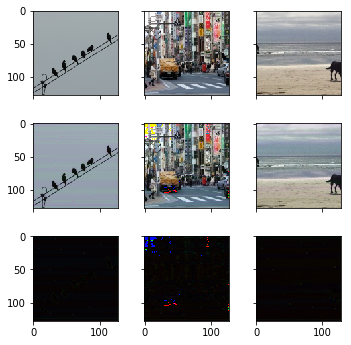


Epoch :  114 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1459168	 | Time     : 264.417562 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0001877 |
Encoder   | Loss  :  0.0019071	 | Accuracy :  0.7822421 |
Decoder   | Loss  :  0.1286394	 | Accuracy :  0.8171588 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1304835	 | Time     :  20.443790 |
Encoder   | Loss  :  0.0018714	 | Accuracy :  0.7856903 |
Decoder   | Loss  :  0.1291735	 | Accuracy :  0.8116633 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0005020 |


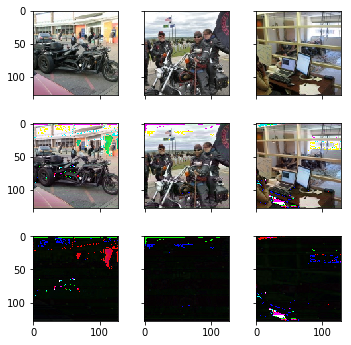


Epoch :  115 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1448406	 | Time     : 264.419876 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0001251 |
Encoder   | Loss  :  0.0018534	 | Accuracy :  0.7846088 |
Decoder   | Loss  :  0.1276009	 | Accuracy :  0.8186937 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1319904	 | Time     :  20.207864 |
Encoder   | Loss  :  0.0031159	 | Accuracy :  0.7561562 |
Decoder   | Loss  :  0.1298093	 | Accuracy :  0.8112284 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


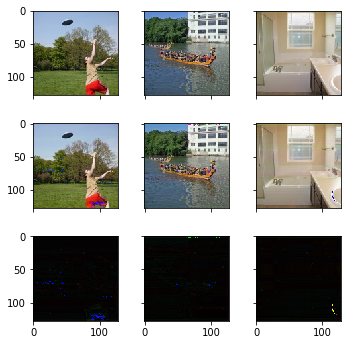


Epoch :  116 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1438897	 | Time     : 264.925363 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0001877 |
Encoder   | Loss  :  0.0019382	 | Accuracy :  0.7807885 |
Decoder   | Loss  :  0.1265905	 | Accuracy :  0.8212379 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1304727	 | Time     :  19.999194 |
Encoder   | Loss  :  0.0018761	 | Accuracy :  0.7493914 |
Decoder   | Loss  :  0.1291594	 | Accuracy :  0.8104919 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


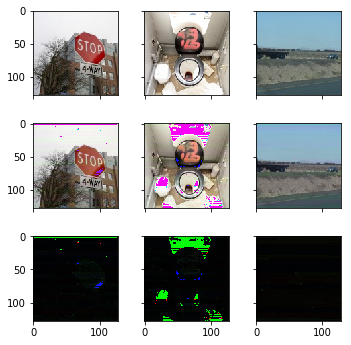


Epoch :  117 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1431705	 | Time     : 264.075598 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0001877 |
Encoder   | Loss  :  0.0018587	 | Accuracy :  0.7809475 |
Decoder   | Loss  :  0.1259271	 | Accuracy :  0.8220636 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1293833	 | Time     :  20.251831 |
Encoder   | Loss  :  0.0020214	 | Accuracy :  0.7694703 |
Decoder   | Loss  :  0.1279684	 | Accuracy :  0.8106761 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


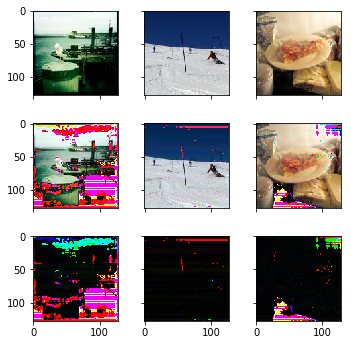


Epoch :  118 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1424187	 | Time     : 264.166290 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0002503 |
Encoder   | Loss  :  0.0019859	 | Accuracy :  0.7818281 |
Decoder   | Loss  :  0.1250862	 | Accuracy :  0.8235986 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1283001	 | Time     :  20.322528 |
Encoder   | Loss  :  0.0018750	 | Accuracy :  0.8095352 |
Decoder   | Loss  :  0.1269876	 | Accuracy :  0.8163654 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


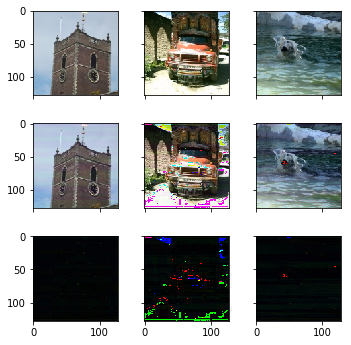


Epoch :  119 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1416639	 | Time     : 264.797412 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000626 |
Encoder   | Loss  :  0.0019367	 | Accuracy :  0.7820646 |
Decoder   | Loss  :  0.1243658	 | Accuracy :  0.8245412 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1274974	 | Time     :  20.232613 |
Encoder   | Loss  :  0.0018385	 | Accuracy :  0.7595881 |
Decoder   | Loss  :  0.1262105	 | Accuracy :  0.8154953 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


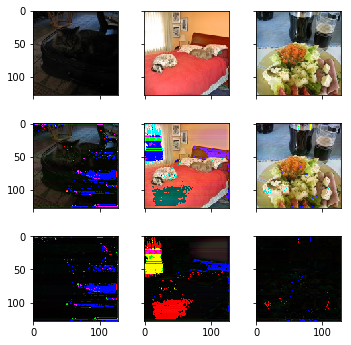


Epoch :  120 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1410190	 | Time     : 264.909789 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0003128 |
Encoder   | Loss  :  0.0018941	 | Accuracy :  0.7803773 |
Decoder   | Loss  :  0.1237508	 | Accuracy :  0.8267018 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1297320	 | Time     :  20.207452 |
Encoder   | Loss  :  0.0050313	 | Accuracy :  0.8098308 |
Decoder   | Loss  :  0.1262101	 | Accuracy :  0.8168172 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


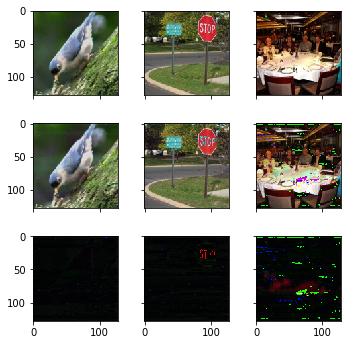


Epoch :  121 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1401725	 | Time     : 264.242150 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |
Encoder   | Loss  :  0.0018848	 | Accuracy :  0.7813987 |
Decoder   | Loss  :  0.1229107	 | Accuracy :  0.8274483 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1253777	 | Time     :  20.301160 |
Encoder   | Loss  :  0.0012335	 | Accuracy :  0.7942717 |
Decoder   | Loss  :  0.1245143	 | Accuracy :  0.8199297 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


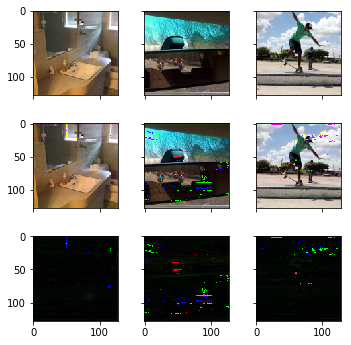


Epoch :  122 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1396856	 | Time     : 265.003204 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0001877 |
Encoder   | Loss  :  0.0018816	 | Accuracy :  0.7839872 |
Decoder   | Loss  :  0.1224260	 | Accuracy :  0.8281073 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1250746	 | Time     :  20.315654 |
Encoder   | Loss  :  0.0012769	 | Accuracy :  0.7851861 |
Decoder   | Loss  :  0.1241808	 | Accuracy :  0.8181057 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


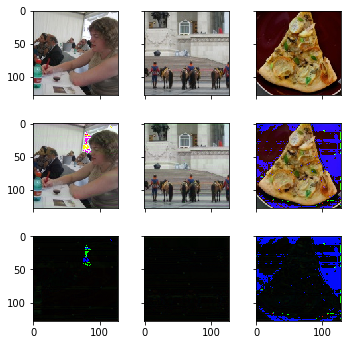


Epoch :  123 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1387745	 | Time     : 264.852495 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0001251 |
Encoder   | Loss  :  0.0018340	 | Accuracy :  0.7830248 |
Decoder   | Loss  :  0.1215484	 | Accuracy :  0.8304888 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1234416	 | Time     :  20.065662 |
Encoder   | Loss  :  0.0014910	 | Accuracy :  0.8129958 |
Decoder   | Loss  :  0.1223979	 | Accuracy :  0.8252677 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


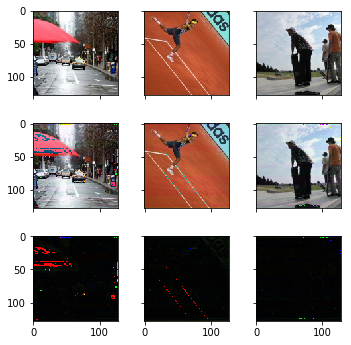


Epoch :  124 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1380652	 | Time     : 264.494097 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |
Encoder   | Loss  :  0.0019231	 | Accuracy :  0.7819459 |
Decoder   | Loss  :  0.1207766	 | Accuracy :  0.8310686 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1236726	 | Time     :  19.871407 |
Encoder   | Loss  :  0.0015345	 | Accuracy :  0.8085138 |
Decoder   | Loss  :  0.1225985	 | Accuracy :  0.8225735 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


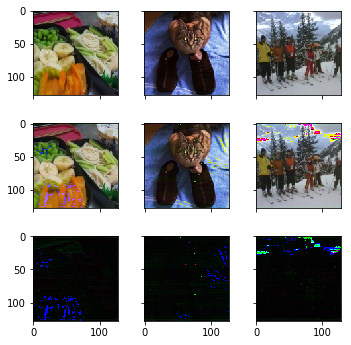


Epoch :  125 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1374406	 | Time     : 264.520110 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0002503 |
Encoder   | Loss  :  0.0018459	 | Accuracy :  0.7814859 |
Decoder   | Loss  :  0.1202061	 | Accuracy :  0.8319152 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1245072	 | Time     :  20.032835 |
Encoder   | Loss  :  0.0017263	 | Accuracy :  0.7784345 |
Decoder   | Loss  :  0.1232989	 | Accuracy :  0.8204485 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


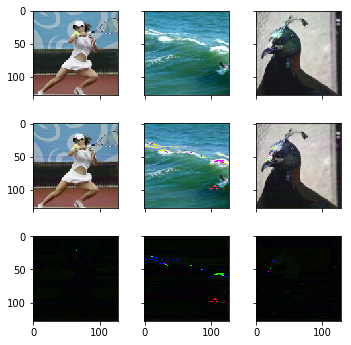


Epoch :  126 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1367126	 | Time     : 263.501733 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0001877 |
Encoder   | Loss  :  0.0018321	 | Accuracy :  0.7823994 |
Decoder   | Loss  :  0.1194877	 | Accuracy :  0.8331206 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1243052	 | Time     :  20.181714 |
Encoder   | Loss  :  0.0035558	 | Accuracy :  0.7824810 |
Decoder   | Loss  :  0.1218161	 | Accuracy :  0.8237115 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


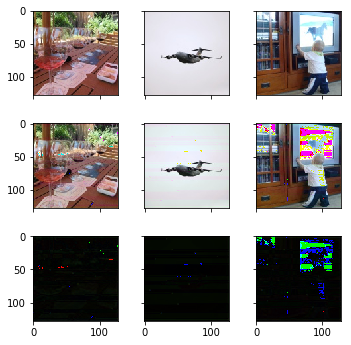


Epoch :  127 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1362265	 | Time     : 264.660963 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000626 |
Encoder   | Loss  :  0.0019296	 | Accuracy :  0.7813404 |
Decoder   | Loss  :  0.1189334	 | Accuracy :  0.8341675 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1260345	 | Time     :  20.120859 |
Encoder   | Loss  :  0.0065181	 | Accuracy :  0.7812662 |
Decoder   | Loss  :  0.1214719	 | Accuracy :  0.8251507 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


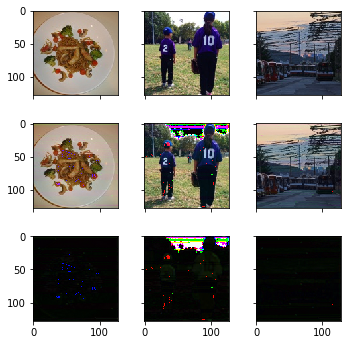


Epoch :  128 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1355465	 | Time     : 263.661445 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |
Encoder   | Loss  :  0.0018492	 | Accuracy :  0.7805256 |
Decoder   | Loss  :  0.1183097	 | Accuracy :  0.8357024 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1227558	 | Time     :  19.901262 |
Encoder   | Loss  :  0.0017985	 | Accuracy :  0.7632042 |
Decoder   | Loss  :  0.1214969	 | Accuracy :  0.8248326 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


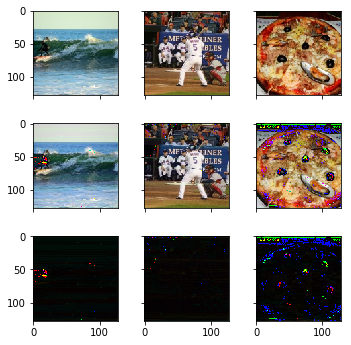


Epoch :  129 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1349049	 | Time     : 264.193681 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000626 |
Encoder   | Loss  :  0.0017982	 | Accuracy :  0.7814789 |
Decoder   | Loss  :  0.1177037	 | Accuracy :  0.8364657 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1208110	 | Time     :  20.101675 |
Encoder   | Loss  :  0.0016495	 | Accuracy :  0.8084140 |
Decoder   | Loss  :  0.1196563	 | Accuracy :  0.8279451 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


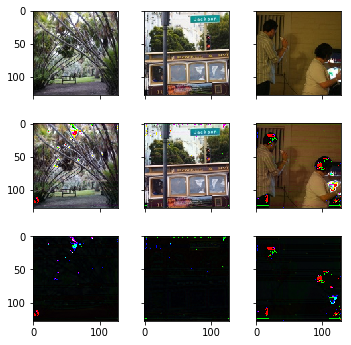


Epoch :  130 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1342162	 | Time     : 263.620645 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |
Encoder   | Loss  :  0.0018589	 | Accuracy :  0.7831581 |
Decoder   | Loss  :  0.1169726	 | Accuracy :  0.8375626 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1239629	 | Time     :  20.235141 |
Encoder   | Loss  :  0.0029972	 | Accuracy :  0.7832664 |
Decoder   | Loss  :  0.1218649	 | Accuracy :  0.8224567 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


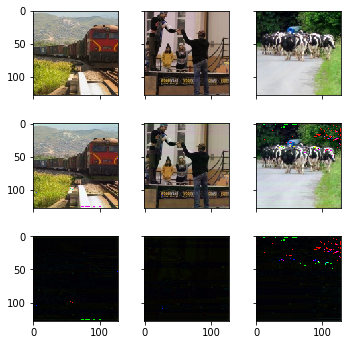


Epoch :  131 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1337283	 | Time     : 264.491676 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000626 |
Encoder   | Loss  :  0.0019133	 | Accuracy :  0.7806891 |
Decoder   | Loss  :  0.1164466	 | Accuracy :  0.8384467 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1202690	 | Time     :  20.260816 |
Encoder   | Loss  :  0.0015727	 | Accuracy :  0.7975444 |
Decoder   | Loss  :  0.1191681	 | Accuracy :  0.8274599 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


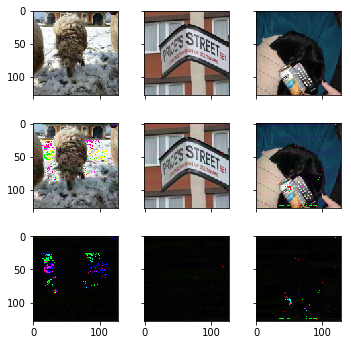


Epoch :  132 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1330253	 | Time     : 264.237792 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0002503 |
Encoder   | Loss  :  0.0018975	 | Accuracy :  0.7805105 |
Decoder   | Loss  :  0.1157547	 | Accuracy :  0.8390181 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1203509	 | Time     :  20.073325 |
Encoder   | Loss  :  0.0016596	 | Accuracy :  0.7779762 |
Decoder   | Loss  :  0.1191891	 | Accuracy :  0.8268407 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


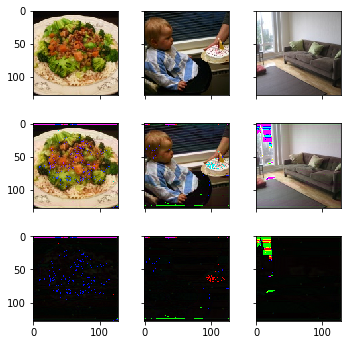


Epoch :  133 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1324546	 | Time     : 263.859550 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000626 |
Encoder   | Loss  :  0.0018153	 | Accuracy :  0.7808951 |
Decoder   | Loss  :  0.1152414	 | Accuracy :  0.8400943 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1563237	 | Time     :  20.232228 |
Encoder   | Loss  :  0.0176908	 | Accuracy :  0.7901157 |
Decoder   | Loss  :  0.1439401	 | Accuracy :  0.8194278 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


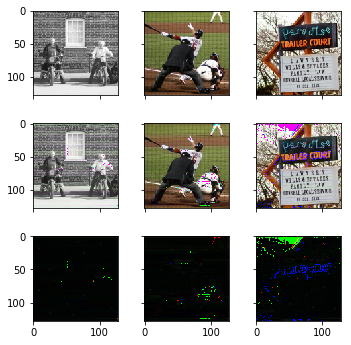


Epoch :  134 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1326792	 | Time     : 264.650009 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0001877 |
Encoder   | Loss  :  0.0030643	 | Accuracy :  0.7797951 |
Decoder   | Loss  :  0.1145918	 | Accuracy :  0.8414831 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1195369	 | Time     :  20.029520 |
Encoder   | Loss  :  0.0026286	 | Accuracy :  0.7508018 |
Decoder   | Loss  :  0.1176969	 | Accuracy :  0.8319947 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


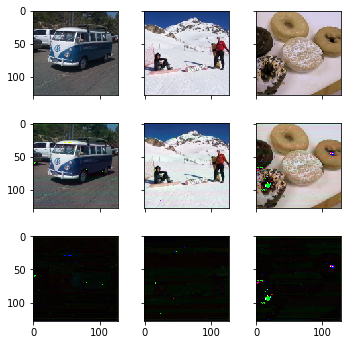


Epoch :  135 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1314846	 | Time     : 264.819857 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000626 |
Encoder   | Loss  :  0.0020592	 | Accuracy :  0.7809117 |
Decoder   | Loss  :  0.1141007	 | Accuracy :  0.8421338 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1190971	 | Time     :  20.235476 |
Encoder   | Loss  :  0.0029008	 | Accuracy :  0.8152552 |
Decoder   | Loss  :  0.1170665	 | Accuracy :  0.8310742 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


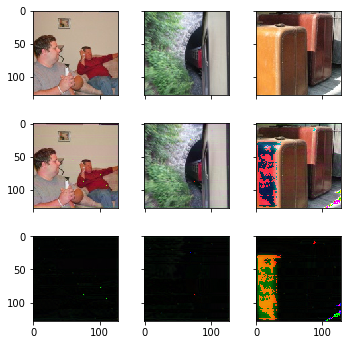


Epoch :  136 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1305541	 | Time     : 263.878749 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0001251 |
Encoder   | Loss  :  0.0018434	 | Accuracy :  0.7828666 |
Decoder   | Loss  :  0.1133213	 | Accuracy :  0.8432266 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1191425	 | Time     :  19.828228 |
Encoder   | Loss  :  0.0015943	 | Accuracy :  0.8018798 |
Decoder   | Loss  :  0.1180264	 | Accuracy :  0.8295849 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


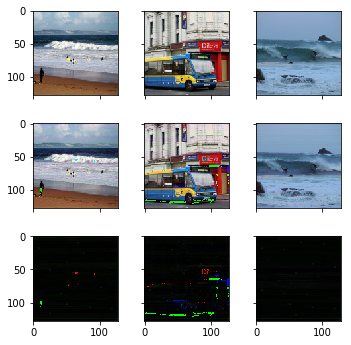


Epoch :  137 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1298796	 | Time     : 270.158868 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000626 |
Encoder   | Loss  :  0.0018723	 | Accuracy :  0.7820658 |
Decoder   | Loss  :  0.1126266	 | Accuracy :  0.8442442 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1185867	 | Time     :  20.046662 |
Encoder   | Loss  :  0.0029323	 | Accuracy :  0.7608289 |
Decoder   | Loss  :  0.1165341	 | Accuracy :  0.8336847 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0005020 |


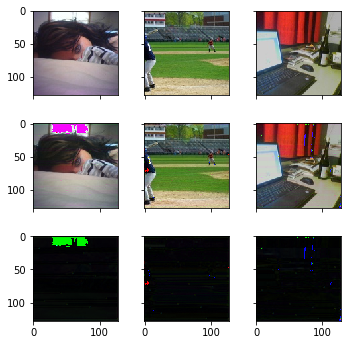


Epoch :  138 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1292440	 | Time     : 265.077945 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0001251 |
Encoder   | Loss  :  0.0018414	 | Accuracy :  0.7824647 |
Decoder   | Loss  :  0.1120127	 | Accuracy :  0.8455497 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1166709	 | Time     :  19.952953 |
Encoder   | Loss  :  0.0027044	 | Accuracy :  0.7984495 |
Decoder   | Loss  :  0.1147778	 | Accuracy :  0.8355253 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


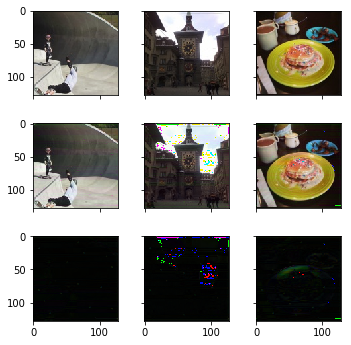


Epoch :  139 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1285286	 | Time     : 264.812292 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0001877 |
Encoder   | Loss  :  0.0018318	 | Accuracy :  0.7817158 |
Decoder   | Loss  :  0.1113040	 | Accuracy :  0.8462963 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1181735	 | Time     :  19.874762 |
Encoder   | Loss  :  0.0035930	 | Accuracy :  0.7797153 |
Decoder   | Loss  :  0.1156583	 | Accuracy :  0.8320616 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


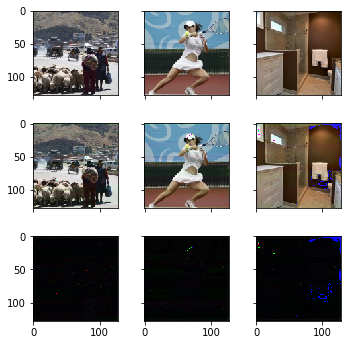


Epoch :  140 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1276520	 | Time     : 264.499791 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0008133 |
Encoder   | Loss  :  0.0017889	 | Accuracy :  0.7824071 |
Decoder   | Loss  :  0.1104573	 | Accuracy :  0.8472222 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1163877	 | Time     :  20.140682 |
Encoder   | Loss  :  0.0013804	 | Accuracy :  0.8067947 |
Decoder   | Loss  :  0.1154215	 | Accuracy :  0.8308902 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0015060 |


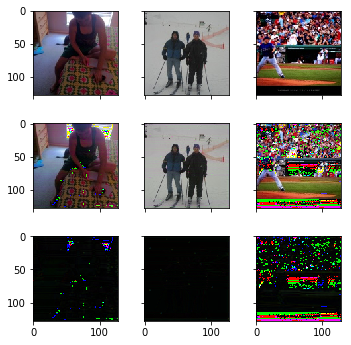


Epoch :  141 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1266942	 | Time     : 270.267185 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0001877 |
Encoder   | Loss  :  0.0018073	 | Accuracy :  0.7851007 |
Decoder   | Loss  :  0.1094867	 | Accuracy :  0.8494787 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1144801	 | Time     :  20.297100 |
Encoder   | Loss  :  0.0017897	 | Accuracy :  0.7636116 |
Decoder   | Loss  :  0.1132274	 | Accuracy :  0.8374832 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


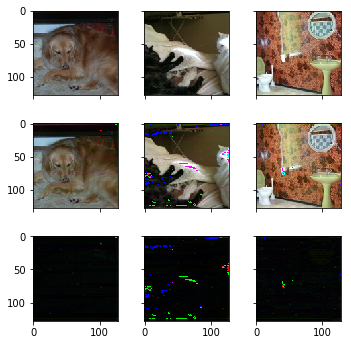


Epoch :  142 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1252028	 | Time     : 265.874110 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0001251 |
Encoder   | Loss  :  0.0019256	 | Accuracy :  0.7816365 |
Decoder   | Loss  :  0.1079125	 | Accuracy :  0.8522397 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1134347	 | Time     :  19.860793 |
Encoder   | Loss  :  0.0019952	 | Accuracy :  0.7809144 |
Decoder   | Loss  :  0.1120381	 | Accuracy :  0.8392569 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


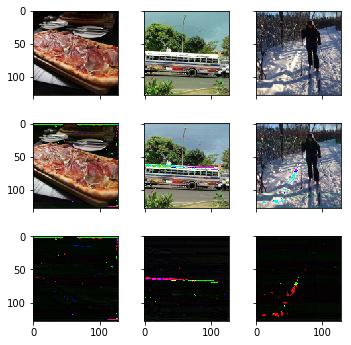


Epoch :  143 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1235837	 | Time     : 265.343493 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0001877 |
Encoder   | Loss  :  0.0019657	 | Accuracy :  0.7822999 |
Decoder   | Loss  :  0.1062653	 | Accuracy :  0.8561521 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1085541	 | Time     :  20.078142 |
Encoder   | Loss  :  0.0016959	 | Accuracy :  0.7680205 |
Decoder   | Loss  :  0.1073669	 | Accuracy :  0.8476071 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


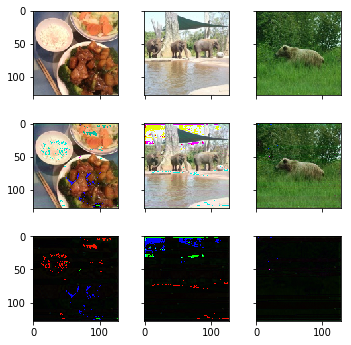


Epoch :  144 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1220197	 | Time     : 265.327939 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0005005 |
Encoder   | Loss  :  0.0020966	 | Accuracy :  0.7768975 |
Decoder   | Loss  :  0.1046097	 | Accuracy :  0.8578329 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1062985	 | Time     :  19.984166 |
Encoder   | Loss  :  0.0015589	 | Accuracy :  0.7666487 |
Decoder   | Loss  :  0.1052073	 | Accuracy :  0.8530623 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


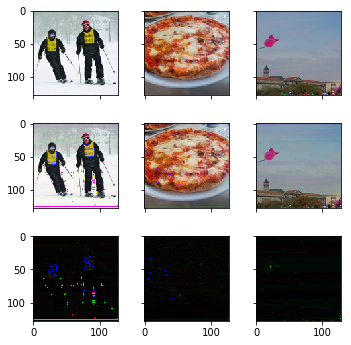


Epoch :  145 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1195669	 | Time     : 264.661094 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0003128 |
Encoder   | Loss  :  0.0020195	 | Accuracy :  0.7784581 |
Decoder   | Loss  :  0.1022109	 | Accuracy :  0.8627961 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1080523	 | Time     :  20.134744 |
Encoder   | Loss  :  0.0020294	 | Accuracy :  0.7778066 |
Decoder   | Loss  :  0.1066318	 | Accuracy :  0.8524933 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


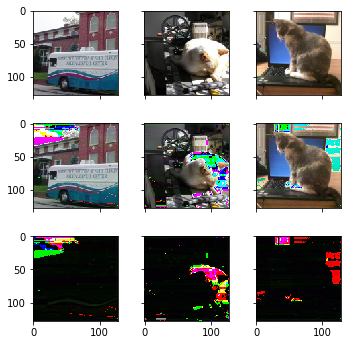


Epoch :  146 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1167923	 | Time     : 266.667493 |
Adversary | Loss  :  0.0017175	 | Accuracy :  0.0039414 |
Encoder   | Loss  :  0.0019982	 | Accuracy :  0.7788785 |
Decoder   | Loss  :  0.0994512	 | Accuracy :  0.8682057 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1010817	 | Time     :  20.125957 |
Encoder   | Loss  :  0.0018026	 | Accuracy :  0.7639156 |
Decoder   | Loss  :  0.0998199	 | Accuracy :  0.8627007 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0005020 |


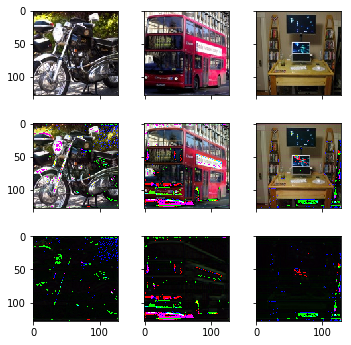


Epoch :  147 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1133159	 | Time     : 263.466076 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0004379 |
Encoder   | Loss  :  0.0020814	 | Accuracy :  0.7803292 |
Decoder   | Loss  :  0.0959166	 | Accuracy :  0.8739989 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0989585	 | Time     :  20.068987 |
Encoder   | Loss  :  0.0024029	 | Accuracy :  0.7973497 |
Decoder   | Loss  :  0.0972764	 | Accuracy :  0.8668005 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0015060 |


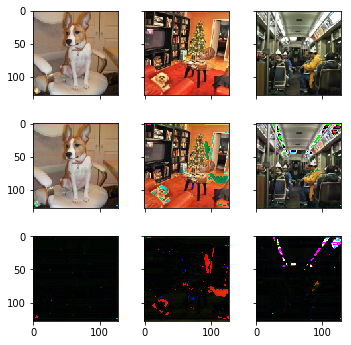


Epoch :  148 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1093875	 | Time     : 263.760454 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0002503 |
Encoder   | Loss  :  0.0021368	 | Accuracy :  0.7783760 |
Decoder   | Loss  :  0.0919493	 | Accuracy :  0.8799299 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0938951	 | Time     :  19.923382 |
Encoder   | Loss  :  0.0020827	 | Accuracy :  0.7857149 |
Decoder   | Loss  :  0.0924372	 | Accuracy :  0.8731593 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0015060 |


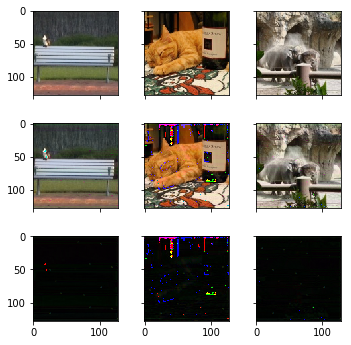


Epoch :  149 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1051479	 | Time     : 271.795435 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0004379 |
Encoder   | Loss  :  0.0021055	 | Accuracy :  0.7786114 |
Decoder   | Loss  :  0.0877317	 | Accuracy :  0.8868577 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0902858	 | Time     :  20.120420 |
Encoder   | Loss  :  0.0023805	 | Accuracy :  0.7851316 |
Decoder   | Loss  :  0.0886195	 | Accuracy :  0.8817771 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0005020 |


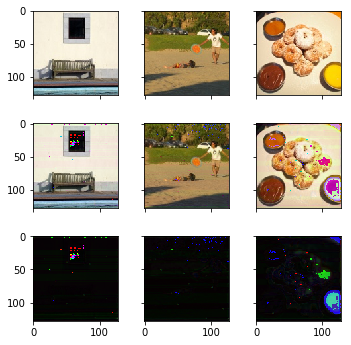


Epoch :  150 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1015479	 | Time     : 265.345994 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0003128 |
Encoder   | Loss  :  0.0020824	 | Accuracy :  0.7787007 |
Decoder   | Loss  :  0.0841478	 | Accuracy :  0.8916542 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0849171	 | Time     :  20.210083 |
Encoder   | Loss  :  0.0017985	 | Accuracy :  0.7480381 |
Decoder   | Loss  :  0.0836582	 | Accuracy :  0.8855422 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0015060 |


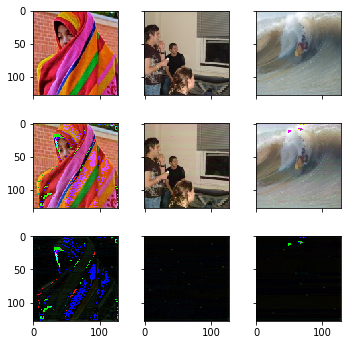


Epoch :  151 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0977772	 | Time     : 265.985230 |
Adversary | Loss  :  0.0001904	 | Accuracy :  0.0144520 |
Encoder   | Loss  :  0.0022593	 | Accuracy :  0.7762528 |
Decoder   | Loss  :  0.0802578	 | Accuracy :  0.8965089 |
Adversary | Loss  : 15.9378138	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0810207	 | Time     :  20.084553 |
Encoder   | Loss  :  0.0017413	 | Accuracy :  0.7803040 |
Decoder   | Loss  :  0.0798018	 | Accuracy :  0.8918173 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


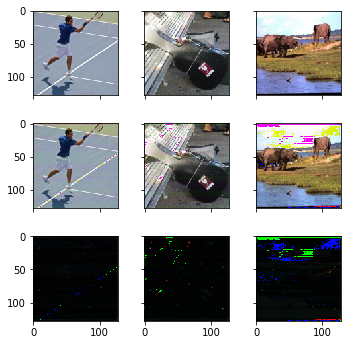


Epoch :  152 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0941658	 | Time     : 266.263221 |
Adversary | Loss  :  0.0000127	 | Accuracy :  0.0036912 |
Encoder   | Loss  :  0.0022819	 | Accuracy :  0.7765904 |
Decoder   | Loss  :  0.0766262	 | Accuracy :  0.9000792 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0799455	 | Time     :  19.952637 |
Encoder   | Loss  :  0.0023745	 | Accuracy :  0.8140264 |
Decoder   | Loss  :  0.0782834	 | Accuracy :  0.8948963 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


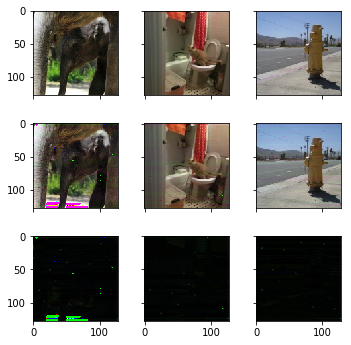


Epoch :  153 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0906777	 | Time     : 273.455994 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |
Encoder   | Loss  :  0.0022679	 | Accuracy :  0.7742568 |
Decoder   | Loss  :  0.0731478	 | Accuracy :  0.9034159 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0746667	 | Time     :  19.994938 |
Encoder   | Loss  :  0.0029735	 | Accuracy :  0.7295645 |
Decoder   | Loss  :  0.0725852	 | Accuracy :  0.8994310 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


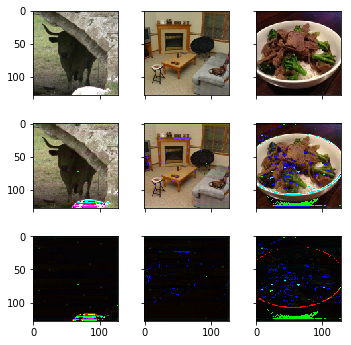


Epoch :  154 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0873164	 | Time     : 266.200604 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000626 |
Encoder   | Loss  :  0.0022534	 | Accuracy :  0.7749412 |
Decoder   | Loss  :  0.0697966	 | Accuracy :  0.9054973 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0820758	 | Time     :  20.061090 |
Encoder   | Loss  :  0.0107691	 | Accuracy :  0.7741376 |
Decoder   | Loss  :  0.0745374	 | Accuracy :  0.8960675 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


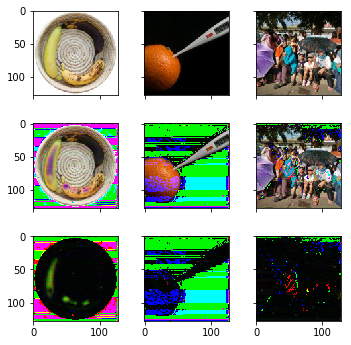


Epoch :  155 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0852168	 | Time     : 273.138857 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000626 |
Encoder   | Loss  :  0.0022969	 | Accuracy :  0.7768918 |
Decoder   | Loss  :  0.0676666	 | Accuracy :  0.9067776 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0696610	 | Time     :  19.919264 |
Encoder   | Loss  :  0.0017677	 | Accuracy :  0.7865918 |
Decoder   | Loss  :  0.0684236	 | Accuracy :  0.9052543 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


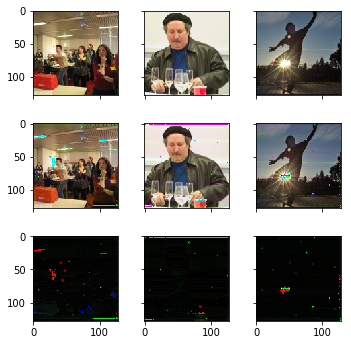


Epoch :  156 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0831765	 | Time     : 271.778156 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000626 |
Encoder   | Loss  :  0.0022085	 | Accuracy :  0.7800920 |
Decoder   | Loss  :  0.0656881	 | Accuracy :  0.9076868 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0685863	 | Time     :  20.117470 |
Encoder   | Loss  :  0.0024692	 | Accuracy :  0.7721473 |
Decoder   | Loss  :  0.0668579	 | Accuracy :  0.9025435 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


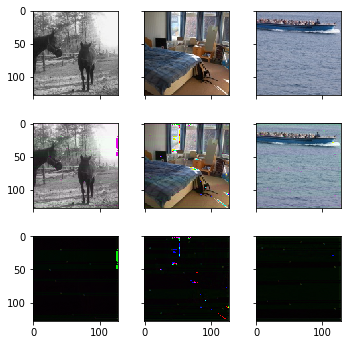


Epoch :  157 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0815872	 | Time     : 263.693960 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000626 |
Encoder   | Loss  :  0.0021531	 | Accuracy :  0.7814776 |
Decoder   | Loss  :  0.0641376	 | Accuracy :  0.9084126 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0667295	 | Time     :  19.919059 |
Encoder   | Loss  :  0.0021192	 | Accuracy :  0.7875363 |
Decoder   | Loss  :  0.0652460	 | Accuracy :  0.9047021 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


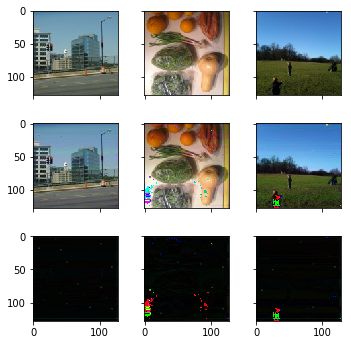


Epoch :  158 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0816914	 | Time     : 272.409516 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |
Encoder   | Loss  :  0.0030558	 | Accuracy :  0.7693866 |
Decoder   | Loss  :  0.0636100	 | Accuracy :  0.9080872 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0665343	 | Time     :  19.777459 |
Encoder   | Loss  :  0.0021337	 | Accuracy :  0.7975742 |
Decoder   | Loss  :  0.0650407	 | Accuracy :  0.9010208 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


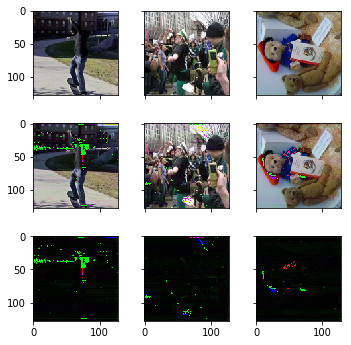


Epoch :  159 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0795418	 | Time     : 274.055148 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000626 |
Encoder   | Loss  :  0.0022719	 | Accuracy :  0.7772994 |
Decoder   | Loss  :  0.0620090	 | Accuracy :  0.9089506 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0644593	 | Time     :  20.433012 |
Encoder   | Loss  :  0.0016332	 | Accuracy :  0.7661301 |
Decoder   | Loss  :  0.0633161	 | Accuracy :  0.9021252 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


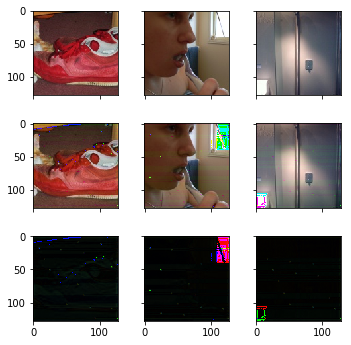


Epoch :  160 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0784936	 | Time     : 263.896534 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |
Encoder   | Loss  :  0.0021726	 | Accuracy :  0.7804064 |
Decoder   | Loss  :  0.0610304	 | Accuracy :  0.9093634 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0646456	 | Time     :  20.148885 |
Encoder   | Loss  :  0.0022424	 | Accuracy :  0.7983335 |
Decoder   | Loss  :  0.0630759	 | Accuracy :  0.9024263 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


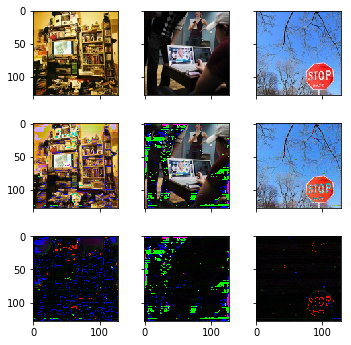


Epoch :  161 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0777644	 | Time     : 264.842213 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0001251 |
Encoder   | Loss  :  0.0020817	 | Accuracy :  0.7827416 |
Decoder   | Loss  :  0.0603648	 | Accuracy :  0.9093719 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0616066	 | Time     :  20.111746 |
Encoder   | Loss  :  0.0013845	 | Accuracy :  0.8192766 |
Decoder   | Loss  :  0.0606374	 | Accuracy :  0.9024265 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


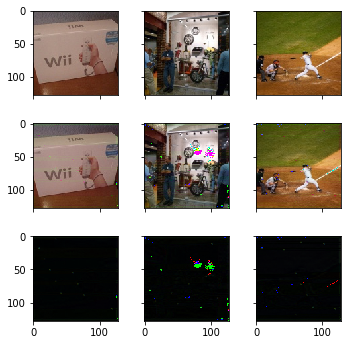


Epoch :  162 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0770659	 | Time     : 263.748411 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0001251 |
Encoder   | Loss  :  0.0021152	 | Accuracy :  0.7840191 |
Decoder   | Loss  :  0.0596429	 | Accuracy :  0.9091925 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1309996	 | Time     :  20.000441 |
Encoder   | Loss  :  0.0248647	 | Accuracy :  0.7753274 |
Decoder   | Loss  :  0.1135942	 | Accuracy :  0.8995650 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


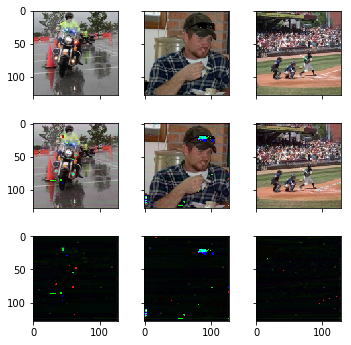


Epoch :  163 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0763311	 | Time     : 263.554011 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |
Encoder   | Loss  :  0.0020421	 | Accuracy :  0.7855104 |
Decoder   | Loss  :  0.0589593	 | Accuracy :  0.9096262 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0615267	 | Time     :  20.204835 |
Encoder   | Loss  :  0.0017349	 | Accuracy :  0.8026377 |
Decoder   | Loss  :  0.0603123	 | Accuracy :  0.9058568 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


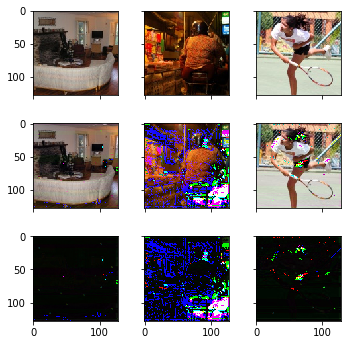


Epoch :  164 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0764201	 | Time     : 268.304837 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0001251 |
Encoder   | Loss  :  0.0023362	 | Accuracy :  0.7834985 |
Decoder   | Loss  :  0.0588424	 | Accuracy :  0.9101142 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0614327	 | Time     :  20.022342 |
Encoder   | Loss  :  0.0017528	 | Accuracy :  0.8059590 |
Decoder   | Loss  :  0.0602057	 | Accuracy :  0.9064258 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0005020 |


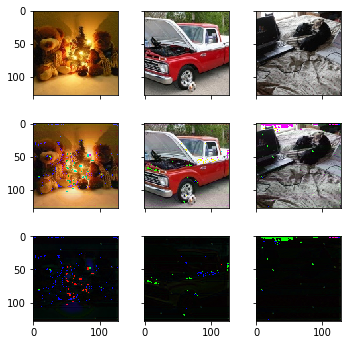


Epoch :  165 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0755082	 | Time     : 263.852849 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000626 |
Encoder   | Loss  :  0.0019911	 | Accuracy :  0.7919192 |
Decoder   | Loss  :  0.0581720	 | Accuracy :  0.9102186 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0732731	 | Time     :  20.248644 |
Encoder   | Loss  :  0.0105676	 | Accuracy :  0.7499767 |
Decoder   | Loss  :  0.0658758	 | Accuracy :  0.8999163 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


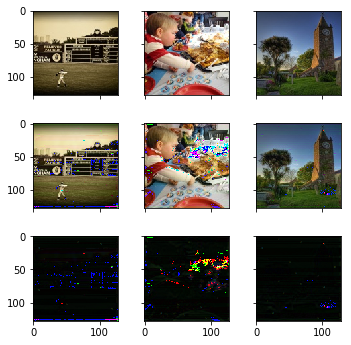


Epoch :  166 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0749790	 | Time     : 269.838802 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000626 |
Encoder   | Loss  :  0.0020260	 | Accuracy :  0.7919322 |
Decoder   | Loss  :  0.0576185	 | Accuracy :  0.9107983 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0647766	 | Time     :  20.341854 |
Encoder   | Loss  :  0.0061162	 | Accuracy :  0.8008409 |
Decoder   | Loss  :  0.0604952	 | Accuracy :  0.9038654 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


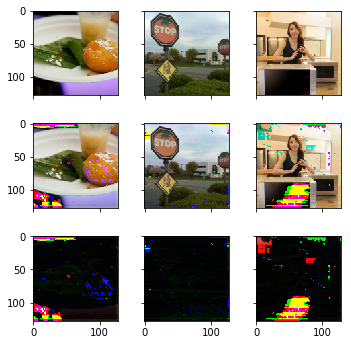


Epoch :  167 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0748696	 | Time     : 265.301565 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |
Encoder   | Loss  :  0.0021134	 | Accuracy :  0.7909183 |
Decoder   | Loss  :  0.0574478	 | Accuracy :  0.9100892 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0618162	 | Time     :  20.006075 |
Encoder   | Loss  :  0.0023148	 | Accuracy :  0.7873988 |
Decoder   | Loss  :  0.0601958	 | Accuracy :  0.9022590 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


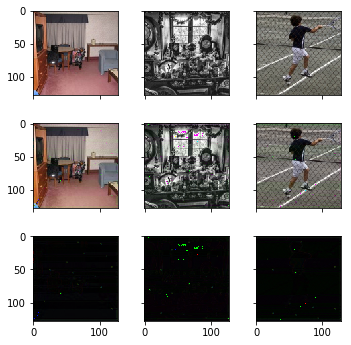


Epoch :  168 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0747545	 | Time     : 271.977045 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |
Encoder   | Loss  :  0.0019830	 | Accuracy :  0.7929647 |
Decoder   | Loss  :  0.0574239	 | Accuracy :  0.9103978 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0640253	 | Time     :  20.171640 |
Encoder   | Loss  :  0.0020888	 | Accuracy :  0.8031505 |
Decoder   | Loss  :  0.0625631	 | Accuracy :  0.9042504 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


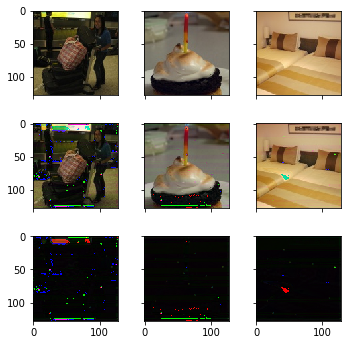


Epoch :  169 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0739503	 | Time     : 269.495519 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0001877 |
Encoder   | Loss  :  0.0019315	 | Accuracy :  0.7934354 |
Decoder   | Loss  :  0.0566559	 | Accuracy :  0.9109067 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0606981	 | Time     :  19.845032 |
Encoder   | Loss  :  0.0026406	 | Accuracy :  0.7719938 |
Decoder   | Loss  :  0.0588497	 | Accuracy :  0.9055891 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


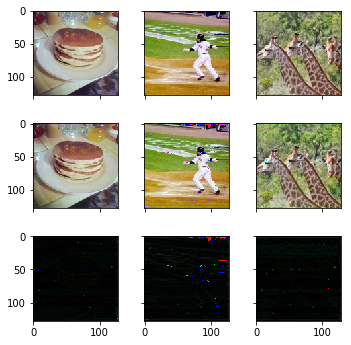


Epoch :  170 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0735214	 | Time     : 265.498518 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |
Encoder   | Loss  :  0.0019086	 | Accuracy :  0.7935769 |
Decoder   | Loss  :  0.0562430	 | Accuracy :  0.9118618 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0616652	 | Time     :  19.921838 |
Encoder   | Loss  :  0.0029515	 | Accuracy :  0.7921434 |
Decoder   | Loss  :  0.0595992	 | Accuracy :  0.9062919 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


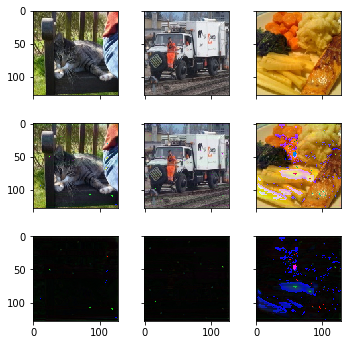


Epoch :  171 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0734092	 | Time     : 264.045130 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000626 |
Encoder   | Loss  :  0.0020680	 | Accuracy :  0.7966307 |
Decoder   | Loss  :  0.0560192	 | Accuracy :  0.9117201 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0609243	 | Time     :  20.141355 |
Encoder   | Loss  :  0.0023734	 | Accuracy :  0.7989200 |
Decoder   | Loss  :  0.0592629	 | Accuracy :  0.9041499 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


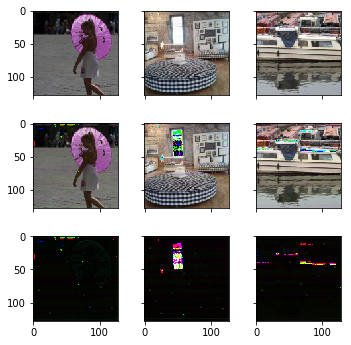


Epoch :  172 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0727675	 | Time     : 269.371765 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0001251 |
Encoder   | Loss  :  0.0018334	 | Accuracy :  0.7984024 |
Decoder   | Loss  :  0.0555418	 | Accuracy :  0.9118785 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0606533	 | Time     :  20.093019 |
Encoder   | Loss  :  0.0019251	 | Accuracy :  0.8278981 |
Decoder   | Loss  :  0.0593057	 | Accuracy :  0.9047692 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


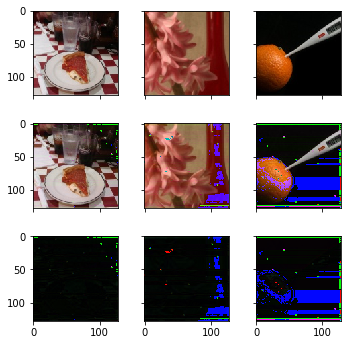


Epoch :  173 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0726030	 | Time     : 265.530129 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |
Encoder   | Loss  :  0.0018461	 | Accuracy :  0.7983299 |
Decoder   | Loss  :  0.0553684	 | Accuracy :  0.9120454 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0599554	 | Time     :  20.109136 |
Encoder   | Loss  :  0.0015490	 | Accuracy :  0.7944034 |
Decoder   | Loss  :  0.0588711	 | Accuracy :  0.9057731 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


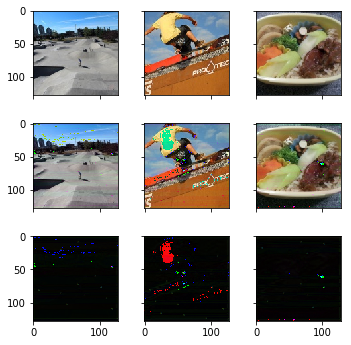


Epoch :  174 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0728534	 | Time     : 265.892062 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000626 |
Encoder   | Loss  :  0.0023137	 | Accuracy :  0.7905245 |
Decoder   | Loss  :  0.0552914	 | Accuracy :  0.9121496 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0641762	 | Time     :  20.135758 |
Encoder   | Loss  :  0.0057335	 | Accuracy :  0.7961527 |
Decoder   | Loss  :  0.0601628	 | Accuracy :  0.9036814 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


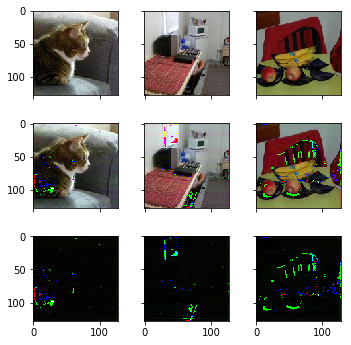


Epoch :  175 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0720727	 | Time     : 264.354319 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |
Encoder   | Loss  :  0.0019771	 | Accuracy :  0.7936350 |
Decoder   | Loss  :  0.0547464	 | Accuracy :  0.9131173 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0583363	 | Time     :  20.187754 |
Encoder   | Loss  :  0.0020822	 | Accuracy :  0.8156747 |
Decoder   | Loss  :  0.0568787	 | Accuracy :  0.9070280 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0005020 |


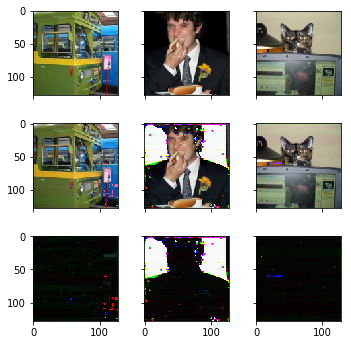


Epoch :  176 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0717924	 | Time     : 265.187463 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0001251 |
Encoder   | Loss  :  0.0019171	 | Accuracy :  0.7989418 |
Decoder   | Loss  :  0.0545081	 | Accuracy :  0.9132674 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0613156	 | Time     :  20.062375 |
Encoder   | Loss  :  0.0033979	 | Accuracy :  0.8369310 |
Decoder   | Loss  :  0.0589371	 | Accuracy :  0.9042838 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


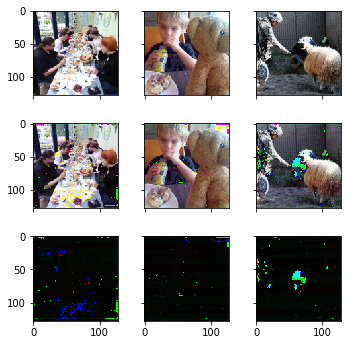


Epoch :  177 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0718419	 | Time     : 265.658788 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0001251 |
Encoder   | Loss  :  0.0019331	 | Accuracy :  0.7990751 |
Decoder   | Loss  :  0.0545464	 | Accuracy :  0.9136136 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0584735	 | Time     :  20.061231 |
Encoder   | Loss  :  0.0017502	 | Accuracy :  0.8172992 |
Decoder   | Loss  :  0.0572484	 | Accuracy :  0.9074297 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


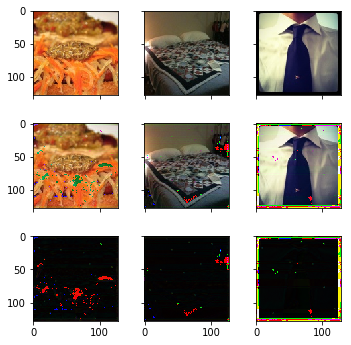


Epoch :  178 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0715803	 | Time     : 264.312518 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |
Encoder   | Loss  :  0.0019728	 | Accuracy :  0.7973911 |
Decoder   | Loss  :  0.0542570	 | Accuracy :  0.9138764 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0581067	 | Time     :  20.359746 |
Encoder   | Loss  :  0.0017338	 | Accuracy :  0.8330348 |
Decoder   | Loss  :  0.0568931	 | Accuracy :  0.9065930 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


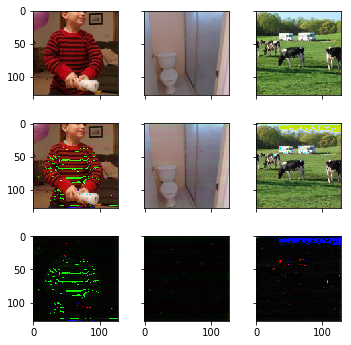


Epoch :  179 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0710310	 | Time     : 266.593423 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |
Encoder   | Loss  :  0.0018522	 | Accuracy :  0.7995426 |
Decoder   | Loss  :  0.0537921	 | Accuracy :  0.9142810 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0601839	 | Time     :  20.265607 |
Encoder   | Loss  :  0.0023384	 | Accuracy :  0.7699436 |
Decoder   | Loss  :  0.0585470	 | Accuracy :  0.9049196 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


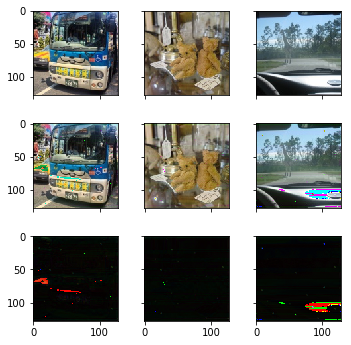


Epoch :  180 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0709795	 | Time     : 265.750000 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000626 |
Encoder   | Loss  :  0.0017901	 | Accuracy :  0.8033345 |
Decoder   | Loss  :  0.0537840	 | Accuracy :  0.9146563 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0597614	 | Time     :  20.015119 |
Encoder   | Loss  :  0.0020674	 | Accuracy :  0.7813329 |
Decoder   | Loss  :  0.0583142	 | Accuracy :  0.9051874 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


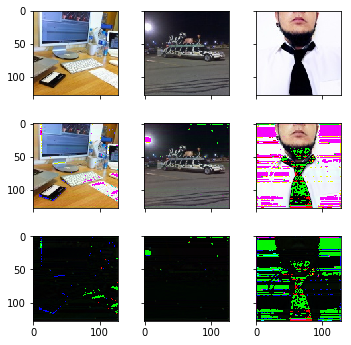


Epoch :  181 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0709288	 | Time     : 265.953220 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000626 |
Encoder   | Loss  :  0.0019803	 | Accuracy :  0.7988397 |
Decoder   | Loss  :  0.0536002	 | Accuracy :  0.9149858 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0581439	 | Time     :  19.703358 |
Encoder   | Loss  :  0.0015885	 | Accuracy :  0.8300802 |
Decoder   | Loss  :  0.0570319	 | Accuracy :  0.9070280 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0005020 |


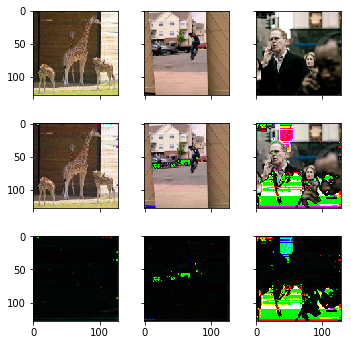


Epoch :  182 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0705275	 | Time     : 265.749514 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000626 |
Encoder   | Loss  :  0.0019004	 | Accuracy :  0.7989997 |
Decoder   | Loss  :  0.0532548	 | Accuracy :  0.9156573 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0712628	 | Time     :  19.938990 |
Encoder   | Loss  :  0.0123032	 | Accuracy :  0.7904319 |
Decoder   | Loss  :  0.0626506	 | Accuracy :  0.9008366 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


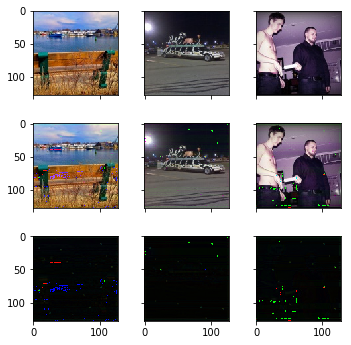


Epoch :  183 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0700256	 | Time     : 265.202916 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0003754 |
Encoder   | Loss  :  0.0017742	 | Accuracy :  0.8002833 |
Decoder   | Loss  :  0.0528413	 | Accuracy :  0.9163580 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0584716	 | Time     :  20.031421 |
Encoder   | Loss  :  0.0022507	 | Accuracy :  0.7554482 |
Decoder   | Loss  :  0.0568962	 | Accuracy :  0.9067771 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


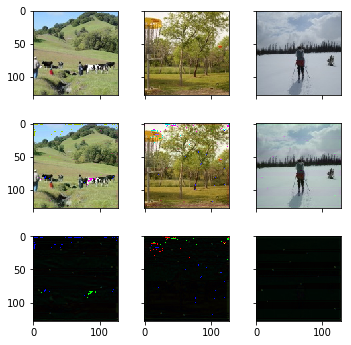


Epoch :  184 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0699303	 | Time     : 265.265288 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0001251 |
Encoder   | Loss  :  0.0017297	 | Accuracy :  0.7998270 |
Decoder   | Loss  :  0.0527771	 | Accuracy :  0.9166625 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0593729	 | Time     :  20.202999 |
Encoder   | Loss  :  0.0040081	 | Accuracy :  0.8114812 |
Decoder   | Loss  :  0.0565672	 | Accuracy :  0.9079151 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


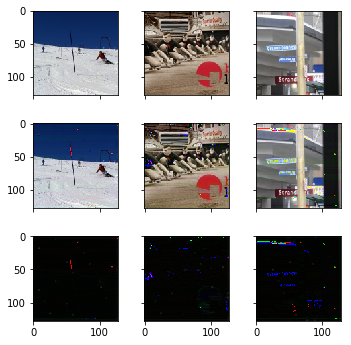


Epoch :  185 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0702478	 | Time     : 265.360846 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |
Encoder   | Loss  :  0.0023307	 | Accuracy :  0.7972816 |
Decoder   | Loss  :  0.0526740	 | Accuracy :  0.9165832 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0583429	 | Time     :  19.967335 |
Encoder   | Loss  :  0.0014418	 | Accuracy :  0.8276579 |
Decoder   | Loss  :  0.0573337	 | Accuracy :  0.9060409 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


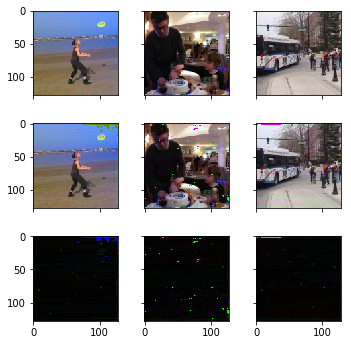


Epoch :  186 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0698339	 | Time     : 264.627320 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0001251 |
Encoder   | Loss  :  0.0020220	 | Accuracy :  0.7984071 |
Decoder   | Loss  :  0.0524761	 | Accuracy :  0.9175384 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0602634	 | Time     :  20.222658 |
Encoder   | Loss  :  0.0021834	 | Accuracy :  0.8141224 |
Decoder   | Loss  :  0.0587350	 | Accuracy :  0.9051707 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


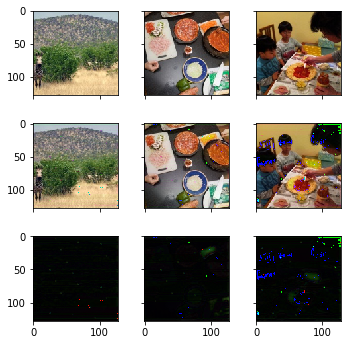


Epoch :  187 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0695670	 | Time     : 272.194929 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0005631 |
Encoder   | Loss  :  0.0017462	 | Accuracy :  0.8055446 |
Decoder   | Loss  :  0.0524023	 | Accuracy :  0.9178637 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0581831	 | Time     :  19.492937 |
Encoder   | Loss  :  0.0014007	 | Accuracy :  0.8386846 |
Decoder   | Loss  :  0.0572026	 | Accuracy :  0.9103581 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


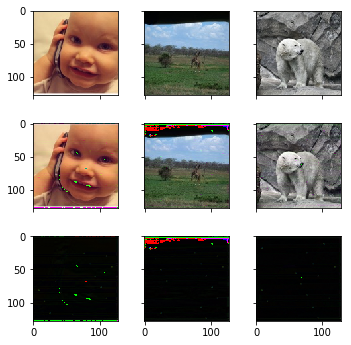


Epoch :  188 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0692385	 | Time     : 273.900867 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0006882 |
Encoder   | Loss  :  0.0018135	 | Accuracy :  0.8029589 |
Decoder   | Loss  :  0.0520267	 | Accuracy :  0.9184476 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0598216	 | Time     :  19.868358 |
Encoder   | Loss  :  0.0020316	 | Accuracy :  0.7924920 |
Decoder   | Loss  :  0.0583995	 | Accuracy :  0.9067269 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


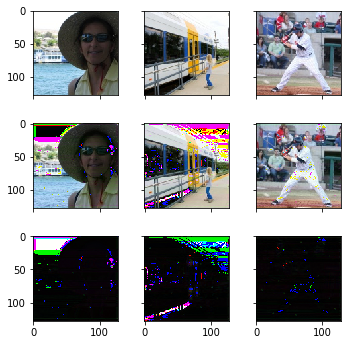


Epoch :  189 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0690912	 | Time     : 275.055544 |
Adversary | Loss  :  0.0002484	 | Accuracy :  0.0060686 |
Encoder   | Loss  :  0.0018089	 | Accuracy :  0.8029986 |
Decoder   | Loss  :  0.0518860	 | Accuracy :  0.9182391 |
Adversary | Loss  : 15.9389133	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0590081	 | Time     :  19.724508 |
Encoder   | Loss  :  0.0020616	 | Accuracy :  0.8402874 |
Decoder   | Loss  :  0.0575650	 | Accuracy :  0.9062583 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


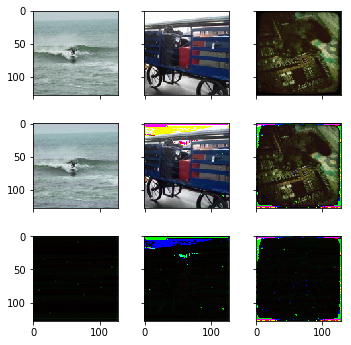


Epoch :  190 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0688012	 | Time     : 273.362145 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |
Encoder   | Loss  :  0.0018727	 | Accuracy :  0.7986319 |
Decoder   | Loss  :  0.0515480	 | Accuracy :  0.9196739 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0581197	 | Time     :  20.101493 |
Encoder   | Loss  :  0.0016488	 | Accuracy :  0.8064076 |
Decoder   | Loss  :  0.0569655	 | Accuracy :  0.9071453 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


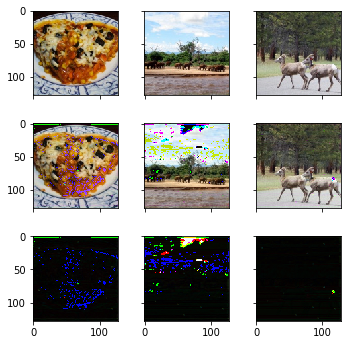


Epoch :  191 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0686512	 | Time     : 271.008288 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |
Encoder   | Loss  :  0.0018432	 | Accuracy :  0.8018420 |
Decoder   | Loss  :  0.0514185	 | Accuracy :  0.9199783 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0697470	 | Time     :  19.833714 |
Encoder   | Loss  :  0.0113269	 | Accuracy :  0.8024782 |
Decoder   | Loss  :  0.0618181	 | Accuracy :  0.9044176 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


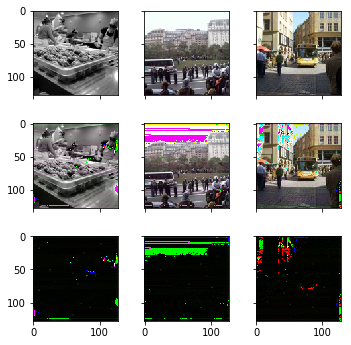


Epoch :  192 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0684097	 | Time     : 270.129882 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |
Encoder   | Loss  :  0.0018025	 | Accuracy :  0.8054724 |
Decoder   | Loss  :  0.0512056	 | Accuracy :  0.9203619 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0631988	 | Time     :  20.043715 |
Encoder   | Loss  :  0.0036765	 | Accuracy :  0.7780775 |
Decoder   | Loss  :  0.0606253	 | Accuracy :  0.9079818 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


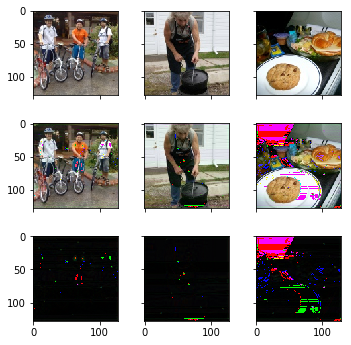


Epoch :  193 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0684729	 | Time     : 270.954969 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |
Encoder   | Loss  :  0.0019483	 | Accuracy :  0.8002336 |
Decoder   | Loss  :  0.0511666	 | Accuracy :  0.9201952 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0603799	 | Time     :  19.910633 |
Encoder   | Loss  :  0.0045058	 | Accuracy :  0.8150706 |
Decoder   | Loss  :  0.0572259	 | Accuracy :  0.9065094 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


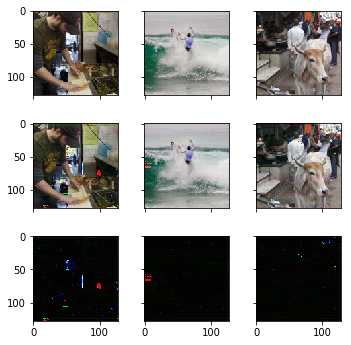


Epoch :  194 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0678391	 | Time     : 271.228213 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |
Encoder   | Loss  :  0.0018392	 | Accuracy :  0.7994937 |
Decoder   | Loss  :  0.0506092	 | Accuracy :  0.9214464 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0567707	 | Time     :  19.939670 |
Encoder   | Loss  :  0.0011809	 | Accuracy :  0.8115875 |
Decoder   | Loss  :  0.0559440	 | Accuracy :  0.9089023 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


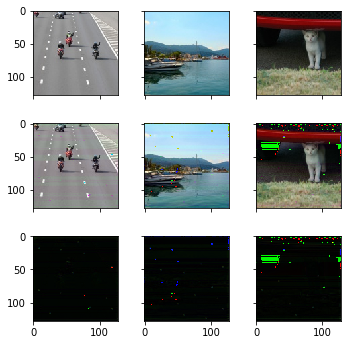


Epoch :  195 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0676719	 | Time     : 270.297474 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |
Encoder   | Loss  :  0.0017624	 | Accuracy :  0.8020898 |
Decoder   | Loss  :  0.0504959	 | Accuracy :  0.9219720 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0693301	 | Time     :  19.962603 |
Encoder   | Loss  :  0.0149133	 | Accuracy :  0.8334432 |
Decoder   | Loss  :  0.0588908	 | Accuracy :  0.9056895 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


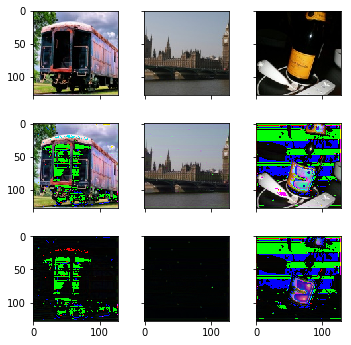


Epoch :  196 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0674400	 | Time     : 269.993945 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |
Encoder   | Loss  :  0.0017042	 | Accuracy :  0.8050251 |
Decoder   | Loss  :  0.0503047	 | Accuracy :  0.9222515 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0576125	 | Time     :  19.639790 |
Encoder   | Loss  :  0.0020971	 | Accuracy :  0.8140048 |
Decoder   | Loss  :  0.0561446	 | Accuracy :  0.9100903 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


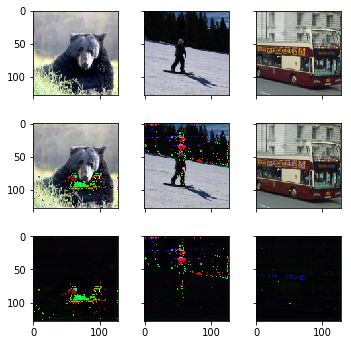


Epoch :  197 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0671486	 | Time     : 270.124084 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |
Encoder   | Loss  :  0.0017736	 | Accuracy :  0.8049122 |
Decoder   | Loss  :  0.0499647	 | Accuracy :  0.9225933 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0587818	 | Time     :  19.733734 |
Encoder   | Loss  :  0.0021837	 | Accuracy :  0.8003521 |
Decoder   | Loss  :  0.0572532	 | Accuracy :  0.9082664 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


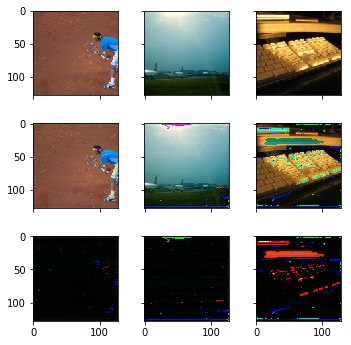


Epoch :  198 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0667710	 | Time     : 270.666631 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |
Encoder   | Loss  :  0.0016973	 | Accuracy :  0.8063666 |
Decoder   | Loss  :  0.0496405	 | Accuracy :  0.9239698 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0608499	 | Time     :  19.932563 |
Encoder   | Loss  :  0.0037423	 | Accuracy :  0.8104157 |
Decoder   | Loss  :  0.0582303	 | Accuracy :  0.9072791 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


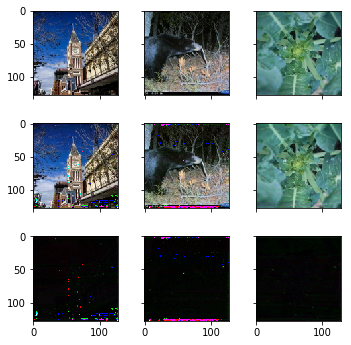


Epoch :  199 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0667324	 | Time     : 269.909865 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |
Encoder   | Loss  :  0.0018186	 | Accuracy :  0.8025146 |
Decoder   | Loss  :  0.0495170	 | Accuracy :  0.9237238 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0563730	 | Time     :  19.845669 |
Encoder   | Loss  :  0.0012575	 | Accuracy :  0.7833450 |
Decoder   | Loss  :  0.0554927	 | Accuracy :  0.9118139 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


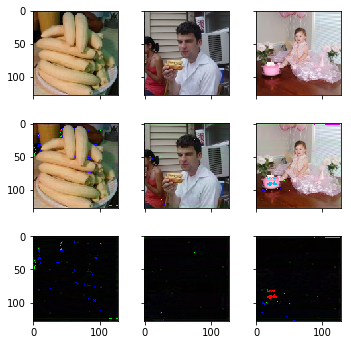


Epoch :  200 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0663703	 | Time     : 271.055198 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |
Encoder   | Loss  :  0.0017286	 | Accuracy :  0.8043448 |
Decoder   | Loss  :  0.0492179	 | Accuracy :  0.9246246 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0578336	 | Time     :  19.746669 |
Encoder   | Loss  :  0.0016876	 | Accuracy :  0.8271999 |
Decoder   | Loss  :  0.0566523	 | Accuracy :  0.9086848 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


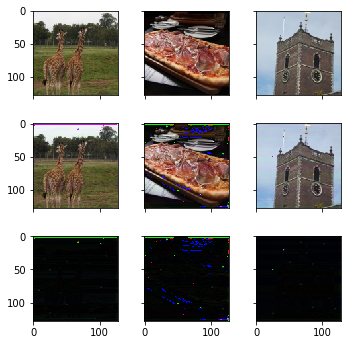

In [15]:
print('Training Complete Network')

loss, acc = [[], [], [], [], [], [], []], [[], [], [], [], [], []]
vloss, vacc = [[], [], [], [], [], [], []], [[], [], [], [], [], []]
advla = [[], []]

for epoch in range(n_epochs):
    print('\nEpoch : ', epoch+1, '/', n_epochs, '\t\t\t', '[', end='')
    batchscore = []
    adv_r, adv_f = [], []

    # Shuffle Data after each Epoch
    train_list, message_train = shuffle(train_list, message_train)
    
    tstartt = time.time()
    for nbatch in range(int(tbatches)):
        if nbatch%12 == 0:
            print('#', end='')
        
        # Generate Images
        r1, r2, r3 = DataGenerator(train_list, train_folder, message_train, nbatch)
        
        # Generate Encoder Images
        fake_images = encoder.predict([r1, r2])    
        
        adversary.trainable = True
        # Train Adversary on Real Images
        y_gen = np.zeros((np.int64(batch_size), 1))
        adv_r.append(adversary.train_on_batch(r1, y_gen))
        # Train Adversary on Fake Images
        y_gen = np.ones((np.int64(batch_size), 1))
        adv_f.append(adversary.train_on_batch(fake_images, y_gen))

        adversary.trainable = False
        # Train Combined
        # Original  - ones | Fool - zeros
        y_gen = np.zeros((np.int64(batch_size), 1))
        batchscore.append(combined.train_on_batch([r1, r2], [r1, r3, y_gen]))
        
        del fake_images, r1, r2, r3, y_gen
    print('|', end='')
    tendt = time.time()
    
    vstartt = time.time()
    vbatchscore = []
    for nbatch in range(int(vbatches)):
        if nbatch%12 == 0:
            print('#', end='')
        v1, v2, v3 = DataGenerator(validate_list, validate_folder, message_validate, nbatch)
        y_gen = np.ones((np.int64(batch_size), 1))
        vbatchscore.append(combined.test_on_batch([v1, v2], [v1, v3, y_gen]))
    vendt = time.time()
    print(']')
    
    # Calculating Metrics
    loss, acc, vloss, vacc, advla = calc_metric(loss, acc, vloss, vacc, advla, adv_r, adv_f, batchscore, vbatchscore)
    print_metric(loss, acc, vloss, vacc, advla, epoch, tendt-tstartt, vendt - vstartt)
    del batchscore, vbatchscore
    
    # Save Complete Model
    encoder.save('{:}complete-encoder-mse-{:02d}-{:1d}-{:03d}.h5'.format(modelpath, L, 2, epoch))
    decoder.save('{:}complete-decoder-mse-{:02d}-{:1d}-{:03d}.h5'.format(modelpath, L, 2, epoch))
    adversary.save('{:}complete-adversary-mse-{:02d}-{:1d}-{:03d}.h5'.format(modelpath, L, 2, epoch))
    
    # Print Images
    p1, p2, _ = DataGenerator(train_list, train_folder, message_train, 0, 3)
    out_img = encoder.predict([p1, p2])
    
    fig, ax = plt.subplots(3, 3, sharex='col', sharey='row', figsize=(5, 5))
    plt.tight_layout()
    for j in range(3):
        ax[0, j].imshow(cv2.cvtColor(arr_img(p1[j]), cv2.COLOR_BGR2RGB))
        ax[1, j].imshow(cv2.cvtColor(arr_img(out_img[j]), cv2.COLOR_BGR2RGB))
        diff1 = cv2.subtract(arr_img(out_img[j]), arr_img(p1[j]))
        diff2 = cv2.subtract(arr_img(p1[j]), arr_img(out_img[j]))
        ax[2, j].imshow(cv2.cvtColor(diff1+diff2, cv2.COLOR_BGR2RGB), cmap='gray')
        ax[0, j].autoscale(False)
        ax[1, j].autoscale(False)
        ax[2, j].autoscale(False)
    plt.show()
    
    del out_img, p1, p2

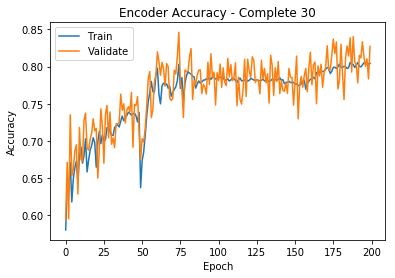

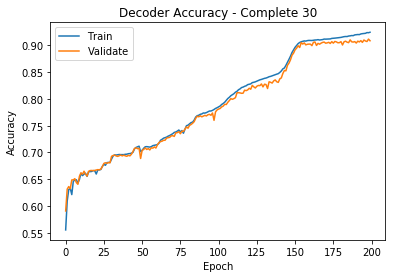

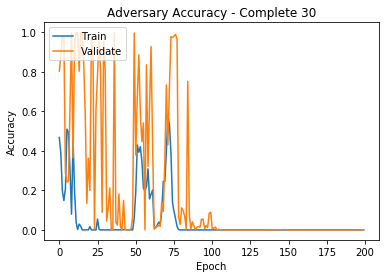

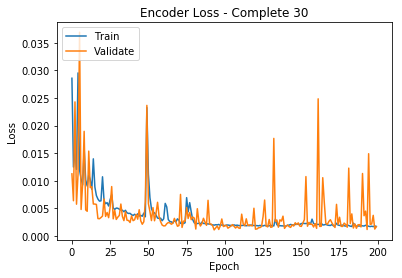

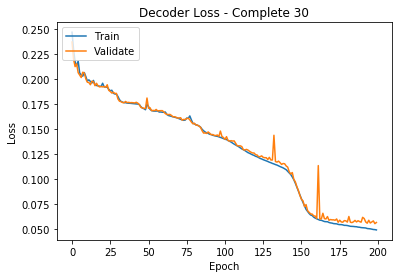

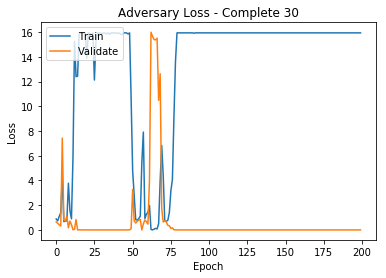

In [16]:
# Plot Encoder Accuracy
plt.plot(acc[0])
plt.plot(vacc[0])
plt.title('Encoder Accuracy - Complete ' + str(L))
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validate'], loc='upper left')
plt.savefig(modelpath + 'complete-mse-' + str(L) + '-2-enc-acc.png', dpi=300, pad_inches=0.1)
plt.show()

# Plot Decoder Accuracy
plt.plot(acc[1])
plt.plot(vacc[1])
plt.title('Decoder Accuracy - Complete ' + str(L))
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validate'], loc='upper left')
plt.savefig(modelpath + 'complete-mse-' + str(L) + '-2-dec-acc.png', dpi=300, pad_inches=0.1)
plt.show()

# Plot Adversary Accuracy
plt.plot(acc[2])
plt.plot(vacc[2])
plt.title('Adversary Accuracy - Complete ' + str(L))
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validate'], loc='upper left')
plt.savefig(modelpath + 'complete-mse-' + str(L) + '-2-adv-acc.png', dpi=300, pad_inches=0.1)
plt.show()

# Plot Encoder Loss
plt.plot(loss[1])
plt.plot(vloss[1])
plt.title('Encoder Loss - Complete ' + str(L))
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validate'], loc='upper left')
plt.savefig(modelpath + 'complete-mse-' + str(L) + '-2-enc-loss.png', dpi=300, pad_inches=0.1)
plt.show()

# Plot Decoder Loss
plt.plot(loss[2])
plt.plot(vloss[2])
plt.title('Decoder Loss - Complete ' + str(L))
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validate'], loc='upper left')
plt.savefig(modelpath + 'complete-mse-' + str(L) + '-2-dec-loss.png', dpi=300, pad_inches=0.1)
plt.show()

# Plot Adversary Loss
plt.plot(loss[3])
plt.plot(vloss[3])
plt.title('Adversary Loss - Complete ' + str(L))
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validate'], loc='upper left')
plt.savefig(modelpath + 'complete-mse-' + str(L) + '-2-adv-loss.png', dpi=300, pad_inches=0.1)
plt.show()

In [17]:
columns = ['Loss', 'vLoss', 'ELoss', 'vELoss', 'DLoss', 'vDLoss', 'ALoss', 'vALoss', 'AdLoss',
          'EAcc', 'vEAcc', 'DAcc', 'vDAcc', 'AAcc', 'vAAcc', 'AdAcc']
df = pd.DataFrame(columns=columns)

In [18]:
df['Loss'] = loss[0]
df['ELoss'] = loss[1]
df['DLoss'] = loss[2]
df['ALoss'] = loss[3]

df['vLoss'] = vloss[0]
df['vELoss'] = vloss[1]
df['vDLoss'] = vloss[2]
df['vALoss'] = vloss[3]

df['EAcc'] = acc[0]
df['DAcc'] = acc[1]
df['AAcc'] = acc[2]

df['vEAcc'] = vacc[0]
df['vDAcc'] = vacc[1]
df['vAAcc'] = vacc[2]

df['AdLoss'] = advla[0]
df['AdAcc'] = advla[1]

df

,Loss,vLoss,ELoss,vELoss,DLoss,vDLoss,ALoss,vALoss,AdLoss,EAcc,vEAcc,DAcc,vDAcc,AAcc,vAAcc,AdAcc
0,0.267938,0.245785,0.028592,0.011265,0.247040,0.237252,0.883346,6.472341e-01,1.777945e+00,0.580105,0.593298,0.555134,0.590546,0.467467,0.803715,0.452515
1,0.238963,0.225194,0.012498,0.006391,0.229480,0.220178,0.733891,5.416865e-01,6.708256e-01,0.638376,0.671052,0.609038,0.631325,0.388639,0.879518,0.597723
2,0.229072,0.230063,0.015130,0.024308,0.217385,0.212639,1.096182,4.079648e-01,6.238195e-01,0.632452,0.594901,0.630447,0.636161,0.196697,0.977912,0.758884
3,0.223370,0.219868,0.012070,0.005766,0.213537,0.215511,1.384328,3.206205e-01,5.625376e-01,0.670489,0.735090,0.632774,0.632162,0.148899,0.976406,0.780093
4,0.243272,0.221873,0.029559,0.011219,0.218245,0.206592,4.335332,7.428083e+00,2.555599e+00,0.617735,0.652689,0.621159,0.648594,0.209334,0.286647,0.632508
5,0.215330,0.230928,0.011935,0.036932,0.206302,0.204265,0.673202,8.105522e-01,1.106292e+00,0.649064,0.662540,0.646242,0.648678,0.510260,0.241968,0.483984
6,0.212200,0.205826,0.010354,0.004810,0.204256,0.201746,0.696533,7.134197e-01,6.915189e-01,0.663568,0.686171,0.648052,0.650937,0.492367,0.247992,0.519332
7,0.210250,0.214709,0.009245,0.009375,0.203034,0.207033,0.744596,1.113444e+00,6.611270e-01,0.672919,0.694656,0.648849,0.643541,0.301552,0.627008,0.656969
8,0.221550,0.219674,0.015814,0.018970,0.206701,0.206225,3.778851,1.703616e-01,4.156395e-01,0.643076,0.628270,0.642718,0.640395,0.079454,0.996988,0.852227
9,0.211469,0.204501,0.010161,0.004726,0.202791,0.200473,1.565474,7.187440e-01,1.032767e+00,0.679844,0.718025,0.649445,0.655405,0.460085,0.364458,0.565878


In [19]:
# Write to CSV
print('Writing to CSV', end='')
df.to_csv('{:}complete-mse-{:02d}-{:1d}.csv'.format(modelpath, L, 2))
print(' - Done')

Writing to CSV - Done


In [20]:
# Find the Best Accuracy of Models
print('Maximum Validation Accuracy - ')
e_max, d_max, a_max = 0, 0, 0
e_min, d_min, a_min = 0, 0, 0

def find_best_acc(alist, llist):
    maxacc, minloss = 0.0, 10.0
    maxindex, minindex = 0, 0
    for i in range(len(alist)):
        if alist[i]>=maxacc:
            maxacc = alist[i]
            maxindex = i
        if llist[i]<=minloss:
            minloss = llist[i]
            minindex = i
    return [maxacc, maxindex], [minloss, minindex]
    
# Encoder
[maxacc, e_max], [minloss, e_min] = find_best_acc(vacc[0], vloss[1])
print('Encoder   : {:10.7f} | Index : {}'.format(maxacc, e_max))
print('Encoder   : {:10.7f} | Index : {}'.format(minloss, e_min))

# Decoder
[maxacc, d_max], [minloss, d_min] = find_best_acc(vacc[1], vloss[2])
print('Decoder   : {:10.7f} | Index : {}'.format(maxacc, d_max))
print('Decoder   : {:10.7f} | Index : {}'.format(minloss, d_min))

# Adversary
[maxacc, a_max], [minloss, a_min] = find_best_acc(vacc[2], vloss[3])
print('Adversary : {:10.7f} | Index : {}'.format(maxacc, a_max))
print('Adversary : {:10.7f} | Index : {}'.format(minloss, a_min))

Maximum Validation Accuracy - 
Encoder   :  0.8461482 | Index : 74
Encoder   :  0.0011021 | Index : 93
Decoder   :  0.9118139 | Index : 198
Decoder   :  0.0554927 | Index : 198
Adversary :  1.0000000 | Index : 15
Adversary :  0.0000001 | Index : 199


In [19]:
# Load Best Model
print('Loading Best Model', end='')

bemodel = 'complete-encoder-mse-{:02d}-{:1d}-{:03d}'.format(L, 2, 199)
bdmodel = 'complete-decoder-mse-{:02d}-{:1d}-{:03d}'.format(L, 2, 199)
bamodel = 'complete-adversary-mse-{:02d}-{:1d}-{:03d}'.format(L, 2, 199)

l_emodel = load_model(modelpath + bemodel + '.h5')
l_emodel.load_weights(modelpath + bemodel + '.h5')
l_emodel.save(modelpath + bemodel + '.hdf5')
l_emodel = load_model(modelpath + bemodel + '.hdf5')

l_dmodel = load_model(modelpath + bdmodel + '.h5')
l_dmodel.load_weights(modelpath + bdmodel + '.h5')
l_dmodel.save(modelpath + bdmodel + '.hdf5')
l_dmodel = load_model(modelpath + bdmodel + '.hdf5')

l_amodel = load_model(modelpath + bamodel + '.h5')
l_amodel.load_weights(modelpath + bamodel + '.h5')
l_amodel.save(modelpath + bamodel + '.hdf5')
l_amodel = load_model(modelpath + bamodel + '.hdf5')

l_model = build_combined(l_emodel, l_dmodel, l_amodel)
print(' - Done')

Loading Best Model - Done


In [20]:
def calc_metric(loss, acc, history):
    avgl_e, avgl_d, avgl_a = [], [], []
    avga_e, avga_d, avga_a = [], [], []
    avgl = []

    for hist in history:
        avgl.append(hist[0])
        avgl_e.append(hist[1])
        avgl_d.append(hist[2])
        avgl_a.append(hist[3])
        avga_e.append(hist[4])
        avga_d.append(hist[7])
        avga_a.append(hist[8])

    loss[0].append(np.mean(avgl))
    loss[1].append(np.mean(avgl_e))
    loss[2].append(np.mean(avgl_d))
    loss[3].append(np.mean(avgl_a))
    acc[0].append(np.mean(avga_e))
    acc[1].append(np.mean(avga_d))
    acc[2].append(np.mean(avga_a))
    
    return loss, acc

In [21]:
t1loss, t1acc = [[], [], [], [], [], [], []], [[], [], [], [], [], []]
t2loss, t2acc = [[], [], [], [], [], [], []], [[], [], [], [], [], []]

ttbatches = len(test_list)/batch_size
fscore, lscore = [], []

print('Testing Models - [', end='')
for nbatch in range(int(ttbatches)):
    if nbatch%12 == 0:
        print('#', end='')

    t1, t2, t3 = DataGenerator(test_list, test_folder, message_test, nbatch)
    y_gen = np.ones((np.int64(batch_size), 1))
    
    fscore.append(combined.test_on_batch([t1, t2], [t1, t3, y_gen]))
    lscore.append(l_model.test_on_batch([t1, t2], [t1, t3, y_gen]))    
print('] - Done')

t1loss, t1acc = calc_metric(t1loss, t1acc, fscore)
t2loss, t2acc = calc_metric(t2loss, t2acc, lscore)

print()
print('Accuracy  |    Final   |     Best   |')
print('-'*9, '+', '-'*10, '+', '-'*10, '|')
print('Encoder   | {:10.8f} | {:10.8f} |'.format(np.mean(t1acc[0]), np.mean(t2acc[0])))
print('Decoder   | {:10.8f} | {:10.8f} |'.format(np.mean(t1acc[1]), np.mean(t2acc[1])))
print('Adversary | {:10.8f} | {:10.8f} |'.format(np.mean(t1acc[2]), np.mean(t2acc[2])))

Testing Models - [#######] - Done

Accuracy  |    Final   |     Best   |
--------- + ---------- + ---------- |
Encoder   | 0.32182172 | 0.82441682 |
Decoder   | 0.50177377 | 0.90906954 |
Adversary | 0.00000000 | 0.00000000 |


In [22]:
# Save Images
def save_images(dfolder, rfolder, file_list, messages, bmodel):
    print('[', end='')
    for index in range(len(test_list)//batch_size):
        if index%12 == 0:
            print('#', end='')
        file_list_temp = file_list[index*batch_size : (index+1)*batch_size]
        message_temp = messages[index*batch_size : (index+1)*batch_size]

        images = []
        batch_msg = []
        for i, ID in enumerate(file_list_temp):        
            img = cv2.imread(rfolder + ID, -1)
            img = img.reshape([H, W, C])
            images.append((np.array(img, dtype='float32')-127.5)/127.5)
            
            msg = gen_msg_plates(message_temp[i])
            batch_msg.append(msg)
        
        output, _, _ = bmodel.predict([np.array(images), np.array(batch_msg)])
        
        for i in range(len(output)):
            cv2.imwrite(dfolder + file_list_temp[i], arr_img(output[i]))
    print(']', end='')

In [23]:
# Save Test
# if np.mean(t1acc[0])>np.mean(t2acc[0]):
#     bmodel = combined
# else:
#     bmodel = l_model
bmodel = l_model
print('Saving Encoded Test Images - ', end='')
save_images('dataset128/complete-gan-mse-{:02d}-{:1d}/test/'.format(L, 2), test_folder, test_list, message_test, bmodel)
print(' - Done')
print('Saving Encoded Validate Images - ', end='')
save_images('dataset128/complete-gan-mse-{:02d}-{:1d}/validate/'.format(L, 2), validate_folder, validate_list, message_validate, bmodel)
print(' - Done')
print('Saving Encoded Train Images - ', end='')
save_images('dataset128/complete-gan-mse-{:02d}-{:1d}/train/'.format(L, 2), train_folder, train_list, message_train, bmodel)
print(' - Done')

Saving Encoded Test Images - [#######] - Done
Saving Encoded Validate Images - [#######] - Done
Saving Encoded Train Images - [#######] - Done
